# Installation

## CLIP

In [ ]:
import subprocess

CUDA_version = [s for s in subprocess.check_output(["nvcc", "--version"]).decode("UTF-8").split(", ") if s.startswith("release")][0].split(" ")[-1]
print("CUDA version:", CUDA_version)

if CUDA_version == "10.0":
    torch_version_suffix = "+cu100"
elif CUDA_version == "10.1":
    torch_version_suffix = "+cu101"
elif CUDA_version == "10.2":
    torch_version_suffix = ""
else:
    torch_version_suffix = "+cu110"

CUDA version: 11.0


In [ ]:
! pip install torch==1.7.1{torch_version_suffix} torchvision==0.8.2{torch_version_suffix} -f https://download.pytorch.org/whl/torch_stable.html ftfy regex

Looking in links: https://download.pytorch.org/whl/torch_stable.html
     |███████████████████████         | 834.1MB 1.3MB/s eta 0:04:05tcmalloc: large alloc 1147494400 bytes == 0x561139190000 @  0x7f5da0978615 0x5611007f6cdc 0x5611008d652a 0x5611007f9afd 0x5611008eafed 0x56110086d988 0x5611008684ae 0x5611007fb3ea 0x56110086d7f0 0x5611008684ae 0x5611007fb3ea 0x56110086a32a 0x5611008ebe36 0x561100869853 0x5611008ebe36 0x561100869853 0x5611008ebe36 0x561100869853 0x5611008ebe36 0x56110096e3e1 0x5611008ce6a9 0x561100839cc4 0x5611007fa559 0x56110086e4f8 0x5611007fb30a 0x5611008693b5 0x5611008687ad 0x5611007fb3ea 0x5611008693b5 0x5611007fb30a 0x5611008693b5
     |█████████████████████████████▏  | 1055.7MB 1.2MB/s eta 0:01:25tcmalloc: large alloc 1434370048 bytes == 0x56117d7e6000 @  0x7f5da0978615 0x5611007f6cdc 0x5611008d652a 0x5611007f9afd 0x5611008eafed 0x56110086d988 0x5611008684ae 0x5611007fb3ea 0x56110086d7f0 0x5611008684ae 0x5611007fb3ea 0x56110086a32a 0x5611008ebe36 0x561100869853 0

In [ ]:
!pip install --quiet git+https://github.com/Sri-vatsa/CLIP.git

## Text Preprocessing


In [ ]:
! pip install ftfy regex
! wget https://openaipublic.azureedge.net/clip/bpe_simple_vocab_16e6.txt.gz -O bpe_simple_vocab_16e6.txt.gz

--2021-06-08 16:32:40--  https://openaipublic.azureedge.net/clip/bpe_simple_vocab_16e6.txt.gz
Resolving openaipublic.azureedge.net (openaipublic.azureedge.net)... 13.107.253.71, 13.107.226.71, 2620:1ec:bdf::71, ...
Connecting to openaipublic.azureedge.net (openaipublic.azureedge.net)|13.107.253.71|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1356917 (1.3M) [application/octet-stream]
Saving to: ‘bpe_simple_vocab_16e6.txt.gz’

bpe_simple_vocab_16 100%[===================>]   1.29M  --.-KB/s    in 0.06s   

2021-06-08 16:32:40 (21.4 MB/s) - ‘bpe_simple_vocab_16e6.txt.gz’ saved [1356917/1356917]



In [ ]:
#@title

import gzip
import html
import os
from functools import lru_cache

import ftfy
import regex as re


@lru_cache()
def bytes_to_unicode():
    """
    Returns list of utf-8 byte and a corresponding list of unicode strings.
    The reversible bpe codes work on unicode strings.
    This means you need a large # of unicode characters in your vocab if you want to avoid UNKs.
    When you're at something like a 10B token dataset you end up needing around 5K for decent coverage.
    This is a signficant percentage of your normal, say, 32K bpe vocab.
    To avoid that, we want lookup tables between utf-8 bytes and unicode strings.
    And avoids mapping to whitespace/control characters the bpe code barfs on.
    """
    bs = list(range(ord("!"), ord("~")+1))+list(range(ord("¡"), ord("¬")+1))+list(range(ord("®"), ord("ÿ")+1))
    cs = bs[:]
    n = 0
    for b in range(2**8):
        if b not in bs:
            bs.append(b)
            cs.append(2**8+n)
            n += 1
    cs = [chr(n) for n in cs]
    return dict(zip(bs, cs))


def get_pairs(word):
    """Return set of symbol pairs in a word.
    Word is represented as tuple of symbols (symbols being variable-length strings).
    """
    pairs = set()
    prev_char = word[0]
    for char in word[1:]:
        pairs.add((prev_char, char))
        prev_char = char
    return pairs


def basic_clean(text):
    text = ftfy.fix_text(text)
    text = html.unescape(html.unescape(text))
    return text.strip()


def whitespace_clean(text):
    text = re.sub(r'\s+', ' ', text)
    text = text.strip()
    return text


class SimpleTokenizer(object):
    def __init__(self, bpe_path: str = "bpe_simple_vocab_16e6.txt.gz"):
        self.byte_encoder = bytes_to_unicode()
        self.byte_decoder = {v: k for k, v in self.byte_encoder.items()}
        merges = gzip.open(bpe_path).read().decode("utf-8").split('\n')
        merges = merges[1:49152-256-2+1]
        merges = [tuple(merge.split()) for merge in merges]
        vocab = list(bytes_to_unicode().values())
        vocab = vocab + [v+'</w>' for v in vocab]
        for merge in merges:
            vocab.append(''.join(merge))
        vocab.extend(['<|startoftext|>', '<|endoftext|>'])
        self.encoder = dict(zip(vocab, range(len(vocab))))
        self.decoder = {v: k for k, v in self.encoder.items()}
        self.bpe_ranks = dict(zip(merges, range(len(merges))))
        self.cache = {'<|startoftext|>': '<|startoftext|>', '<|endoftext|>': '<|endoftext|>'}
        self.pat = re.compile(r"""<\|startoftext\|>|<\|endoftext\|>|'s|'t|'re|'ve|'m|'ll|'d|[\p{L}]+|[\p{N}]|[^\s\p{L}\p{N}]+""", re.IGNORECASE)

    def bpe(self, token):
        if token in self.cache:
            return self.cache[token]
        word = tuple(token[:-1]) + ( token[-1] + '</w>',)
        pairs = get_pairs(word)

        if not pairs:
            return token+'</w>'

        while True:
            bigram = min(pairs, key = lambda pair: self.bpe_ranks.get(pair, float('inf')))
            if bigram not in self.bpe_ranks:
                break
            first, second = bigram
            new_word = []
            i = 0
            while i < len(word):
                try:
                    j = word.index(first, i)
                    new_word.extend(word[i:j])
                    i = j
                except:
                    new_word.extend(word[i:])
                    break

                if word[i] == first and i < len(word)-1 and word[i+1] == second:
                    new_word.append(first+second)
                    i += 2
                else:
                    new_word.append(word[i])
                    i += 1
            new_word = tuple(new_word)
            word = new_word
            if len(word) == 1:
                break
            else:
                pairs = get_pairs(word)
        word = ' '.join(word)
        self.cache[token] = word
        return word

    def encode(self, text):
        bpe_tokens = []
        text = whitespace_clean(basic_clean(text)).lower()
        for token in re.findall(self.pat, text):
            token = ''.join(self.byte_encoder[b] for b in token.encode('utf-8'))
            bpe_tokens.extend(self.encoder[bpe_token] for bpe_token in self.bpe(token).split(' '))
        return bpe_tokens

    def decode(self, tokens):
        text = ''.join([self.decoder[token] for token in tokens])
        text = bytearray([self.byte_decoder[c] for c in text]).decode('utf-8', errors="replace").replace('</w>', ' ')
        return text


## Atariari

In [ ]:
!rm -r atari_rl

rm: cannot remove 'atari_rl': No such file or directory


In [ ]:
!git clone https://github.com/Sri-vatsa/atari-representation-learning.git atari_rl

Cloning into 'atari_rl'...
remote: Enumerating objects: 3665, done.
remote: Counting objects: 100% (679/679), done.
remote: Compressing objects: 100% (370/370), done.
remote: Total 3665 (delta 432), reused 549 (delta 309), pack-reused 2986
Receiving objects: 100% (3665/3665), 6.36 MiB | 12.62 MiB/s, done.
Resolving deltas: 100% (2574/2574), done.


In [ ]:
%cd atari_rl
!pip install -r requirements.txt
%cd ..

/content/atari_rl
     |████████████████████████████████| 1.8MB 8.4MB/s 
     |████████████████████████████████| 102kB 14.1MB/s 
     |████████████████████████████████| 174kB 53.1MB/s 
     |████████████████████████████████| 133kB 54.9MB/s 
     |████████████████████████████████| 71kB 12.0MB/s 
  Created wheel for subprocess32: filename=subprocess32-3.5.4-cp37-none-any.whl size=6502 sha256=b98813b8844c847f01d2c59f04c05480b0e3cb61d66bfc0d71d24b1ac27f0611
  Stored in directory: /root/.cache/pip/wheels/68/39/1a/5e402bdfdf004af1786c8b853fd92f8c4a04f22aad179654d1
  Created wheel for pathtools: filename=pathtools-0.1.2-cp37-none-any.whl size=8807 sha256=401f1074a613732718bf5801c0aadeb7554c5755718c0f82098e434022fbb2fe
  Stored in directory: /root/.cache/pip/wheels/0b/04/79/c3b0c3a0266a3cb4376da31e5bfe8bba0c489246968a68e843
Successfully built subprocess32 pathtools
/content


In [ ]:
!pip install git+git://github.com/ankeshanand/pytorch-a2c-ppo-acktr-gail

  Cloning git://github.com/ankeshanand/pytorch-a2c-ppo-acktr-gail to /tmp/pip-req-build-0r9c7w5l
  Running command git clone -q git://github.com/ankeshanand/pytorch-a2c-ppo-acktr-gail /tmp/pip-req-build-0r9c7w5l
  Created wheel for a2c-ppo-acktr: filename=a2c_ppo_acktr-0.0.1-cp37-none-any.whl size=18832 sha256=16849030881826cbb7bf18fadadb1582e46929c0991551374ca7961f83c3b8b9
  Stored in directory: /tmp/pip-ephem-wheel-cache-6804sv1a/wheels/91/52/02/ec5c530fd76d56a66934ee91abbdae5240b766be1dc176deb7
Successfully built a2c-ppo-acktr


In [ ]:
!pip install git+git://github.com/mila-iqia/atari-representation-learning.git

  Cloning git://github.com/mila-iqia/atari-representation-learning.git to /tmp/pip-req-build-sqno2qwd
  Running command git clone -q git://github.com/mila-iqia/atari-representation-learning.git /tmp/pip-req-build-sqno2qwd
  Created wheel for atariari: filename=atariari-0.0.1-cp37-none-any.whl size=46727 sha256=01171355908a9814241f4c0af74335ce584ebe26c2e8f62023eb59455fc7094e
  Stored in directory: /tmp/pip-ephem-wheel-cache-fbxba73r/wheels/3d/69/51/5e436e5ae566c5b4dec5c53e65396d516459877a42a11d7aa4
Successfully built atariari


In [ ]:
!pip install git+git://github.com/openai/baselines

  Cloning git://github.com/openai/baselines to /tmp/pip-req-build-b27lr37h
  Running command git clone -q git://github.com/openai/baselines /tmp/pip-req-build-b27lr37h
     |████████████████████████████████| 1.6MB 8.2MB/s 
  Created wheel for baselines: filename=baselines-0.1.6-cp37-none-any.whl size=220681 sha256=6a64db857ae50dbbd5d848db45c27a6a384ee62a81901b3ad8719878212b462f
  Stored in directory: /tmp/pip-ephem-wheel-cache-w1o3ykvu/wheels/42/1c/91/28314e0cd1d2cc57cf8dd18b20c4c9a0f39ae518adc13caf24
  Created wheel for gym: filename=gym-0.15.7-cp37-none-any.whl size=1648842 sha256=97ab1d10675aef1ceefc23c9108ce90de6a3d720d03fd21ea82c0d818972e149
  Stored in directory: /root/.cache/pip/wheels/35/60/6a/f9c27ae133abaf5a5687ed2fa8ed19627d7fac5d843a27572b
Successfully built baselines gym
ERROR: gym 0.15.7 has requirement cloudpickle~=1.2.0, but you'll have cloudpickle 1.3.0 which is incompatible.
  Found existing installation: gym 0.17.3
    Uninstalling gym-0.17.3:
      Successfully unin

In [ ]:
! wget http://www.atarimania.com/roms/Roms.rar
! unrar x Roms.rar
! unzip ROMS.zip
! python -m atari_py.import_roms /content/ROMS

--2021-06-08 16:33:06--  http://www.atarimania.com/roms/Roms.rar
Resolving www.atarimania.com (www.atarimania.com)... 195.154.81.199
Connecting to www.atarimania.com (www.atarimania.com)|195.154.81.199|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 11128004 (11M) [application/x-rar-compressed]
Saving to: ‘Roms.rar’

Roms.rar            100%[===================>]  10.61M   473KB/s    in 24s     

2021-06-08 16:33:30 (456 KB/s) - ‘Roms.rar’ saved [11128004/11128004]


UNRAR 5.50 freeware      Copyright (c) 1993-2017 Alexander Roshal


Extracting from Roms.rar

Extracting  HC ROMS.zip                                                   36%  OK 
Extracting  ROMS.zip                                                      74% 99%  OK 
All OK
Archive:  ROMS.zip
   creating: ROMS/
  inflating: ROMS/128 in 1 Game Select ROM (128 in 1) (Unknown) ~.bin  
  inflating: ROMS/2 Pak Special - Cavern Blaster, City War (1992) (HES) (773-867) (PAL).bin  
  infl

## RAFT

In [ ]:
!git clone https://github.com/princeton-vl/RAFT.git

Cloning into 'RAFT'...
remote: Enumerating objects: 133, done.
remote: Total 133 (delta 0), reused 0 (delta 0), pack-reused 133
Receiving objects: 100% (133/133), 10.01 MiB | 15.49 MiB/s, done.
Resolving deltas: 100% (47/47), done.


# Imports

## Import libraries

In [ ]:
import os
import clip
import skimage
import IPython.display
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn.functional as F
import skimage
import cv2
import math
import argparse
import sys
print("Torch version:", torch.__version__)

from torchvision.transforms import Compose, Resize, CenterCrop, ToTensor, Normalize
from PIL import Image

from atari_rl.atariari.benchmark.episodes import get_episodes

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

Torch version: 1.7.1+cu110


## Import clip

In [ ]:
clip.available_models()

['RN50', 'ViT-B/32']

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)
model, preprocess = clip.load("ViT-B/32", device=device, jit=False)
net = model.visual

#model_resnet, preprocess = clip.load("RN50", device=device, jit=False)

cuda


# Image Preprocessing



In [ ]:
input_resolution = 224
preprocess = Compose([
    Resize(input_resolution, interpolation=Image.BICUBIC),
    CenterCrop(input_resolution),
    ToTensor()
])

image_mean = torch.tensor([0.48145466, 0.4578275, 0.40821073]).cuda()
image_std = torch.tensor([0.26862954, 0.26130258, 0.27577711]).cuda()

# Setting up input images frames


In [ ]:
def get_episode_steps(env_name, steps, collect_mode="random_agent"):

  eps, _ = get_episodes(env_name=env_name, steps=steps, 
                            collect_mode=collect_mode, train_mode="dry_run", color=True)
  return eps

In [ ]:
def get_img_patches(img, num_patches):
  img = img.permute(1, 2, 0)
  M, N =  int(img.shape[0]//math.sqrt(num_patches)), int(img.shape[1]//math.sqrt(num_patches))
  patch_list = []
  for y in range(0,img.shape[1],N):
    for x in range(0,img.shape[0],M):
      tensor = img[x:x+M,y:y+N].permute(2, 0, 1)
      patch_list.append(tensor)
  return patch_list

In [ ]:
def pad_img(img):
  orig_img = img.permute(1, 2, 0).numpy()
  img_shape = (212, 160, 3)
  padded_img = np.zeros(img_shape)
  padded_img[1:-1, :, :] = orig_img
  tensor = torch.from_numpy(padded_img).permute(2, 0, 1)
  return tensor

In [ ]:
def process_img(img, input_resolution):

  if input_resolution == "full-image":
    return img

  elif input_resolution == "2x2patches":
    num_patches = 4
    patch_list = get_img_patches(img, num_patches)
    return torch.stack(patch_list)

  elif input_resolution == "4x4patches":
    num_patches = 16
    img = pad_img(img)
    patch_list = get_img_patches(img, num_patches)
    return torch.stack(patch_list)

  else:
    raise Exception("Invalid input resolution... choose between full-image, 2x2patches, 4x4patches")

In [ ]:
def get_selected_frames(game_data, input_resolution, num_frames=5, start=0, skip=4):
  
  selected_game_data = {}

  for key in game_data.keys():
    raw_data = game_data[key]
    raw_data = raw_data[0] # take only the first episode data

    selected_frames = []
    selected_ids = [x for x in range(start, num_frames*skip, skip)]

    for i in selected_ids:
      img = process_img(raw_data[i], input_resolution)
      selected_frames.append(img)

    selected_game_data[key] = selected_frames
  return selected_game_data

In [ ]:
def get_selected_frames_by_consecutive_pairs(game_data, input_resolution, num_frames=5, start=0, skip=4):
  
  selected_game_data = {}

  for key in game_data.keys():
    raw_data = game_data[key]
    raw_data = raw_data[0] # take only the first episode data

    selected_frames = []
    selected_ids = [x for x in range(start, num_frames*skip, skip)]

    for i in selected_ids:
      img = process_img(raw_data[i], input_resolution)
      next_img = process_img(raw_data[i+1], input_resolution)
      selected_frames.append((img, next_img))

    selected_game_data[key] = selected_frames
  return selected_game_data

In [ ]:
env_names = ["BreakoutNoFrameskip-v4", "DemonAttackNoFrameskip-v4", "BoxingNoFrameskip-v4"]
num_steps = 500
num_frames = 6
start = 0 
skip = 4
input_resolution = "full-image"
input_resolution1 = "2x2patches"
input_resolution2 = "4x4patches"

env_keys =  [x.replace("NoFrameskip-v4", "") for x in env_names]
all_eps = [get_episode_steps(env_name, num_steps) for env_name in env_names]
game_data = dict(zip(env_keys, all_eps))

-------Collecting samples----------
Deleting block_bit_map_0 for being too low in entropy! Sorry, dood!
Deleting block_bit_map_1 for being too low in entropy! Sorry, dood!
Deleting block_bit_map_2 for being too low in entropy! Sorry, dood!
Deleting block_bit_map_3 for being too low in entropy! Sorry, dood!
Deleting block_bit_map_4 for being too low in entropy! Sorry, dood!
Deleting block_bit_map_5 for being too low in entropy! Sorry, dood!
Deleting block_bit_map_6 for being too low in entropy! Sorry, dood!
Deleting block_bit_map_7 for being too low in entropy! Sorry, dood!
Deleting block_bit_map_8 for being too low in entropy! Sorry, dood!
Deleting block_bit_map_9 for being too low in entropy! Sorry, dood!
Deleting block_bit_map_10 for being too low in entropy! Sorry, dood!
Deleting block_bit_map_11 for being too low in entropy! Sorry, dood!
Deleting block_bit_map_12 for being too low in entropy! Sorry, dood!
Deleting block_bit_map_13 for being too low in entropy! Sorry, dood!
Deleting

In [ ]:
selected_game_frames_full = get_selected_frames(game_data, input_resolution, num_frames=num_frames, start=start, skip=skip)
selected_game_frames_2x2patches = get_selected_frames(game_data, input_resolution1, num_frames=num_frames, start=start, skip=skip)
selected_game_frames_4x4patches = get_selected_frames(game_data, input_resolution2, num_frames=num_frames, start=start, skip=skip)

# Viz 1: Get Attention map from CLIP visual transformer


## Helper functions

In [ ]:
def get_image_features(images):
  image_input = torch.tensor(np.stack(images)).cuda()
  image_input -= image_mean[:, None, None]
  image_input /= image_std[:, None, None]

  with torch.no_grad():
    image_features, attn_weights = model.encode_image(image_input)
  
  image_features = image_features.float()
  image_features /= image_features.norm(dim=-1, keepdim=True)

  return image_features

In [ ]:
def get_attention_map(img_tensor, original_img, model, get_mask=False):
    image_input = torch.tensor(np.stack(img_tensor), dtype=torch.float16).cuda()
    image_input -= image_mean[:, None, None]
    image_input /= image_std[:, None, None]

    with torch.no_grad():
      image_features, att_mat = model(image_input)

    #att_mat = torch.stack(att_mat).squeeze(1)
    #print("attention output shape: {}".format(att_mat.shape))

    # Average the attention weights across all heads.
    #att_mat = torch.mean(att_mat, dim=1)
    #print("ave attention output shape: {}".format(att_mat.shape))

    # To account for residual connections, we add an identity matrix to the
    # attention matrix and re-normalize the weights.
    residual_att = torch.eye(att_mat.size(1))
    aug_att_mat = att_mat + residual_att.cuda()
    aug_att_mat = aug_att_mat / aug_att_mat.sum(dim=-1).unsqueeze(-1)
    #print("aug attention output shape: {}".format(aug_att_mat.shape))

    # Recursively multiply the weight matrices
    joint_attentions = torch.zeros(aug_att_mat.size())
    joint_attentions[0] = aug_att_mat[0]

    for n in range(1, aug_att_mat.size(0)):
        joint_attentions[n] = torch.matmul(aug_att_mat[n], joint_attentions[n-1])
    
    #print("joint attention output shape: {}".format(joint_attentions.shape))

    v = joint_attentions[-1]
    #print("v: {}".format(v.shape))
    grid_size = int(np.sqrt(aug_att_mat.size(-1)))
    #print("grid size: {}".format(grid_size))
    mask = v[0, 1:].reshape(grid_size, grid_size).detach().numpy()
    #print(mask.shape)
    if get_mask:
        result = cv2.resize(mask / mask.max(), original_img.size)
    else:
        mask = cv2.resize(mask / mask.max(), original_img.size)[..., np.newaxis]
        result = (mask * original_img).astype("uint8")
    #print("resulting attention output shape: {}".format(result.shape))
    return result

In [ ]:
def plot_attention_map_full(original_img, att_map):
    plt.figure()
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 16))
    ax1.set_title('Original')
    ax2.set_title('Attention Map')
    _ = ax1.imshow(original_img)
    _ = ax2.imshow(att_map)

In [ ]:
def plot_attention_map_2x2patches(original_patches, att_maps, num_patches):

    plt.figure(figsize=(16, 8))
    fig, axes = plt.subplots(2, num_patches, figsize=(16, 8))

    # original patch
    for i in range(num_patches):
      axes[0, i].set_title('Patch {}'.format(i))
      axes[0, i].imshow(original_patches[i])

      axes[1, i].set_title('Attention {}'.format(i))
      axes[1, i].imshow(att_maps[i])

    #fig.tight_layout()

In [ ]:
def plot_attention_map_4x4patches(original_patches, att_maps, num_patches):

    plt.figure(figsize=(32, 3))
    fig, axes = plt.subplots(2, num_patches, figsize=(32, 3))

    plt.subplots_adjust(hspace=0.5, wspace=0.4)

    # original patch
    for i in range(num_patches):
      axes[0, i].set_title('Patch {}'.format(i))
      axes[0, i].imshow(original_patches[i], aspect='auto')

      axes[1, i].set_title('Attention {}'.format(i))
      axes[1, i].imshow(att_maps[i], aspect='auto')


In [ ]:
def plot_attention_full(selected_game_frames, game):
  frames = selected_game_frames[game]
  for frame in frames:
    plot_img = Image.fromarray(frame.permute(1, 2, 0).numpy())
    
    clip_inp = preprocess(plot_img)
    result = get_attention_map(clip_inp.unsqueeze(0), plot_img, net)
    plot_attention_map_full(plot_img, result)

In [ ]:
def plot_attention_patches(selected_game_frames, game, num_patches):
  frames = selected_game_frames[game]
  for frame in frames:
    patches = frame.split(split_size=1, dim=0)
    
    attn_maps, original_patches = [], []
    for patch in patches:
      patch = patch.squeeze(0)
      plot_img = Image.fromarray(patch.permute(1, 2, 0).numpy().astype(np.uint8))
      clip_inp = preprocess(plot_img)
      result = get_attention_map(clip_inp.unsqueeze(0), plot_img, net)

      attn_maps.append(result)
      original_patches.append(plot_img)

    if num_patches == 4:
      plot_attention_map_2x2patches(original_patches, attn_maps, num_patches)
    elif num_patches == 16:
      plot_attention_map_4x4patches(original_patches, attn_maps, num_patches)

In [ ]:
def plot_attention_for_game(selected_frames, game, input_resolution):
  if input_resolution == "full-image":
    plot_attention_full(selected_frames, game)
  elif input_resolution == "2x2patches":
    num_patches = 4
    plot_attention_patches(selected_frames, game, num_patches)
  elif input_resolution == "4x4patches":
    num_patches = 16
    plot_attention_patches(selected_frames, game, num_patches)
  else:
    raise Exception("Invalid input resolution... choose between full-image, 2x2patches, 4x4patches")

## Visualize attention maps

### Full img

In [ ]:
games = list(selected_game_frames_full.keys())

<Figure size 432x288 with 0 Axes>

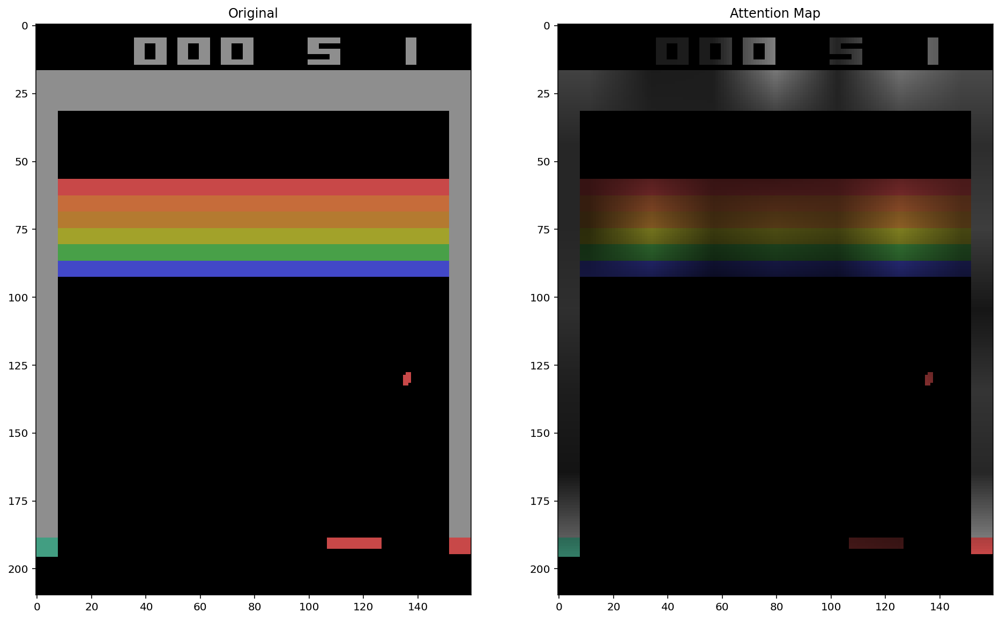

<Figure size 432x288 with 0 Axes>

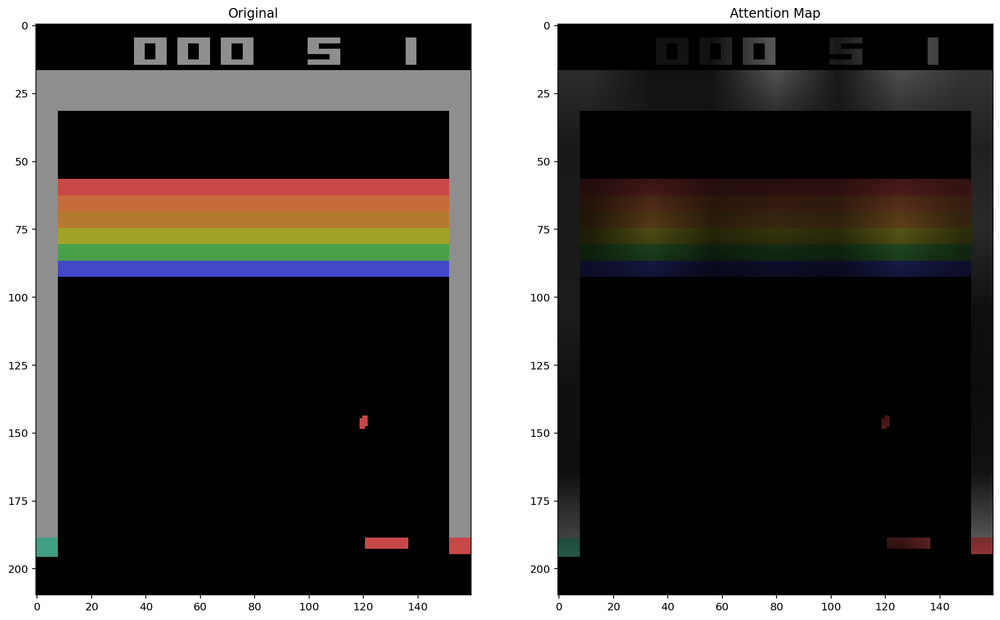

<Figure size 432x288 with 0 Axes>

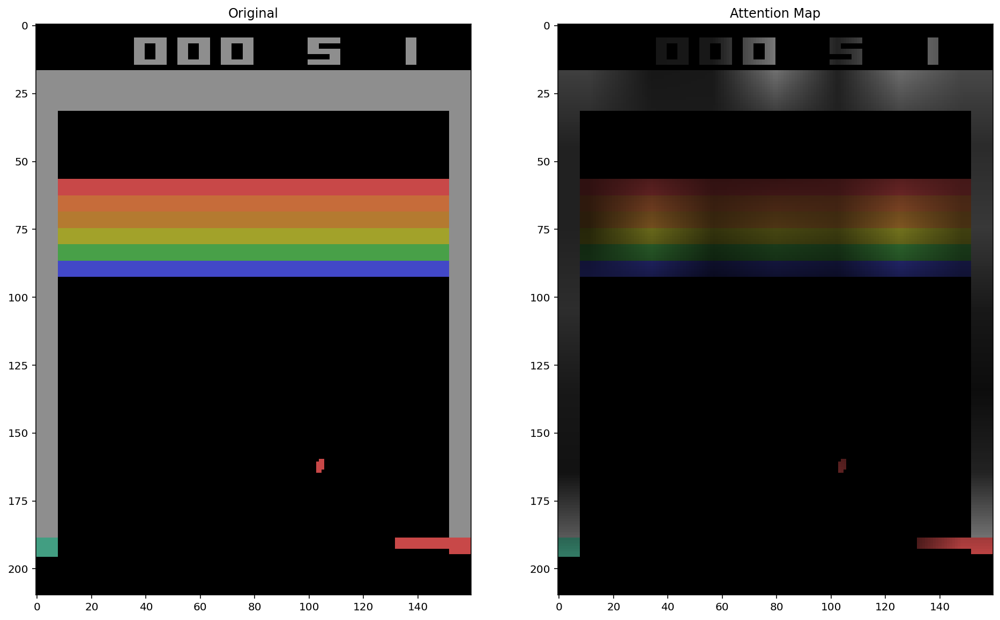

<Figure size 432x288 with 0 Axes>

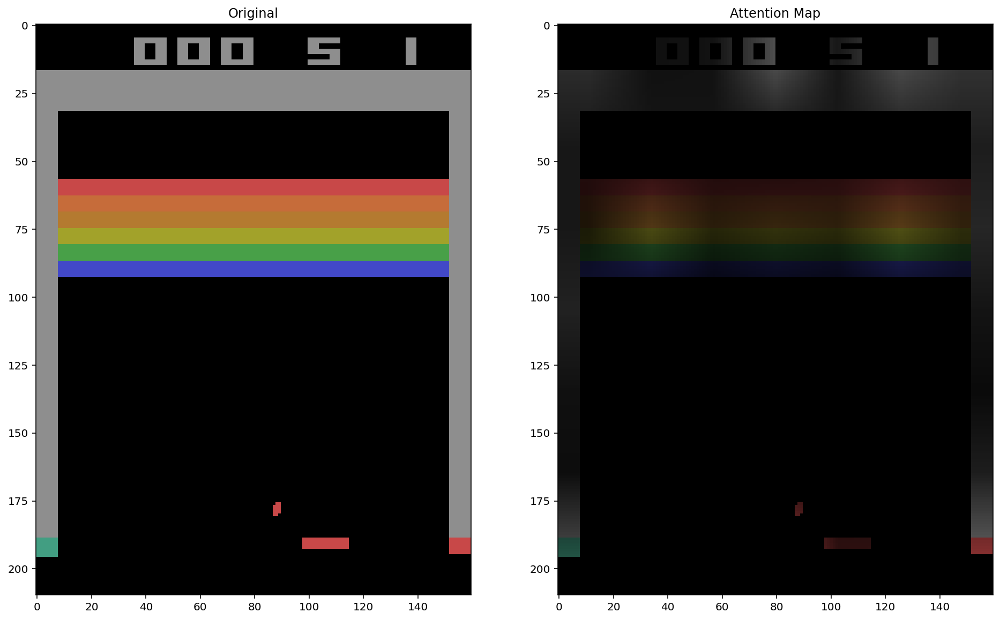

<Figure size 432x288 with 0 Axes>

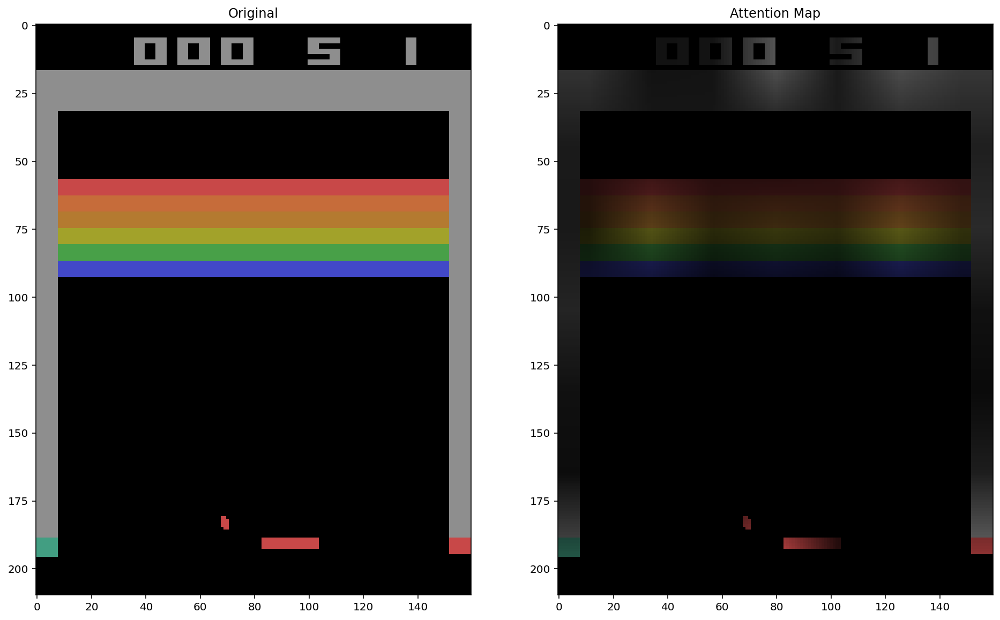

<Figure size 432x288 with 0 Axes>

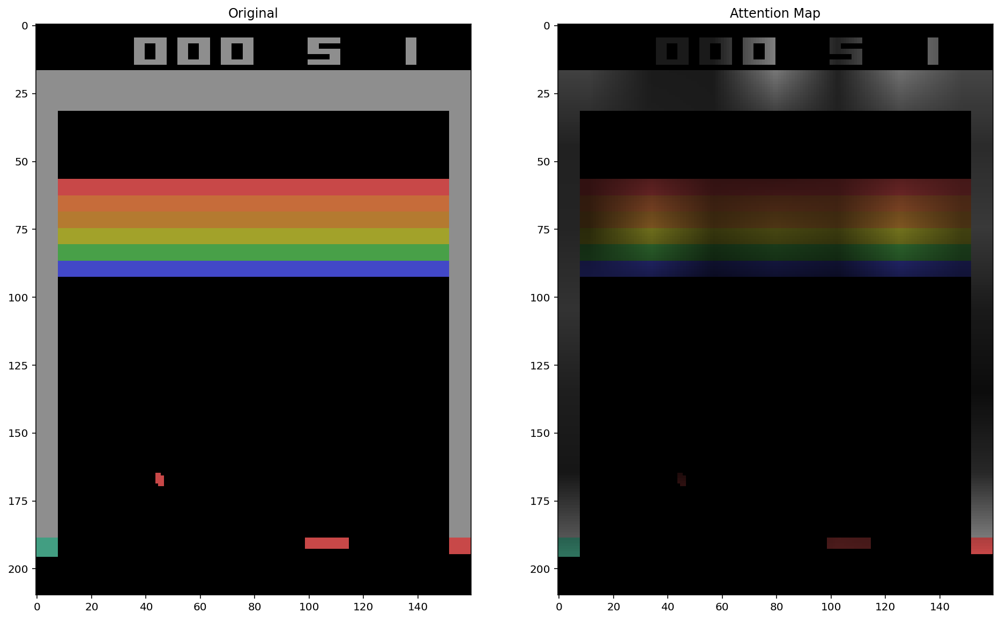

In [ ]:
plot_attention_for_game(selected_game_frames_full, games[0], input_resolution) 

<Figure size 432x288 with 0 Axes>

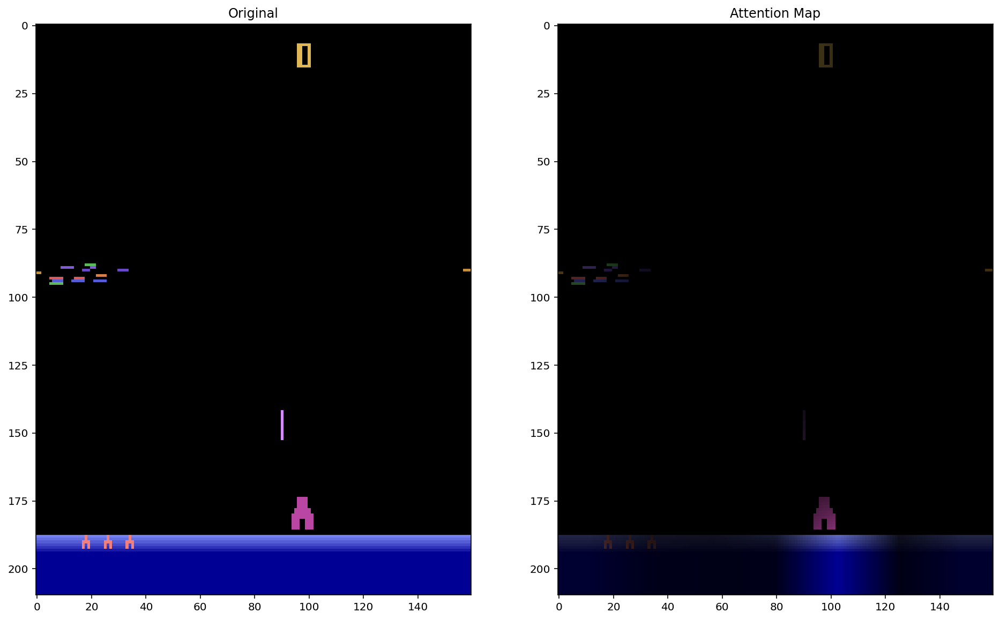

<Figure size 432x288 with 0 Axes>

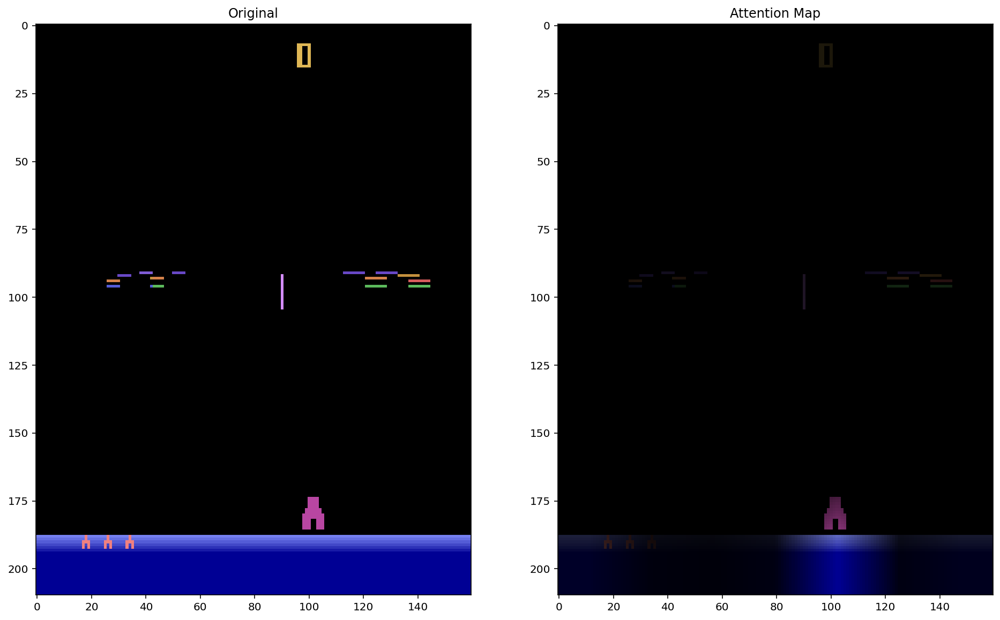

<Figure size 432x288 with 0 Axes>

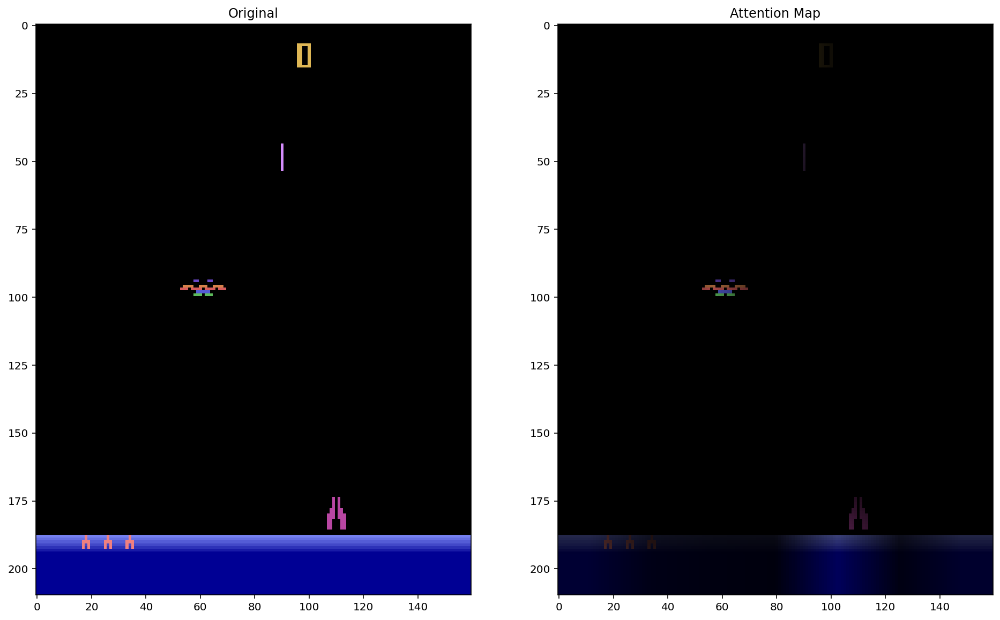

<Figure size 432x288 with 0 Axes>

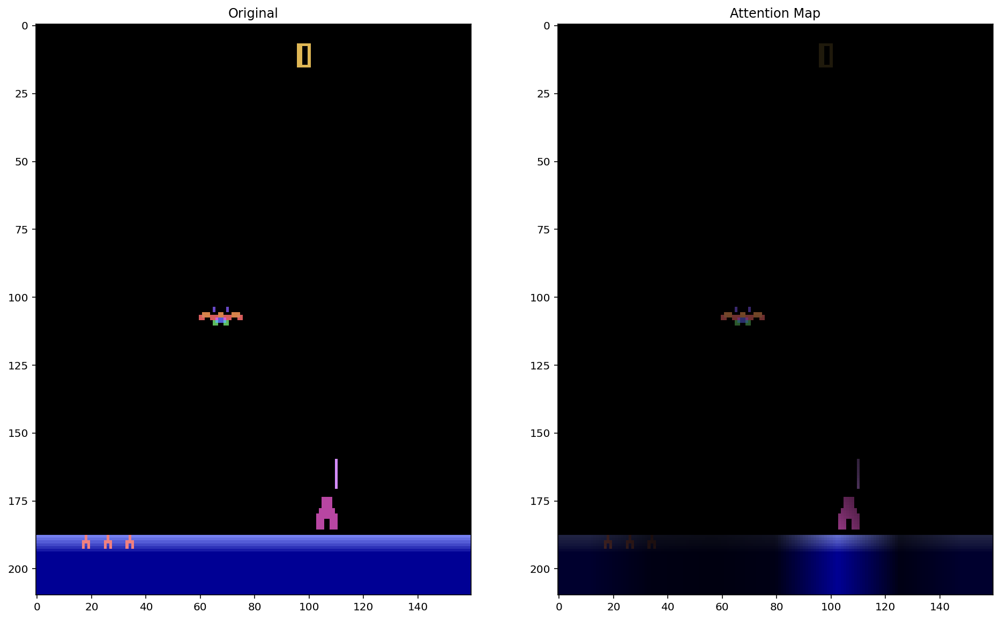

<Figure size 432x288 with 0 Axes>

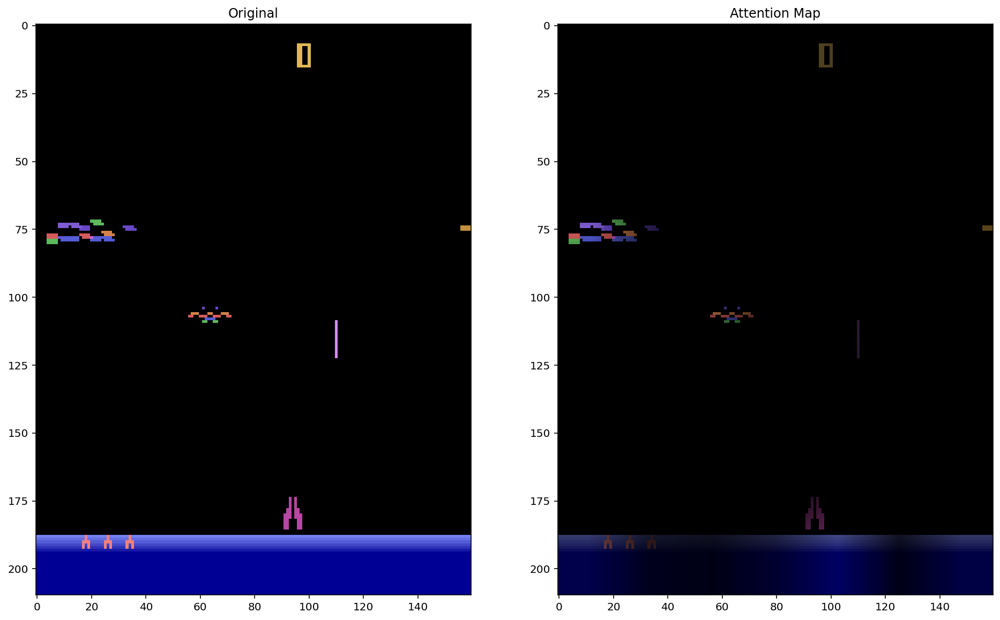

<Figure size 432x288 with 0 Axes>

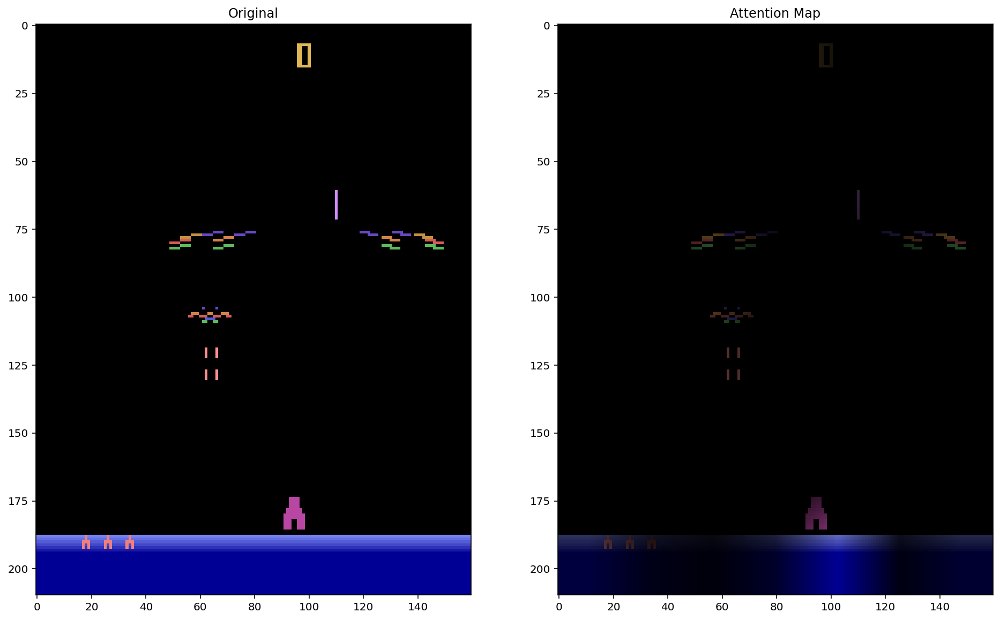

In [ ]:
plot_attention_for_game(selected_game_frames_full, games[1], input_resolution) 

<Figure size 432x288 with 0 Axes>

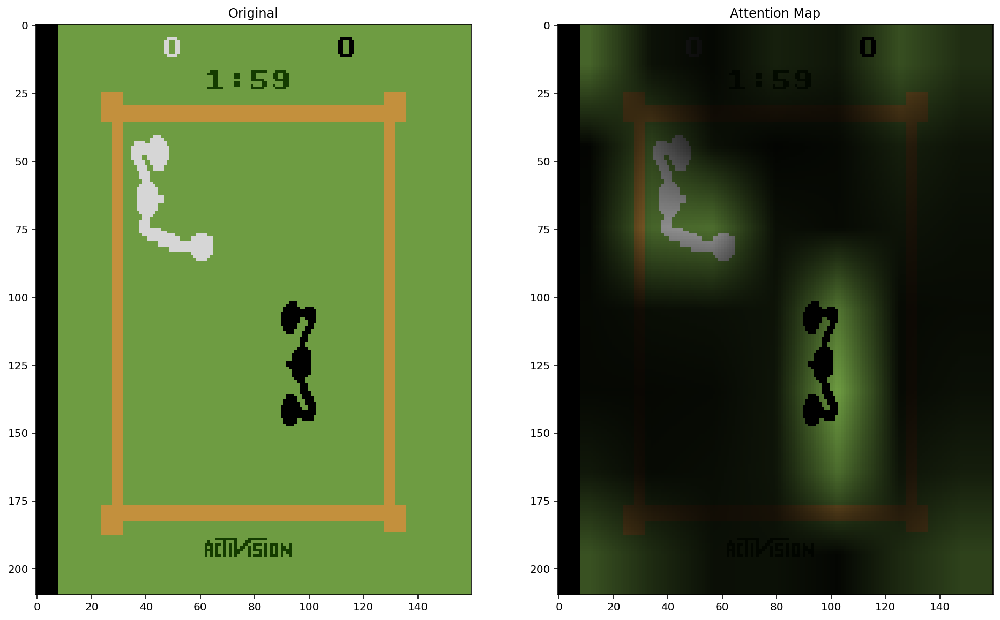

<Figure size 432x288 with 0 Axes>

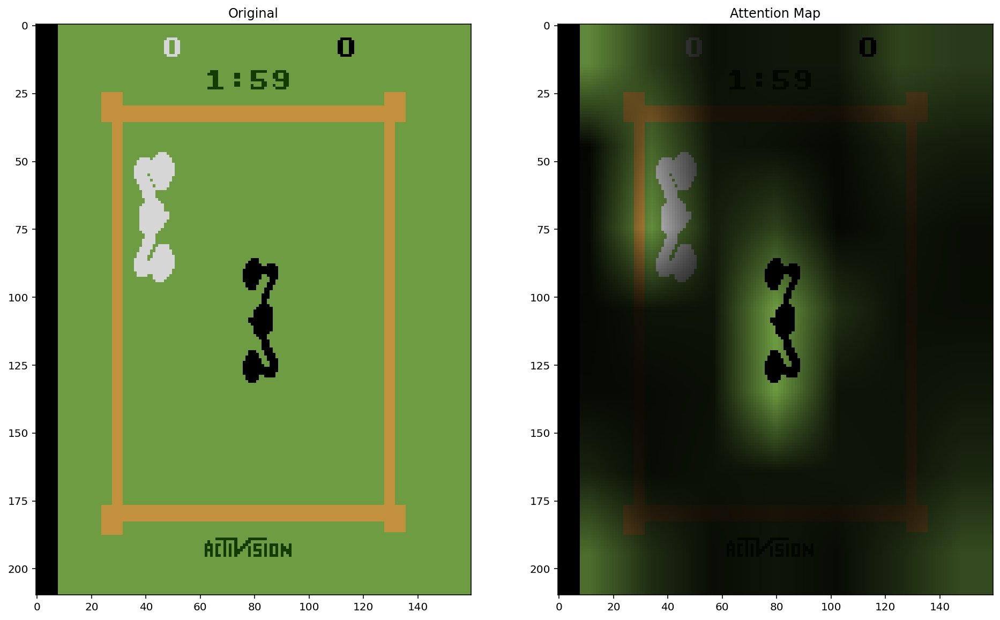

<Figure size 432x288 with 0 Axes>

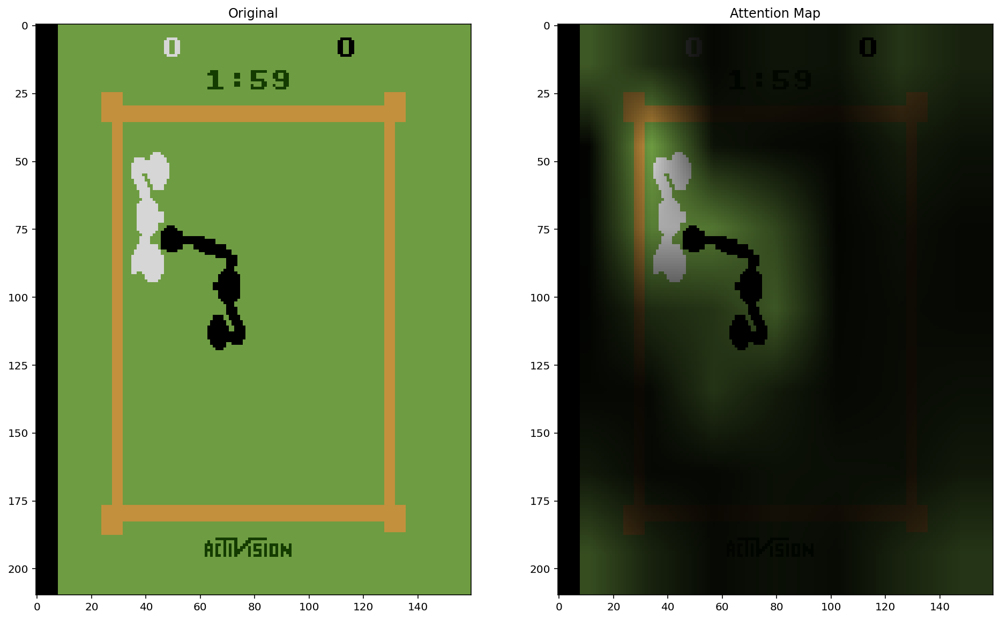

<Figure size 432x288 with 0 Axes>

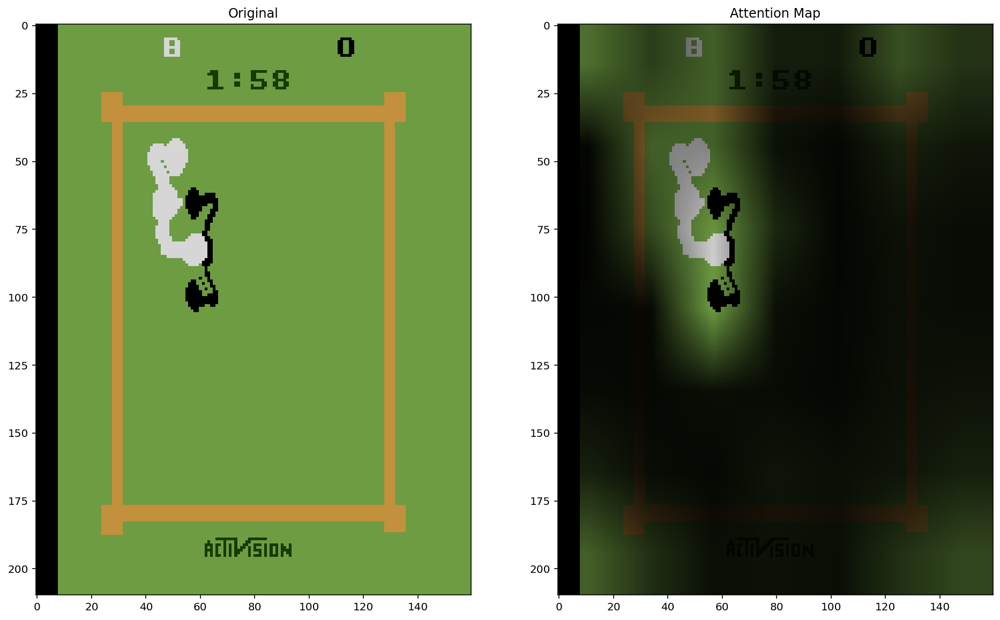

<Figure size 432x288 with 0 Axes>

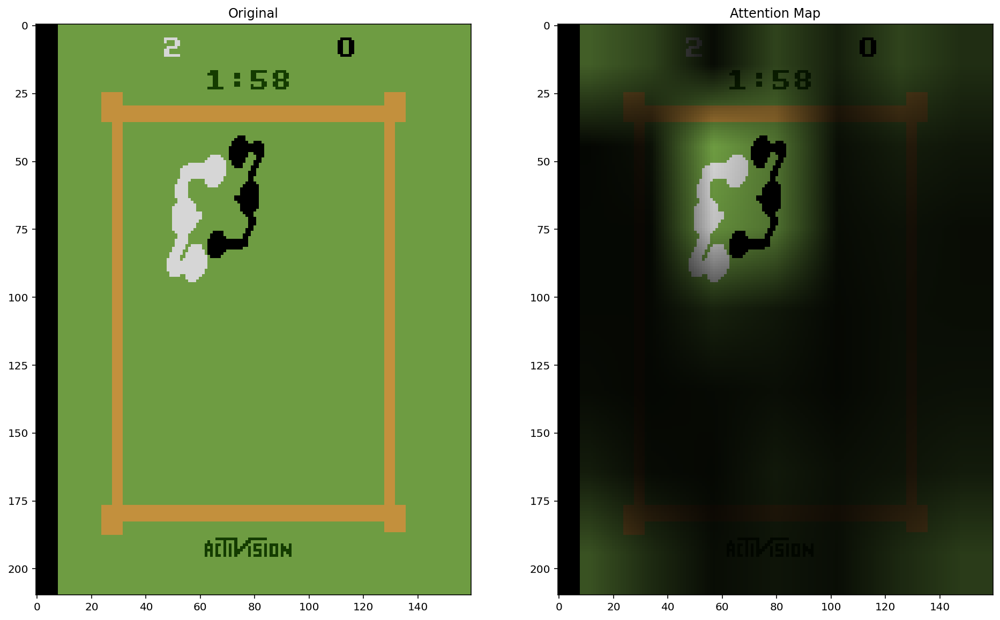

<Figure size 432x288 with 0 Axes>

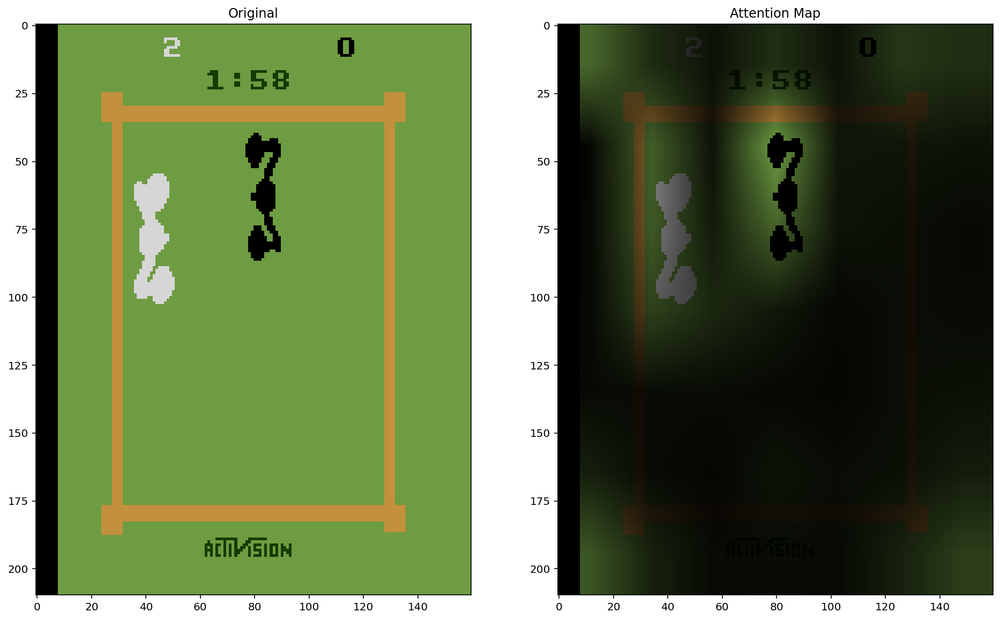

In [ ]:
plot_attention_for_game(selected_game_frames_full, games[2], input_resolution) 

### 2x2 patches

In [ ]:
games = list(selected_game_frames_2x2patches.keys())

<Figure size 1152x576 with 0 Axes>

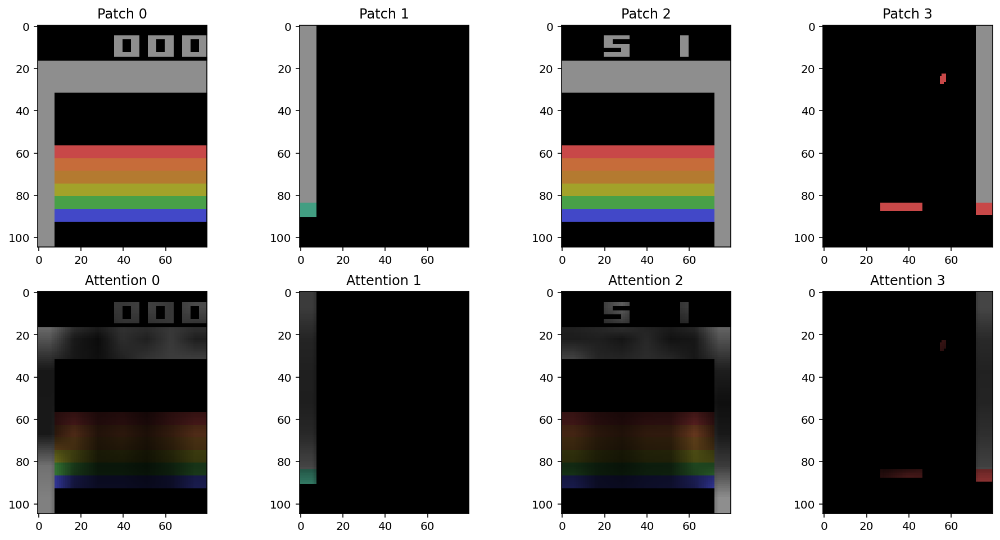

<Figure size 1152x576 with 0 Axes>

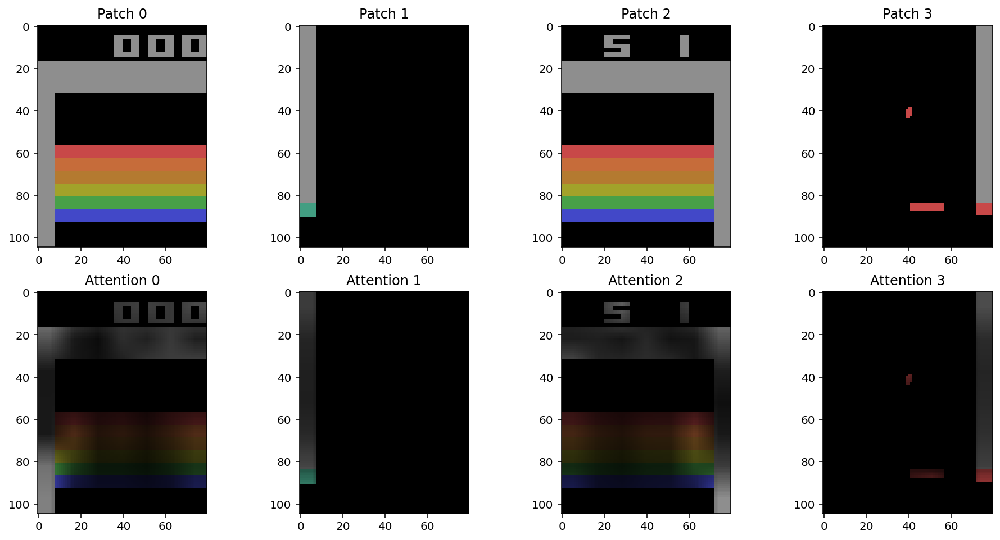

<Figure size 1152x576 with 0 Axes>

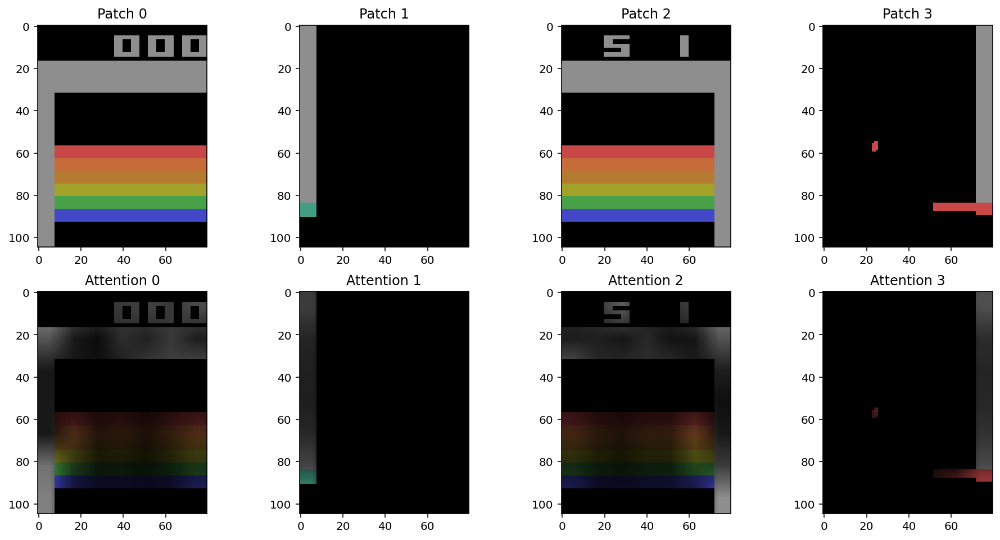

<Figure size 1152x576 with 0 Axes>

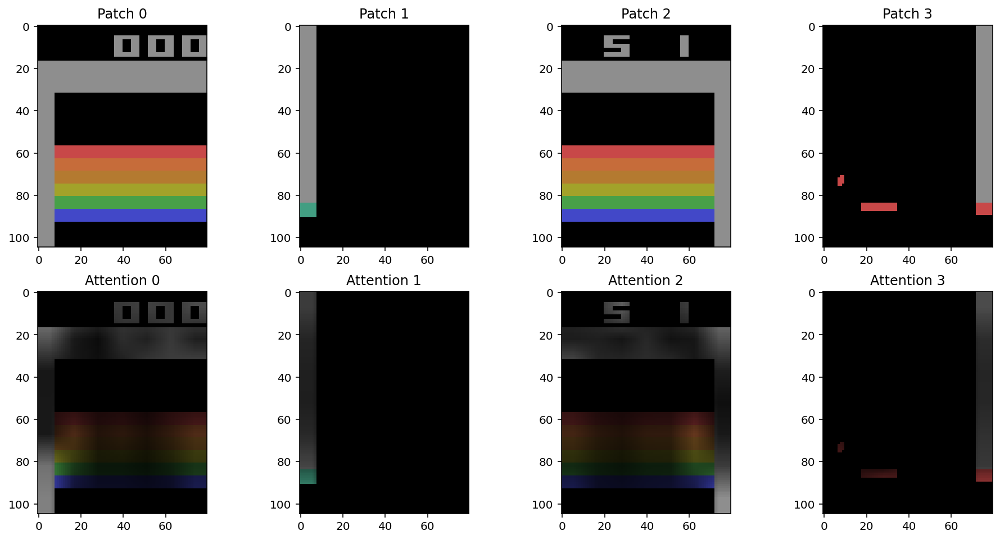

<Figure size 1152x576 with 0 Axes>

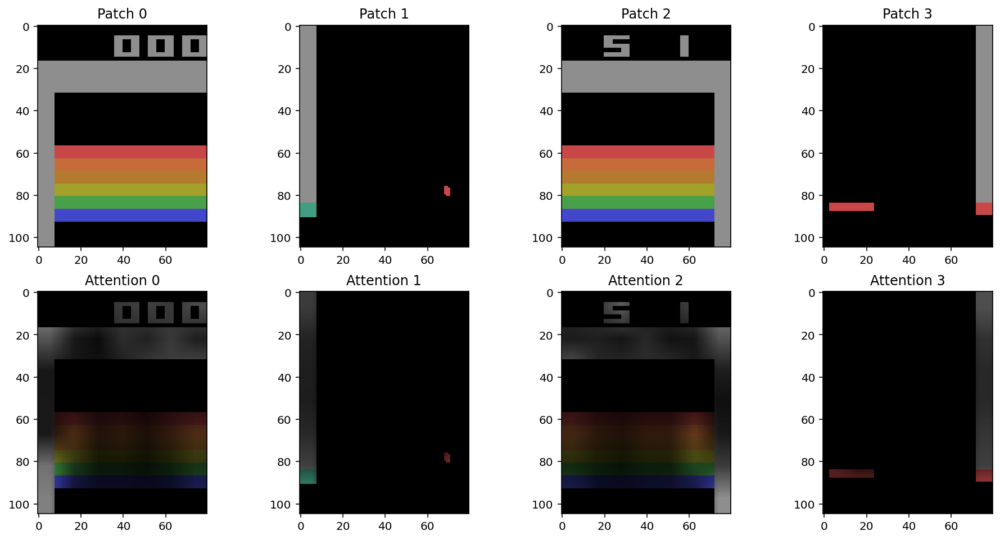

<Figure size 1152x576 with 0 Axes>

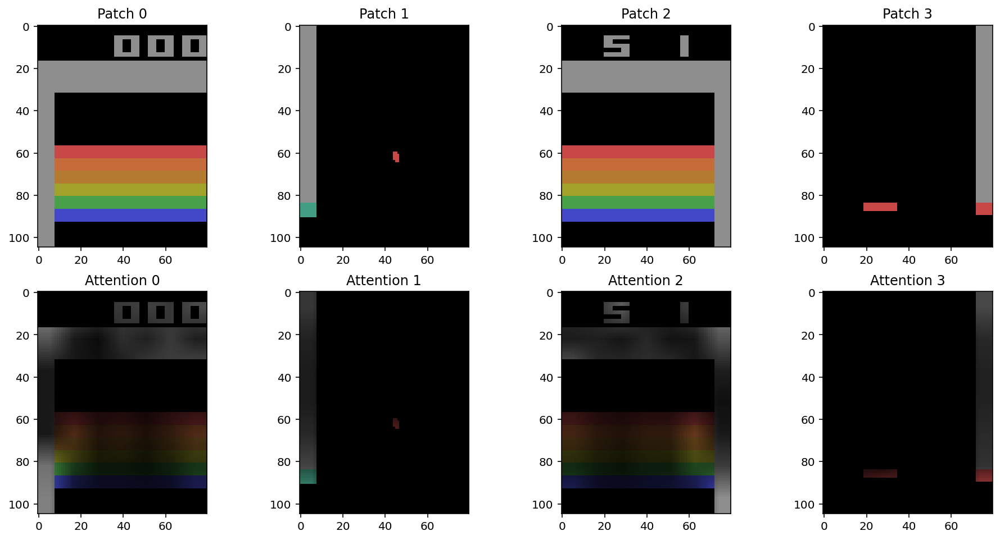

In [ ]:
plot_attention_for_game(selected_game_frames_2x2patches, games[0], input_resolution1) 

<Figure size 1152x576 with 0 Axes>

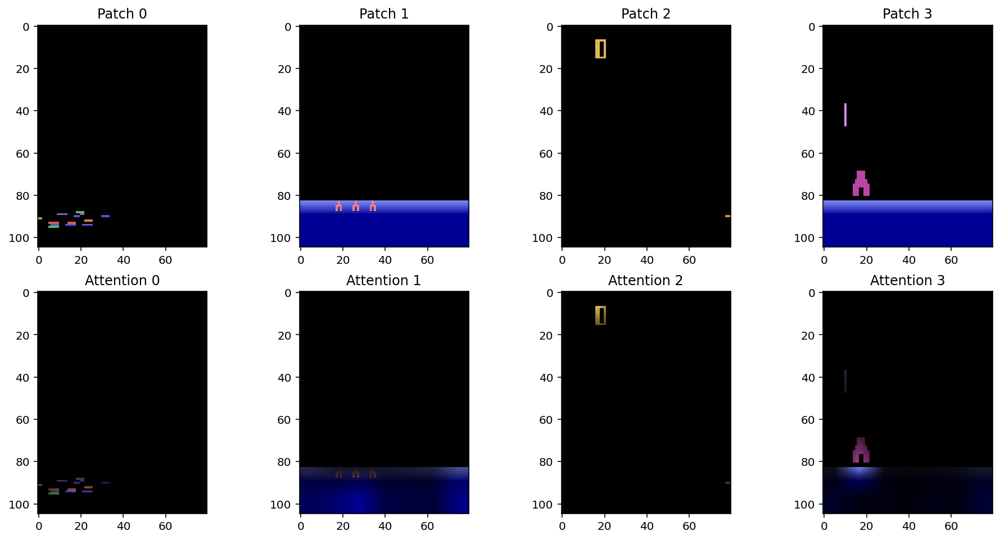

<Figure size 1152x576 with 0 Axes>

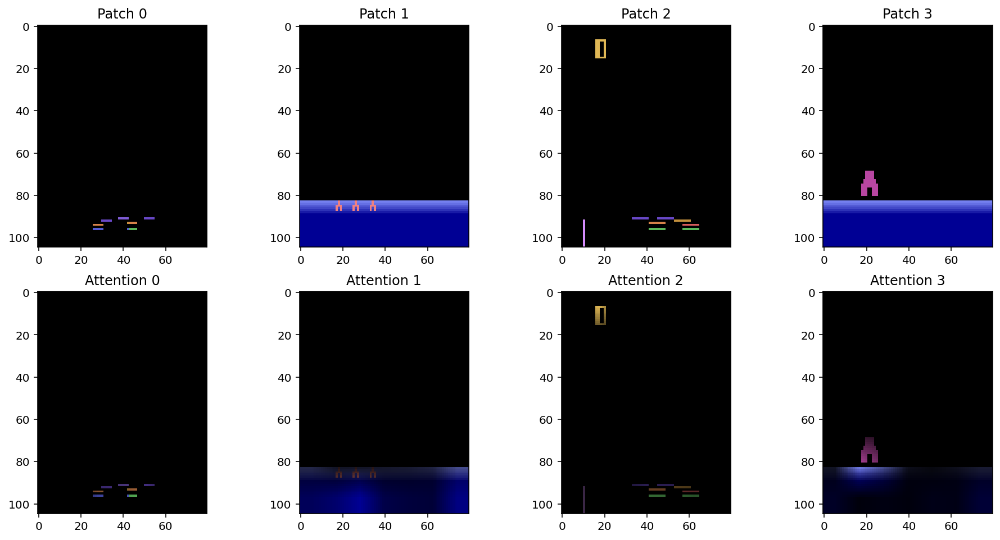

<Figure size 1152x576 with 0 Axes>

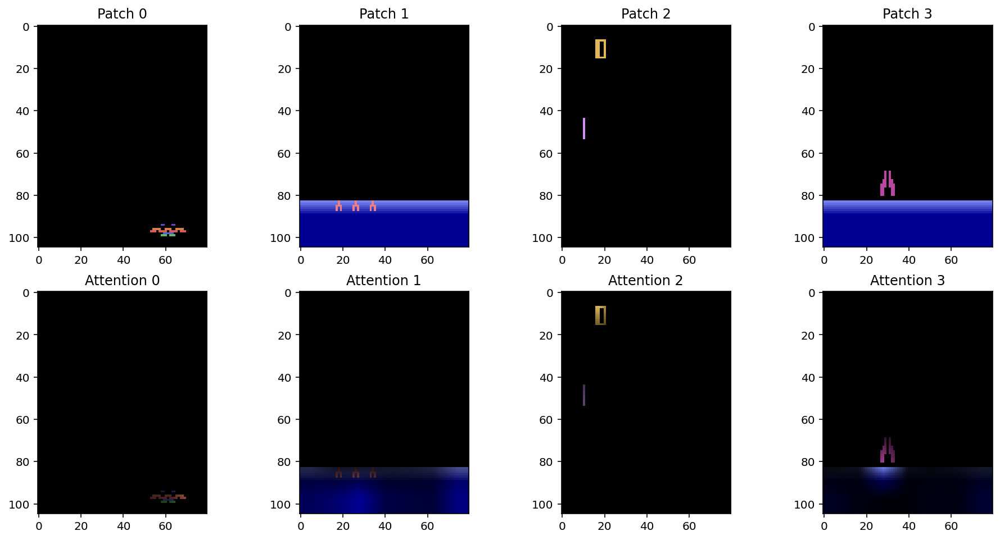

<Figure size 1152x576 with 0 Axes>

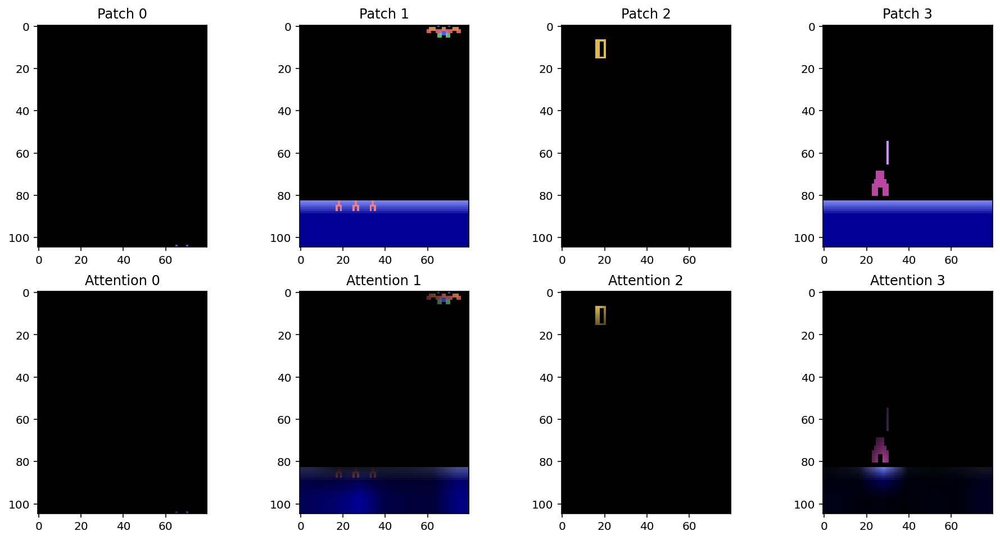

<Figure size 1152x576 with 0 Axes>

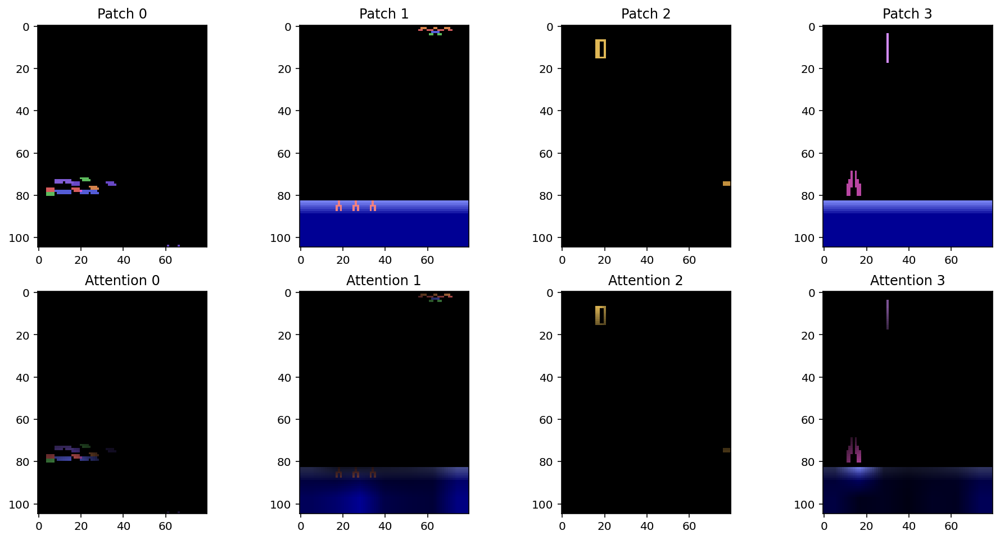

<Figure size 1152x576 with 0 Axes>

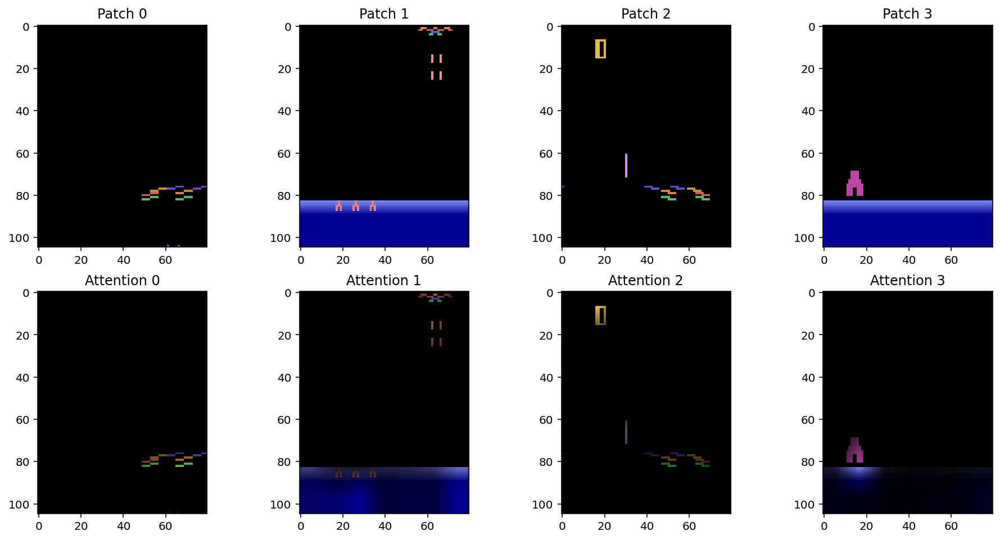

In [ ]:
plot_attention_for_game(selected_game_frames_2x2patches, games[1], input_resolution1) 

<Figure size 1152x576 with 0 Axes>

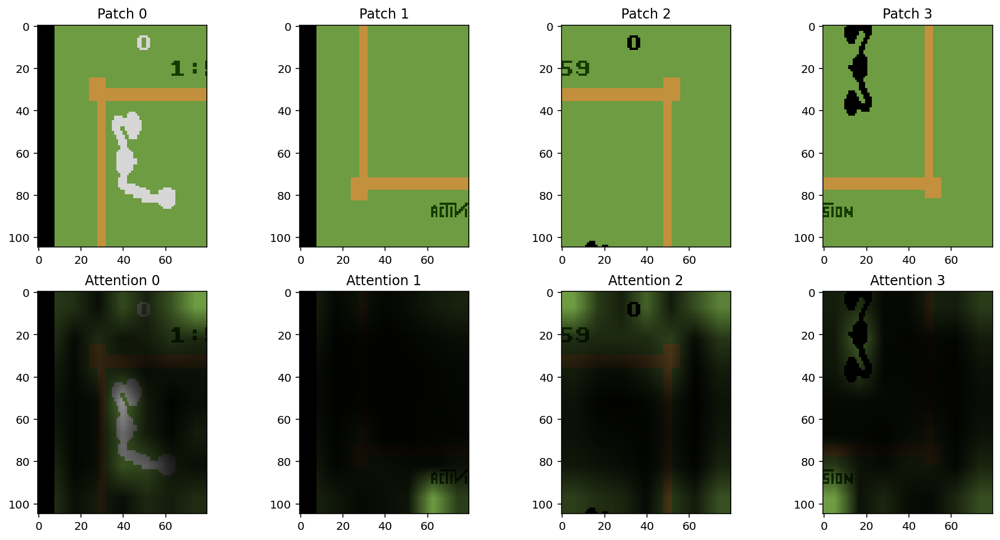

<Figure size 1152x576 with 0 Axes>

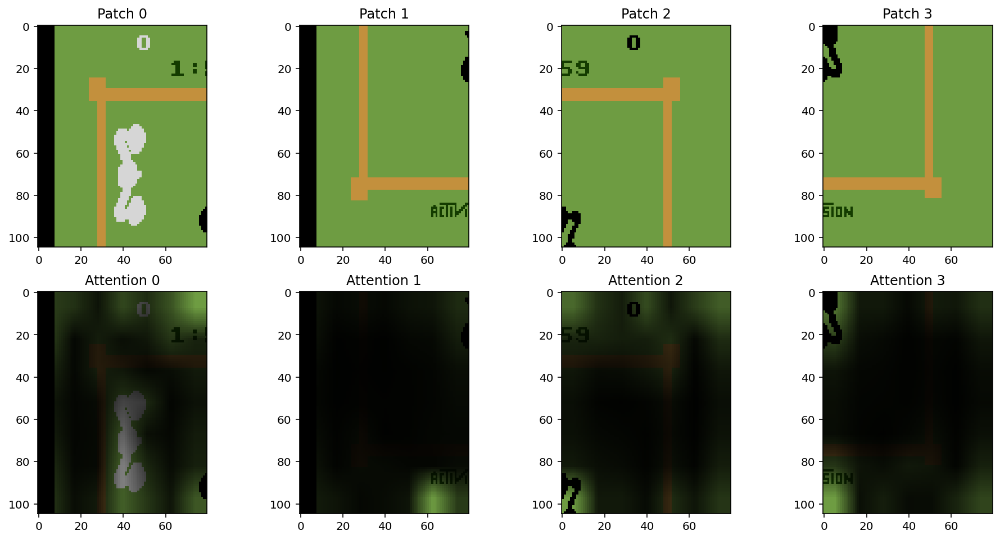

<Figure size 1152x576 with 0 Axes>

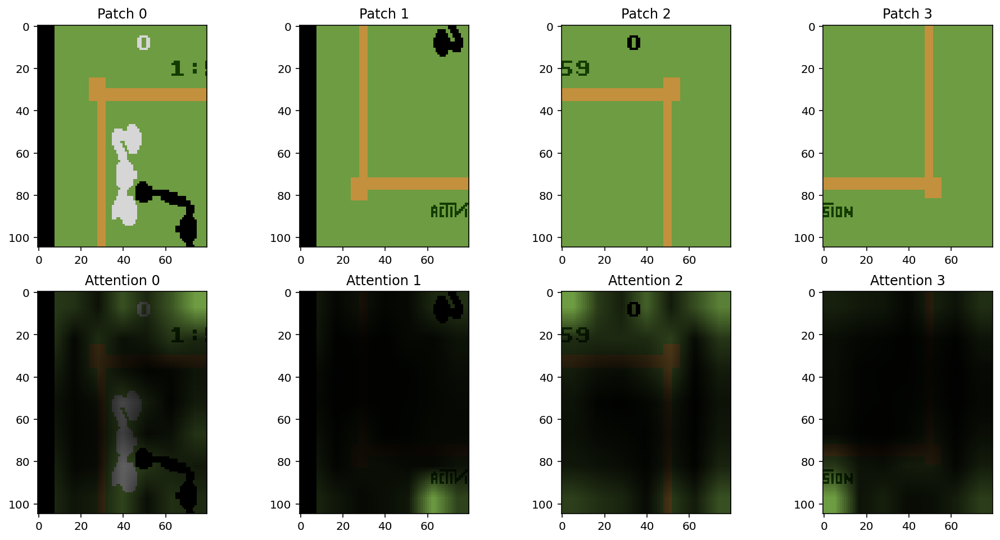

<Figure size 1152x576 with 0 Axes>

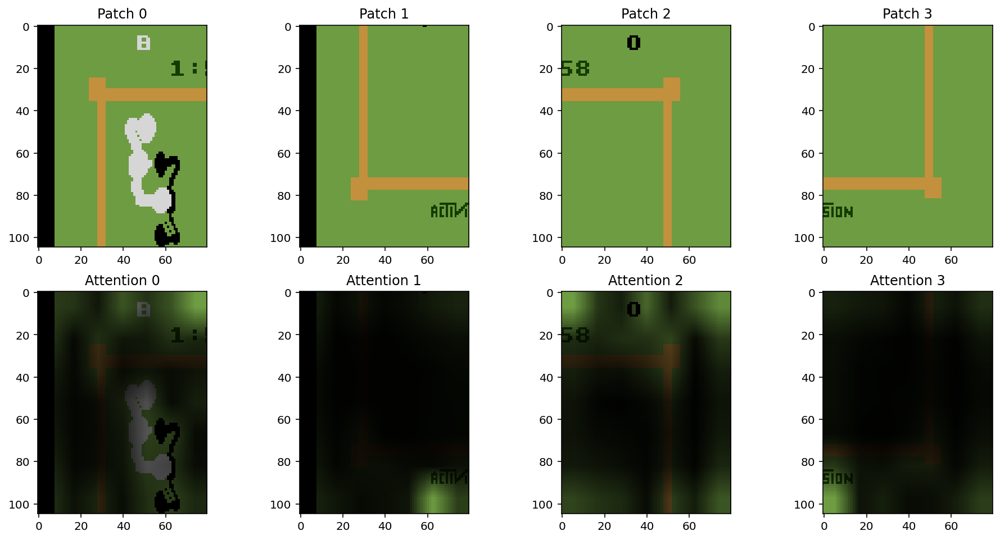

<Figure size 1152x576 with 0 Axes>

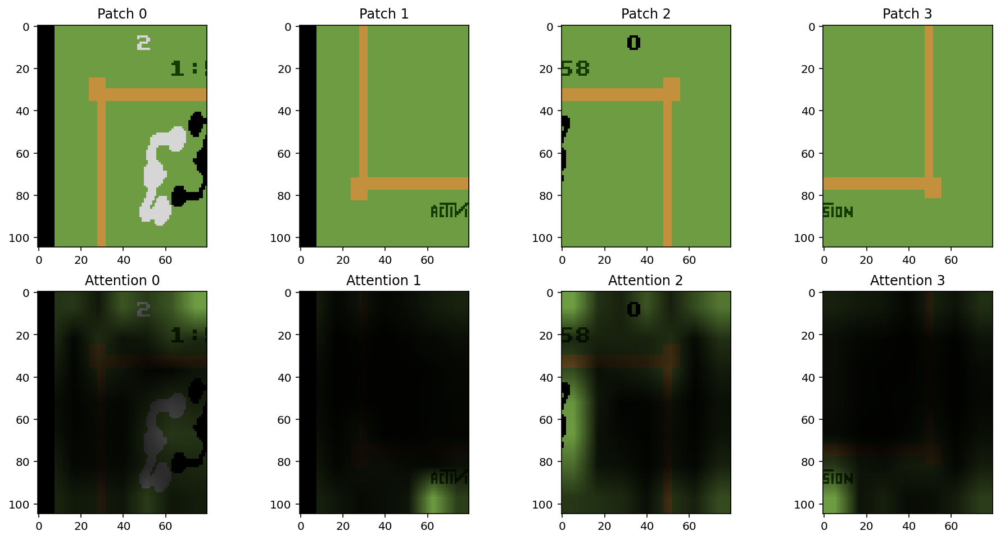

<Figure size 1152x576 with 0 Axes>

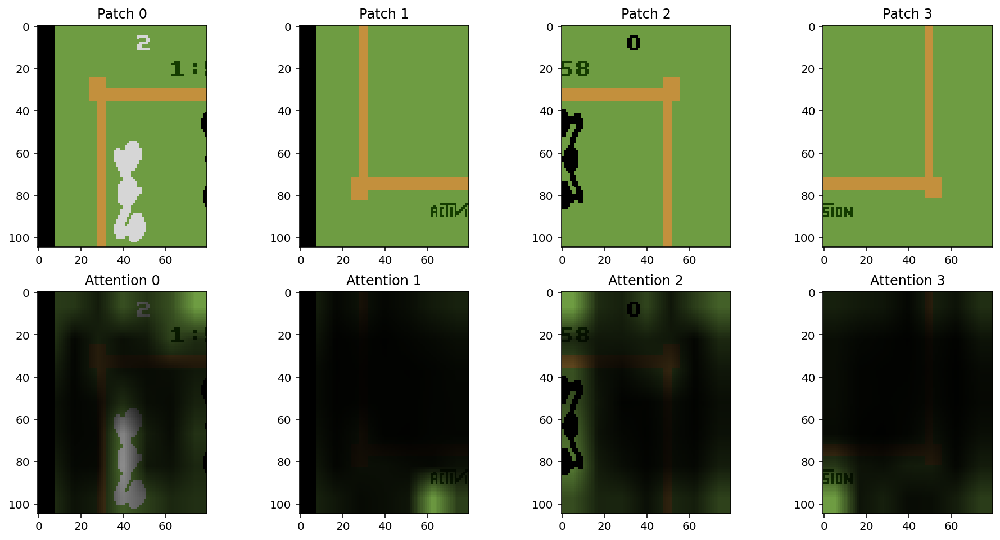

In [ ]:
plot_attention_for_game(selected_game_frames_2x2patches, games[2], input_resolution1) 

### 4x4 patches

In [ ]:
games = list(selected_game_frames_4x4patches.keys())

<Figure size 2304x216 with 0 Axes>

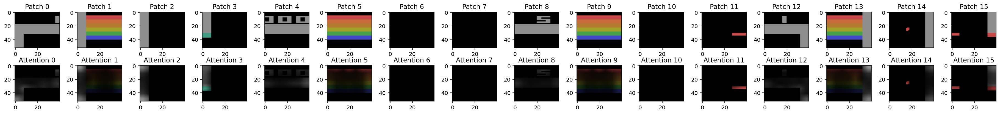

<Figure size 2304x216 with 0 Axes>

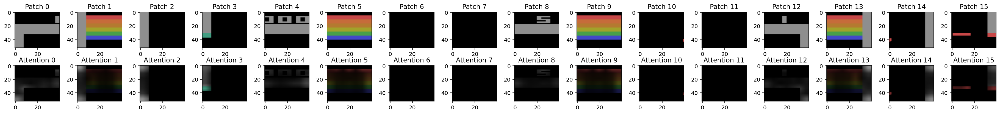

<Figure size 2304x216 with 0 Axes>

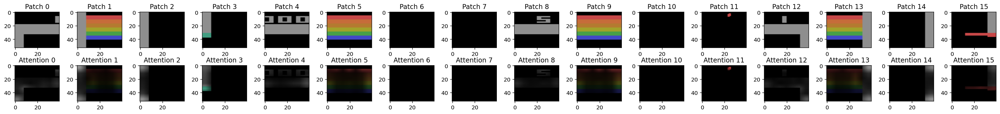

<Figure size 2304x216 with 0 Axes>

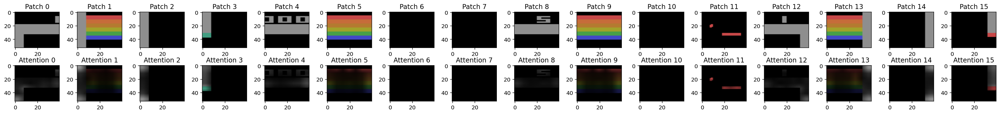

<Figure size 2304x216 with 0 Axes>

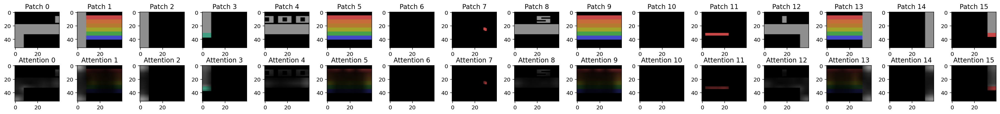

<Figure size 2304x216 with 0 Axes>

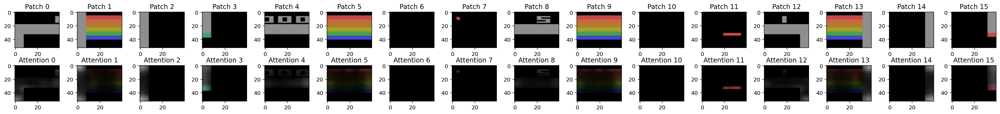

In [ ]:
plot_attention_for_game(selected_game_frames_4x4patches, games[0], input_resolution2) 

<Figure size 2304x216 with 0 Axes>

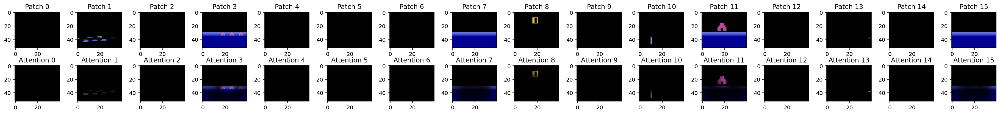

<Figure size 2304x216 with 0 Axes>

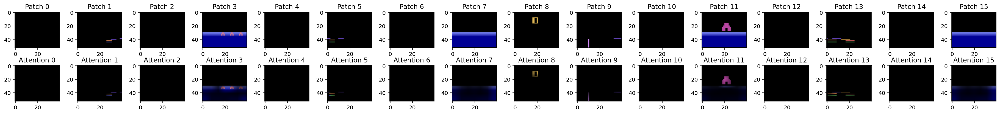

<Figure size 2304x216 with 0 Axes>

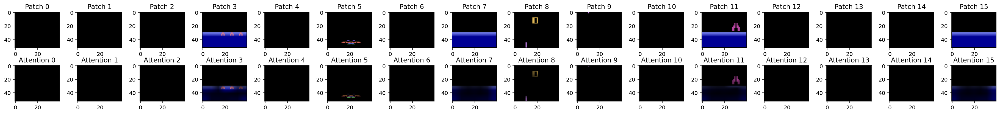

<Figure size 2304x216 with 0 Axes>

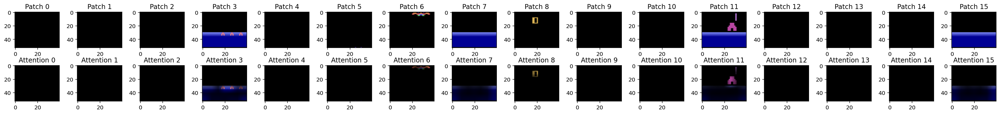

<Figure size 2304x216 with 0 Axes>

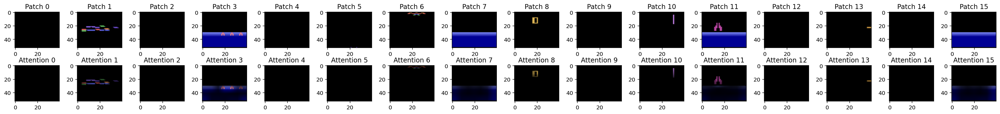

<Figure size 2304x216 with 0 Axes>

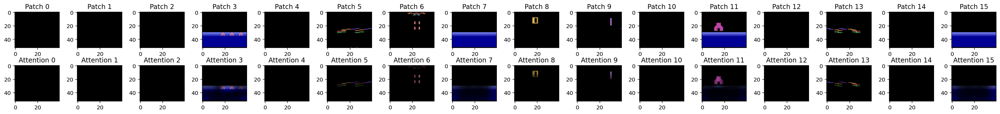

In [ ]:
plot_attention_for_game(selected_game_frames_4x4patches, games[1], input_resolution2) 

<Figure size 2304x216 with 0 Axes>

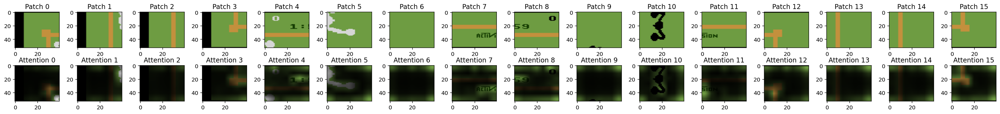

<Figure size 2304x216 with 0 Axes>

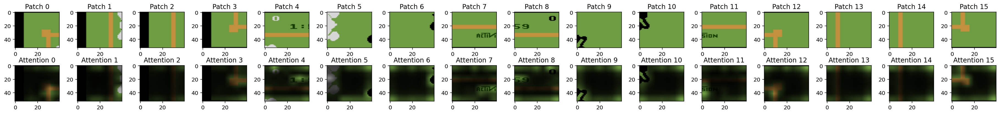

<Figure size 2304x216 with 0 Axes>

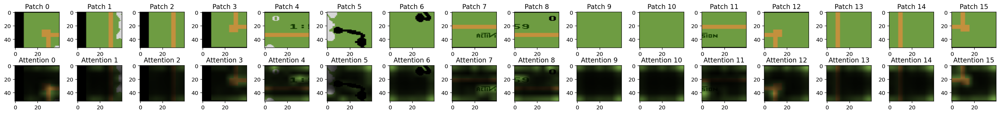

<Figure size 2304x216 with 0 Axes>

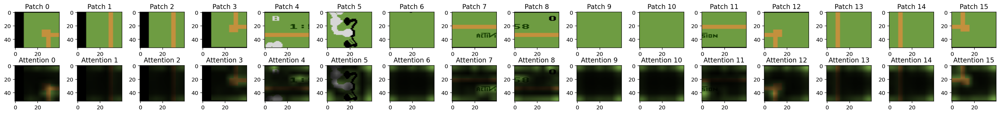

<Figure size 2304x216 with 0 Axes>

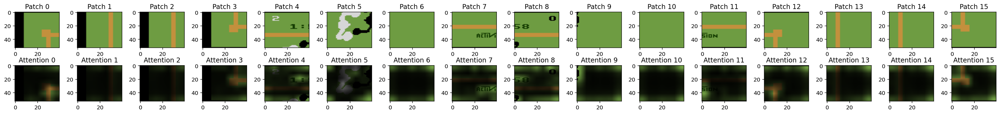

<Figure size 2304x216 with 0 Axes>

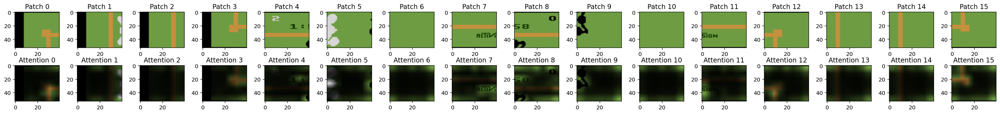

In [ ]:
plot_attention_for_game(selected_game_frames_4x4patches, games[2], input_resolution2) 

# Viz2: Get optical flow masks from RAFT

## Helper functions

In [ ]:
def flow_to_mask(flow_uv, mask_type="norm", clip_flow=None, convert_to_bgr=False):
    assert flow_uv.ndim == 3, 'input flow must have three dimensions'
    assert flow_uv.shape[2] == 2, 'input flow must have shape [H,W,2]'
    if clip_flow is not None:
        flow_uv = np.clip(flow_uv, 0, clip_flow)
    u = flow_uv[:,:,0]
    v = flow_uv[:,:,1]
    rad = np.sqrt(np.square(u) + np.square(v))

    if mask_type == "norm":
        mask = rad / np.max(rad)
    elif mask_type == "clip":
        mask = np.clip(rad, 0, 1)

    return mask

In [ ]:
def mask_image(image, mask, add_background_noise=False):
    mask_3c = np.stack([mask for _ in range(3)])
    inv_mask_3c = 1 - mask_3c

    masked_image = image * mask_3c

    if add_background_noise:
        if np.max(image) > 1:
            noise = np.random.randint(0, np.max(image), masked_image.shape)
        else:
            noise = np.random.random(masked_image.shape)
        masked_image = masked_image + noise*inv_mask_3c
    
    return masked_image

In [ ]:
def get_optical_flow_from_consecutive_images(
    image1, 
    image2, 
    model, 
    output_types=["mask"]
):
    out = []

    flow_low, flow_up = model(image1, image2, iters=20, test_mode=True)
    
    if "output" in output_types:
        flow_output = flow_viz.flow_to_image(flow_up[0].permute(1,2,0).cpu().numpy())
        flow_output_im = flow_output.astype(np.uint8)
        out.append(flow_output_im)
    if "mask" in output_types:
        flow_numpy = flow_up[0].permute(1,2,0).cpu().numpy()
        image_numpy = image1[0].cpu().numpy()

        mask = flow_to_mask(flow_numpy)
        masked_image = mask_image(image_numpy, mask)
        masked_image_im = masked_image.astype(np.uint8).transpose(1,2,0)
        
        out.append(masked_image_im)

    return out

In [ ]:
def preprocess_for_raft(im1, im2):
    image1 = im1.float().unsqueeze(0).cuda()
    image2 = im2.float().unsqueeze(0).cuda()
    padder = InputPadder(image1.shape)
    image1, image2 = padder.pad(image1, image2)

    return image1, image2

In [ ]:
def plot_optical_flow_output_full(images_to_plot, titles):
    fig, axes = plt.subplots(ncols=len(images_to_plot), figsize=(24, 16))

    for idx_ax, ax in enumerate(axes):
        ax.set_title(titles[idx_ax])
        _ = ax.imshow(images_to_plot[idx_ax])

In [ ]:
def plot_optical_flow_output_2x2patches(lists_to_plot, titles_to_plot, num_patches):

    plt.figure(figsize=(16, 12))
    fig, axes = plt.subplots(len(lists_to_plot), num_patches, figsize=(16, 12))

    # original patch
    for i in range(num_patches):
        for idx_l in range(len(lists_to_plot)):
            axes[idx_l, i].set_title('{} {}'.format(titles_to_plot[idx_l], i))
            axes[idx_l, i].imshow(lists_to_plot[idx_l][i])

    #fig.tight_layout()

In [ ]:
def plot_optical_flow_output_4x4patches(lists_to_plot, titles_to_plot, num_patches):

    plt.figure(figsize=(32, 5))
    fig, axes = plt.subplots(len(lists_to_plot), num_patches, figsize=(32, 5))

    plt.subplots_adjust(hspace=0.5, wspace=0.4)

    # original patch
    for i in range(num_patches):
        for idx_l in range(len(lists_to_plot)):
            axes[idx_l, i].set_title('{} {}'.format(titles_to_plot[idx_l], i))
            axes[idx_l, i].imshow(lists_to_plot[idx_l][i], aspect='auto')

In [ ]:
def plot_optical_flow_full(
    selected_game_frames, 
    game, 
    model,
    flow_output_types = ["mask"]
):
    frames = selected_game_frames[game]
    with torch.no_grad():
        for frame in frames:
            images_to_plot = []
            titles_to_plot = []
            
            im1, im2 = frame
            image1, image2 = preprocess_for_raft(im1, im2)

            plot_im = image1[0].permute(1,2,0).cpu().numpy().astype(np.uint8)
            images_to_plot.append(plot_im)
            titles_to_plot.append("Original")

            flow_outputs = get_optical_flow_from_consecutive_images(image1, image2, model, flow_output_types)
            images_to_plot += flow_outputs

            if "output" in flow_output_types:
                titles_to_plot.append("Optical Flow Output")
            if "mask" in flow_output_types:
                titles_to_plot.append("Optical Flow Mask")

            plot_optical_flow_output_full(images_to_plot, titles_to_plot)


In [ ]:
def plot_optical_flow_patches(
    selected_game_frames,
    game,
    model,
    num_patches,
    flow_output_types = ["mask"]
):
    frames = selected_game_frames[game]
    with torch.no_grad():
        for frame in frames:
            im1, im2 = frame
            patches1 = im1.split(split_size=1, dim=0)
            patches2 = im2.split(split_size=1, dim=0)
            
            titles_to_plot = ["Patch"]
            if "output" in flow_output_types:
                titles_to_plot.append("OF Output")
            if "mask" in flow_output_types:
                titles_to_plot.append("OF Mask")


            lists_to_plot = [[]] + [[] for _ in flow_output_types]
            for idx_p in range(num_patches):
                scale = np.sqrt(num_patches)
                
                p1 = patches1[idx_p]
                p2 = patches2[idx_p]

                # resize images to original size to avoid nans
                p1 = F.interpolate(p1, scale_factor=scale).squeeze(0)
                p2 = F.interpolate(p2, scale_factor=scale).squeeze(0)

                patch1, patch2 = preprocess_for_raft(p1, p2)

                plot_im = patch1[0].permute(1,2,0).cpu().numpy().astype(np.uint8)
                lists_to_plot[0].append(plot_im)

                flow_outputs = get_optical_flow_from_consecutive_images(
                    patch1, 
                    patch2, 
                    model, 
                    flow_output_types
                    )
                for idx_o, out in enumerate(flow_outputs):
                    lists_to_plot[idx_o+1].append(out)

            if num_patches == 4:
                plot_optical_flow_output_2x2patches(lists_to_plot, titles_to_plot, num_patches)
            elif num_patches == 16:
                plot_optical_flow_output_4x4patches(lists_to_plot, titles_to_plot, num_patches)

In [ ]:
def plot_optical_flow_for_game(
    selected_frames, 
    game, 
    raft_args,
    input_resolution,
    flow_output_type = ["mask"]
    ):

    model = torch.nn.DataParallel(RAFT(raft_args))
    model.load_state_dict(torch.load(raft_args.model))
    model = model.module
    model.to(DEVICE)
    model.eval()

    if input_resolution == "full-image":
        plot_optical_flow_full(selected_frames, game, model, flow_output_type)
    elif input_resolution == "2x2patches":
        num_patches = 4
        plot_optical_flow_patches(selected_frames, game, model, num_patches, flow_output_type)
    elif input_resolution == "4x4patches":
        num_patches = 16
        plot_optical_flow_patches(selected_frames, game, model, num_patches, flow_output_type)
    else:
        raise Exception("Invalid input resolution... choose between full-image, 2x2patches, 4x4patches")

## RAFT initialisation

In [ ]:
% cd RAFT

/content/RAFT


In [ ]:
!wget https://www.dropbox.com/s/4j4z58wuv8o0mfz/models.zip
!unzip models.zip

--2021-06-08 15:21:39--  https://www.dropbox.com/s/4j4z58wuv8o0mfz/models.zip
Resolving www.dropbox.com (www.dropbox.com)... 162.125.1.18, 2620:100:6032:18::a27d:5212
Connecting to www.dropbox.com (www.dropbox.com)|162.125.1.18|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/4j4z58wuv8o0mfz/models.zip [following]
--2021-06-08 15:21:39--  https://www.dropbox.com/s/raw/4j4z58wuv8o0mfz/models.zip
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc7fe16609a91b8a4f97eebfb552.dl.dropboxusercontent.com/cd/0/inline/BQBPebrQSnFYHLUjb3cupNIZewo-FX9LmBHvxzXamn4mWPPzkoqdALAu32VumnwQ1SkBLwYkwUVxnDJxcgzeD7yQwdnndykSTH5sGs-XrkAfo7Ivq07s5vfI8iDCJWZxUTf_wBa3DVFDJHR3ZRpI4EbG/file# [following]
--2021-06-08 15:21:40--  https://uc7fe16609a91b8a4f97eebfb552.dl.dropboxusercontent.com/cd/0/inline/BQBPebrQSnFYHLUjb3cupNIZewo-FX9LmBHvxzXamn4mWPPzkoqdALAu32VumnwQ1SkBLwYkwUVxnDJxcgzeD7yQwdnndyk

In [ ]:
sys.path.append('core')

from utils import flow_viz
from raft import RAFT
from utils.utils import InputPadder


DEVICE = 'cuda'

In [ ]:
parser = argparse.ArgumentParser()
parser.add_argument('--model', default="models/raft-things.pth", help="restore checkpoint")
# parser.add_argument('--path', default="demo-frames", help="dataset for evaluation")
parser.add_argument('--small', action='store_true', help='use small model')
parser.add_argument('--mixed_precision', action='store_true', help='use mixed precision')
parser.add_argument('--alternate_corr', action='store_true', help='use efficent correlation implementation')
raft_args = parser.parse_args(args=["--model=models/raft-things.pth"])

## Visualize optical flow masks

In [ ]:
of_selected_game_frames_full = get_selected_frames_by_consecutive_pairs(game_data, input_resolution, num_frames=num_frames, start=start, skip=skip)
of_selected_game_frames_2x2patches = get_selected_frames_by_consecutive_pairs(game_data, input_resolution1, num_frames=num_frames, start=start, skip=skip)
of_selected_game_frames_4x4patches = get_selected_frames_by_consecutive_pairs(game_data, input_resolution2, num_frames=num_frames, start=start, skip=skip)

In [ ]:
flow_output_types = ["output", "mask"]

### Full img

In [ ]:
of_games = list(of_selected_game_frames_full.keys())

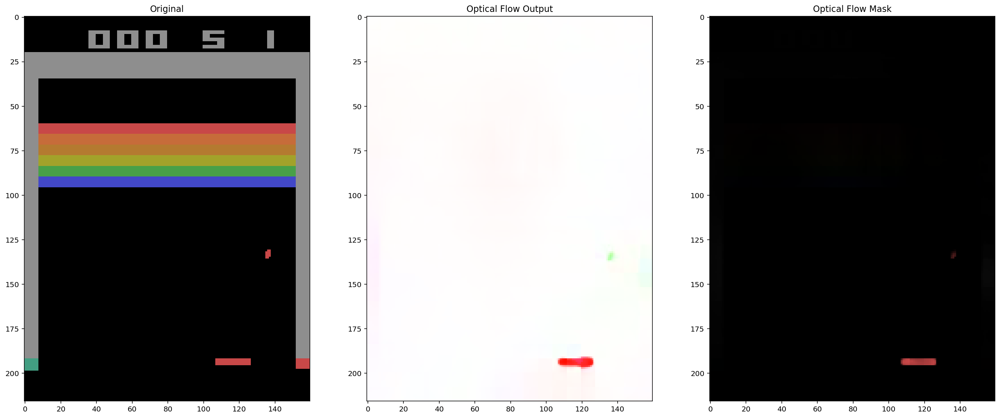

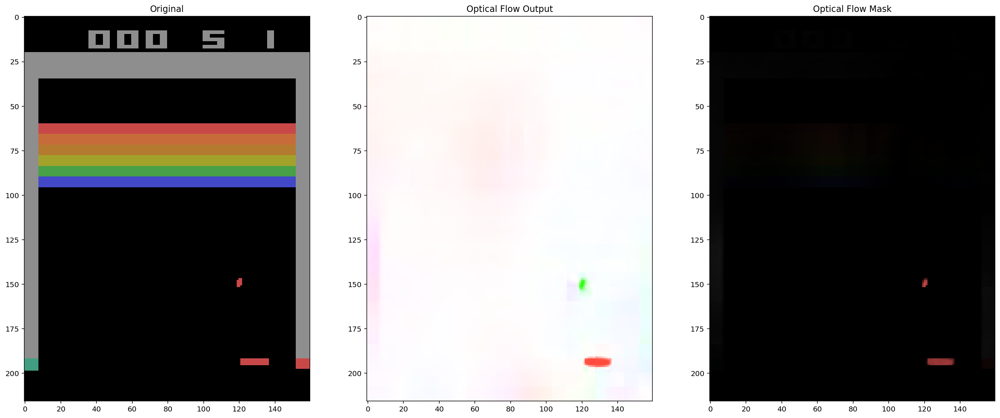

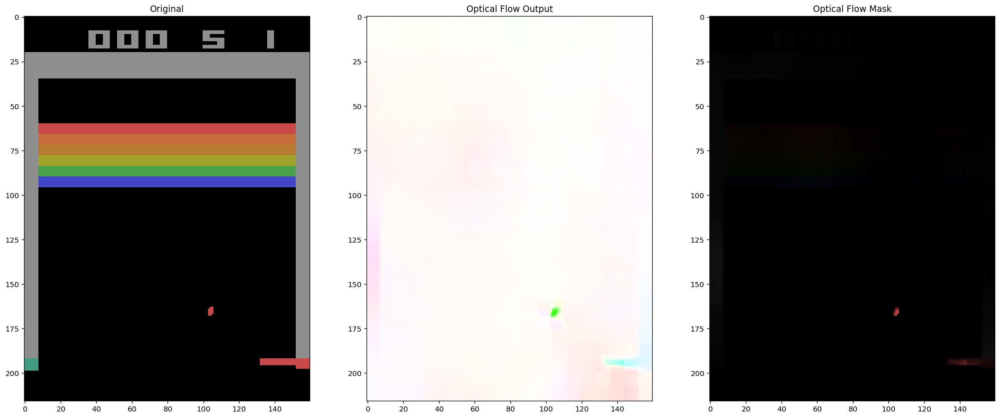

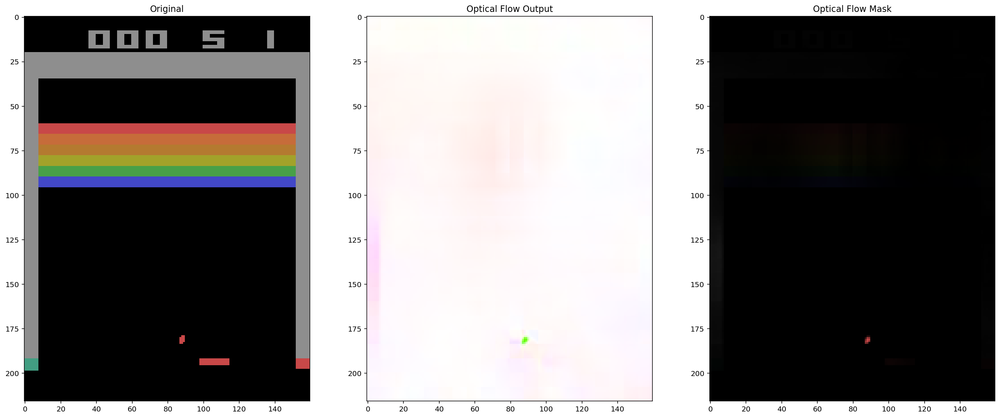

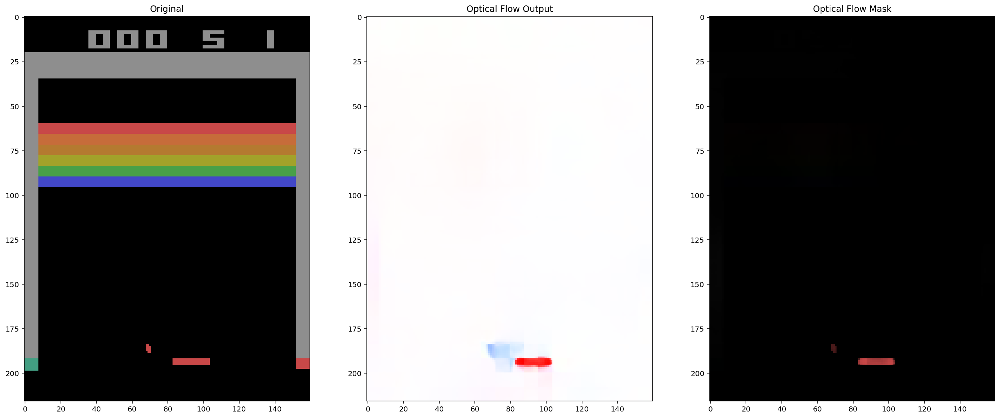

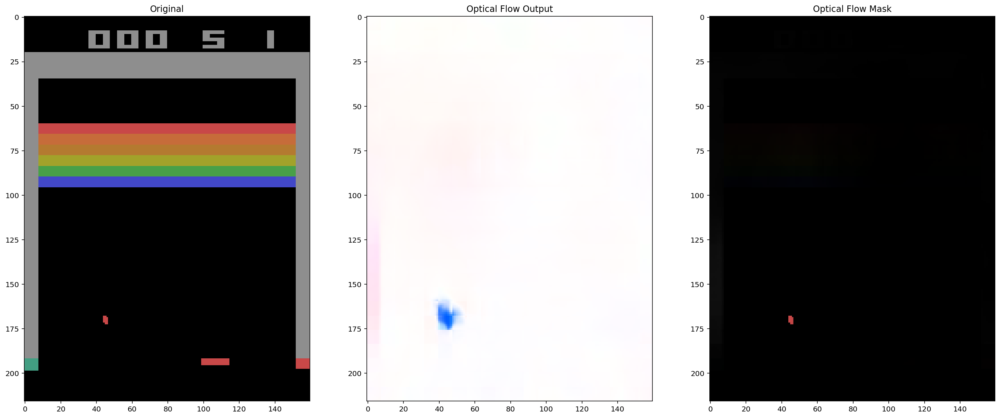

In [ ]:
plot_optical_flow_for_game(
    of_selected_game_frames_full, 
    of_games[0],
    raft_args,
    input_resolution,
    flow_output_types
    )

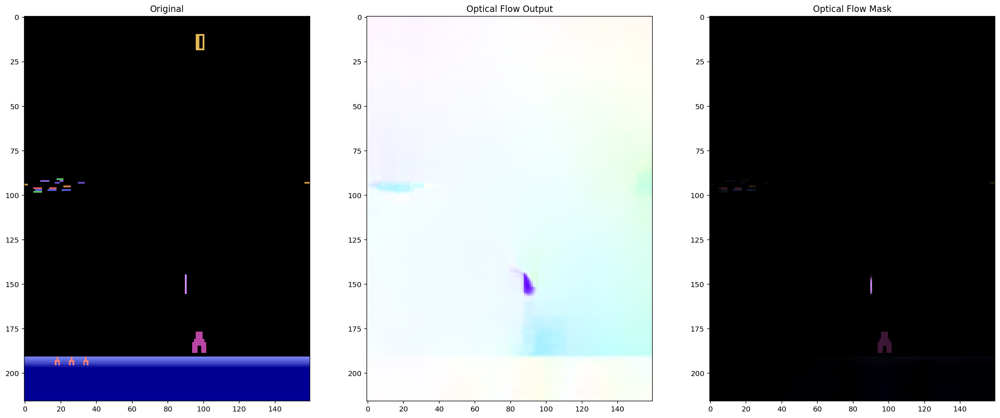

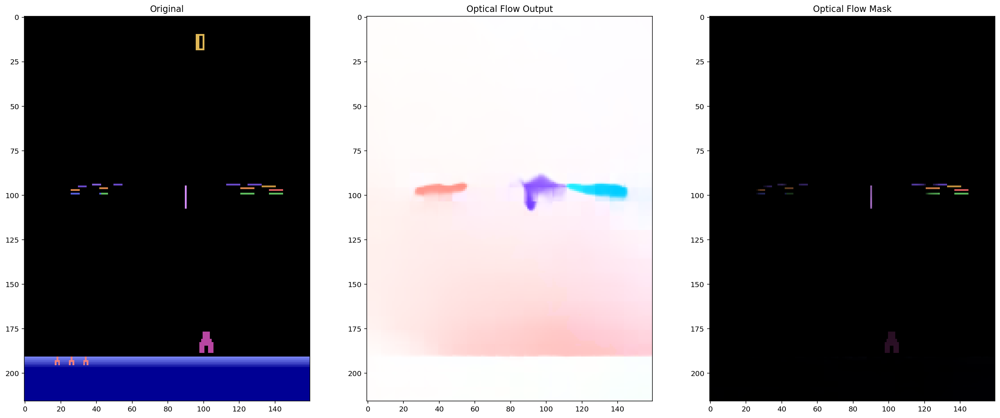

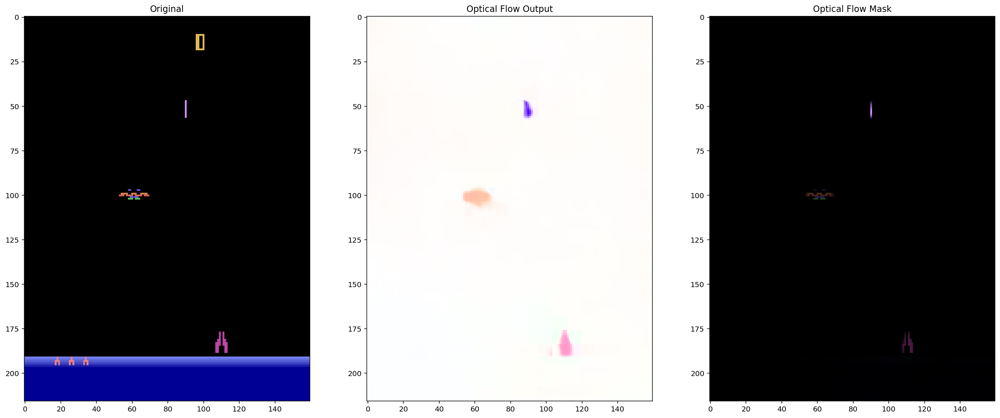

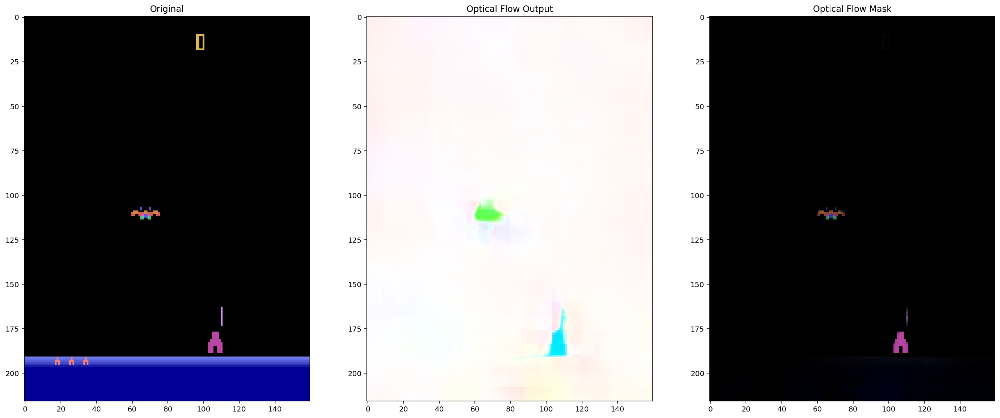

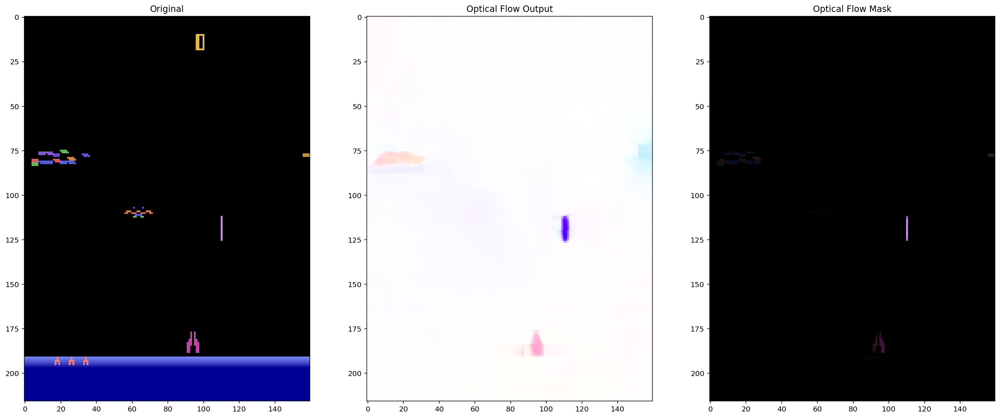

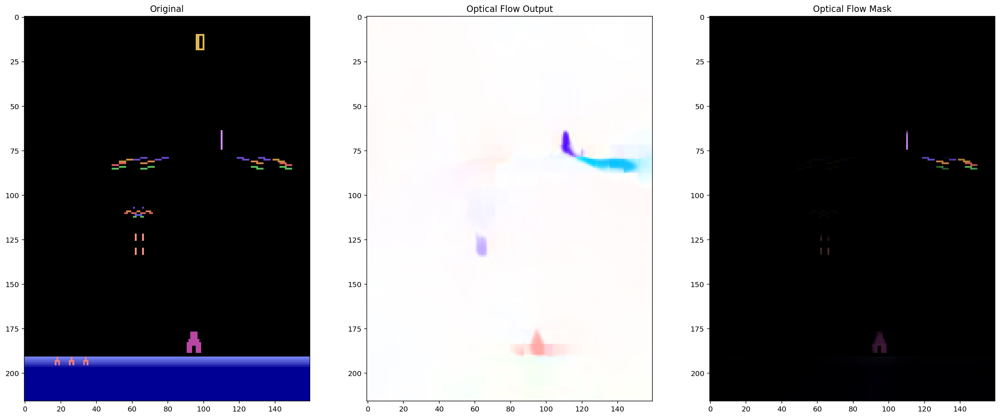

In [ ]:
plot_optical_flow_for_game(
    of_selected_game_frames_full, 
    of_games[1],
    raft_args,
    input_resolution,
    flow_output_types
    )

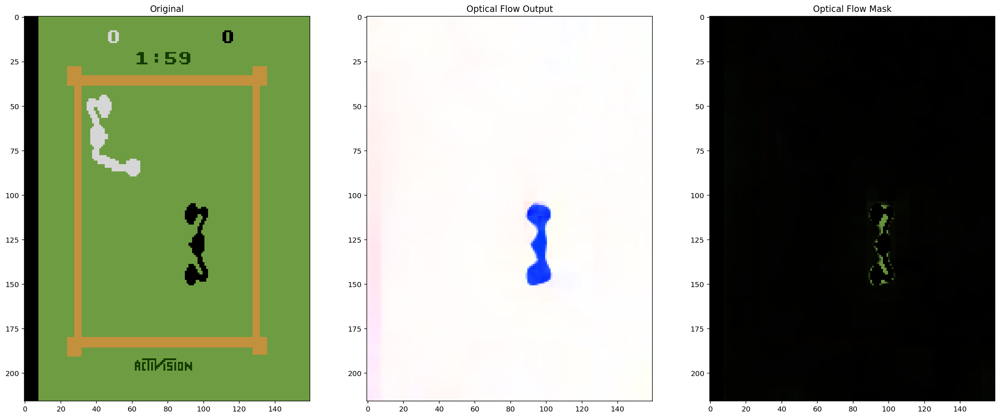

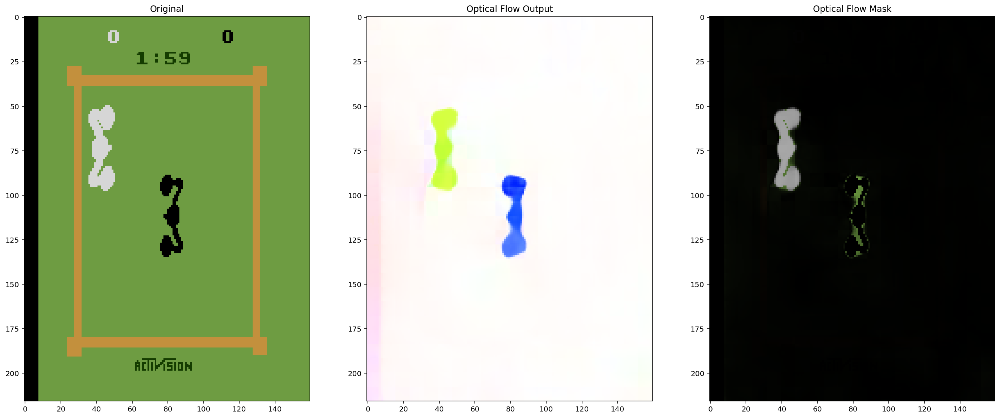

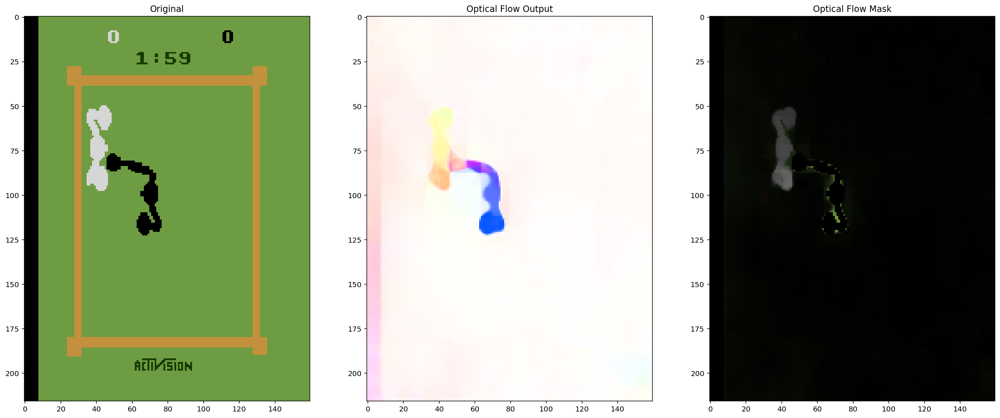

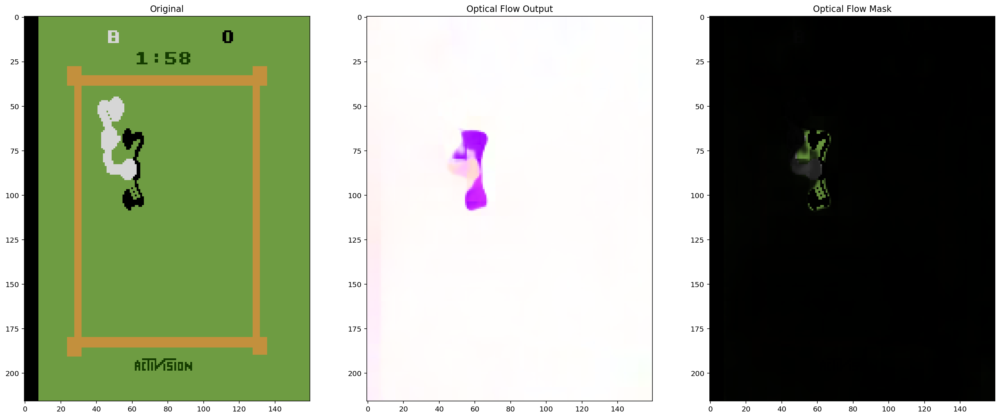

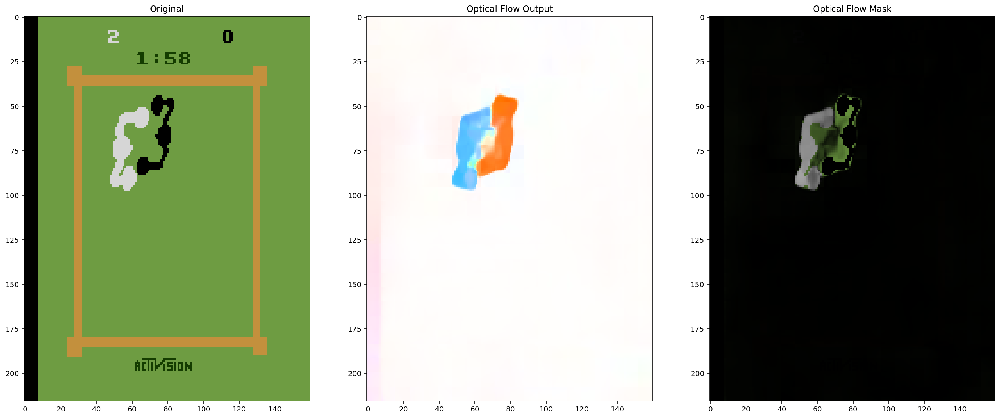

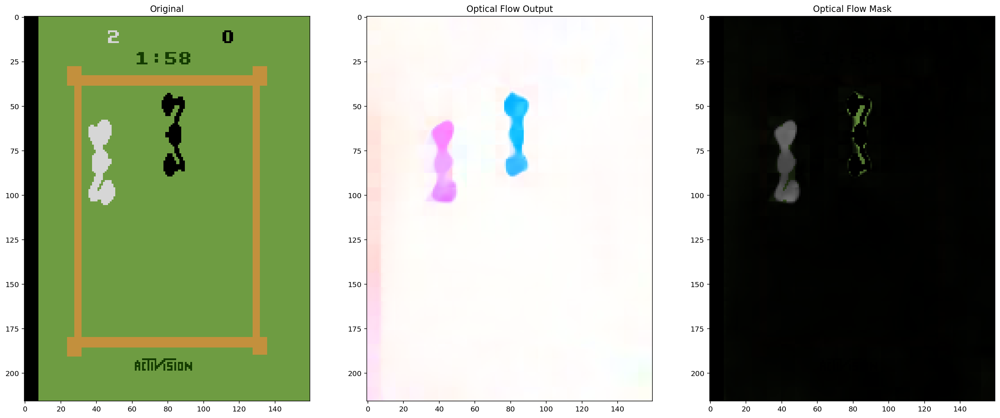

In [ ]:
plot_optical_flow_for_game(
    of_selected_game_frames_full, 
    of_games[2],
    raft_args,
    input_resolution,
    flow_output_types
    )

### 2x2 patches

In [ ]:
of_games = list(of_selected_game_frames_2x2patches.keys())

<Figure size 1152x864 with 0 Axes>

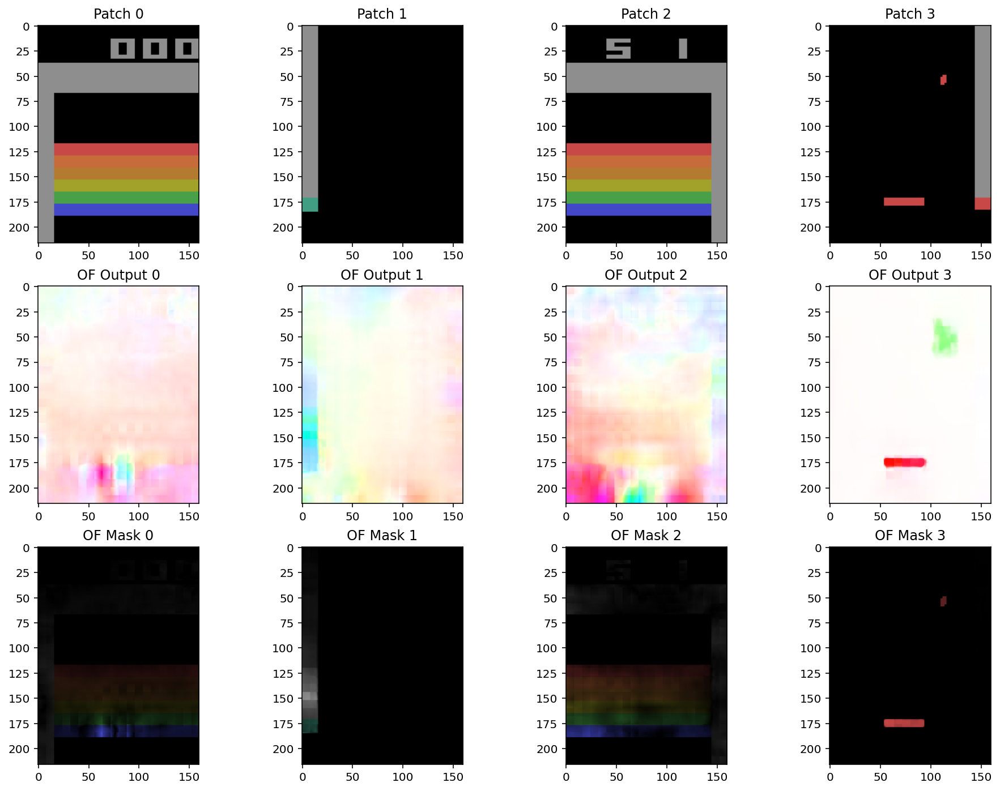

<Figure size 1152x864 with 0 Axes>

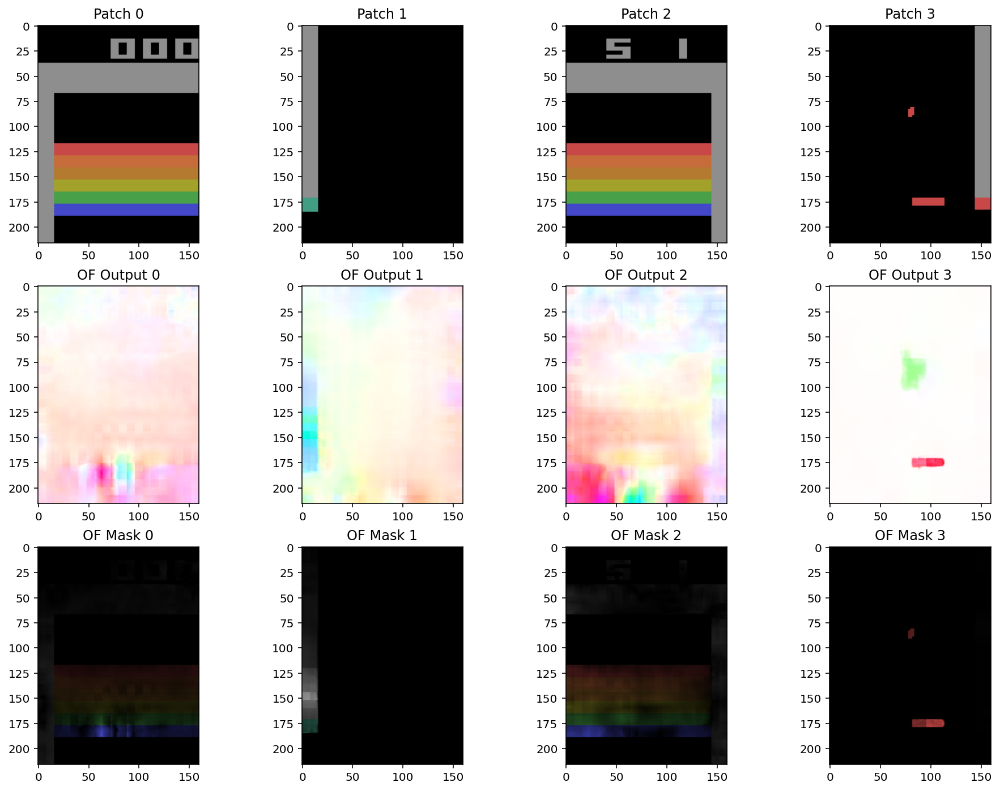

<Figure size 1152x864 with 0 Axes>

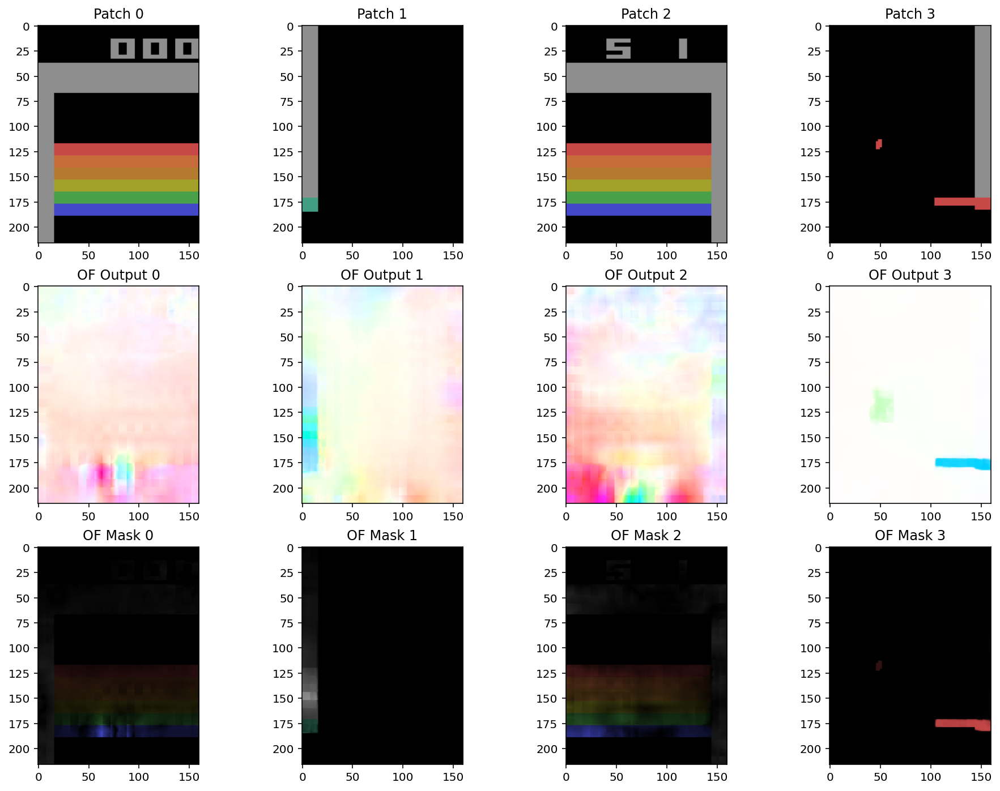

<Figure size 1152x864 with 0 Axes>

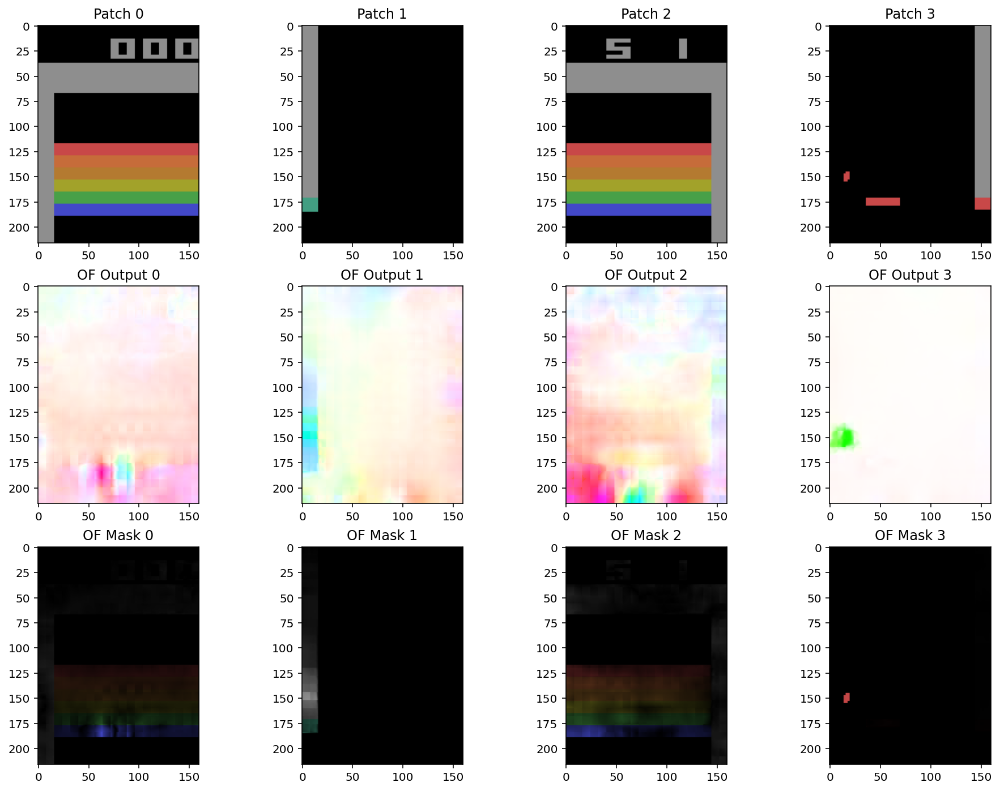

<Figure size 1152x864 with 0 Axes>

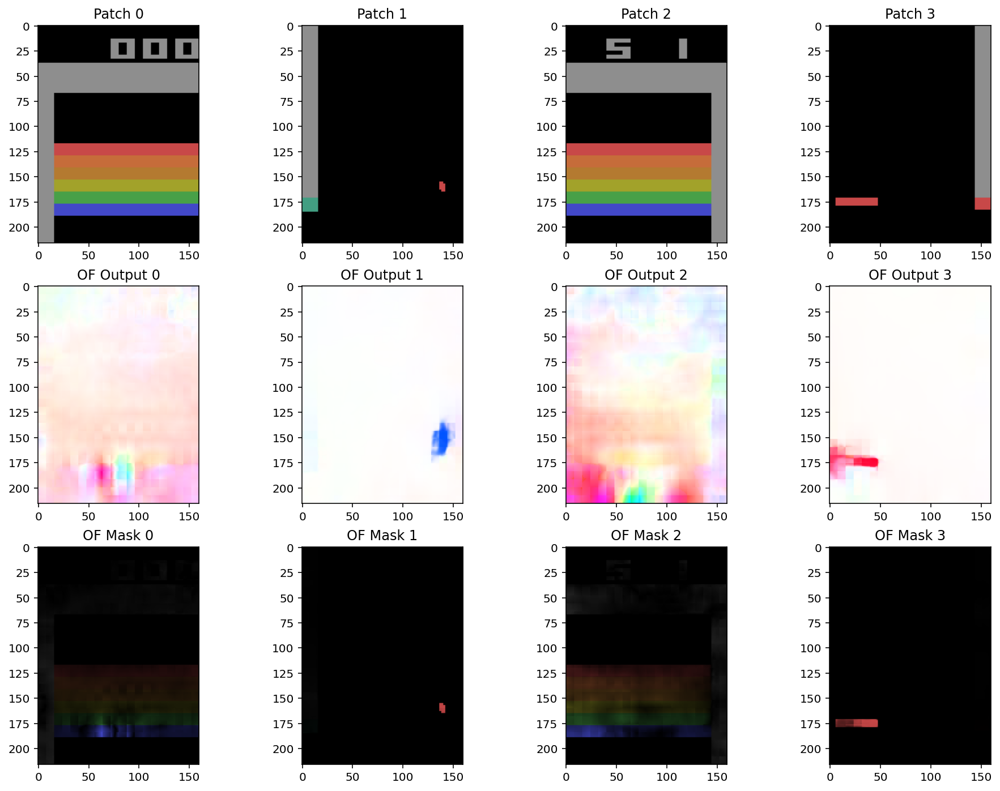

<Figure size 1152x864 with 0 Axes>

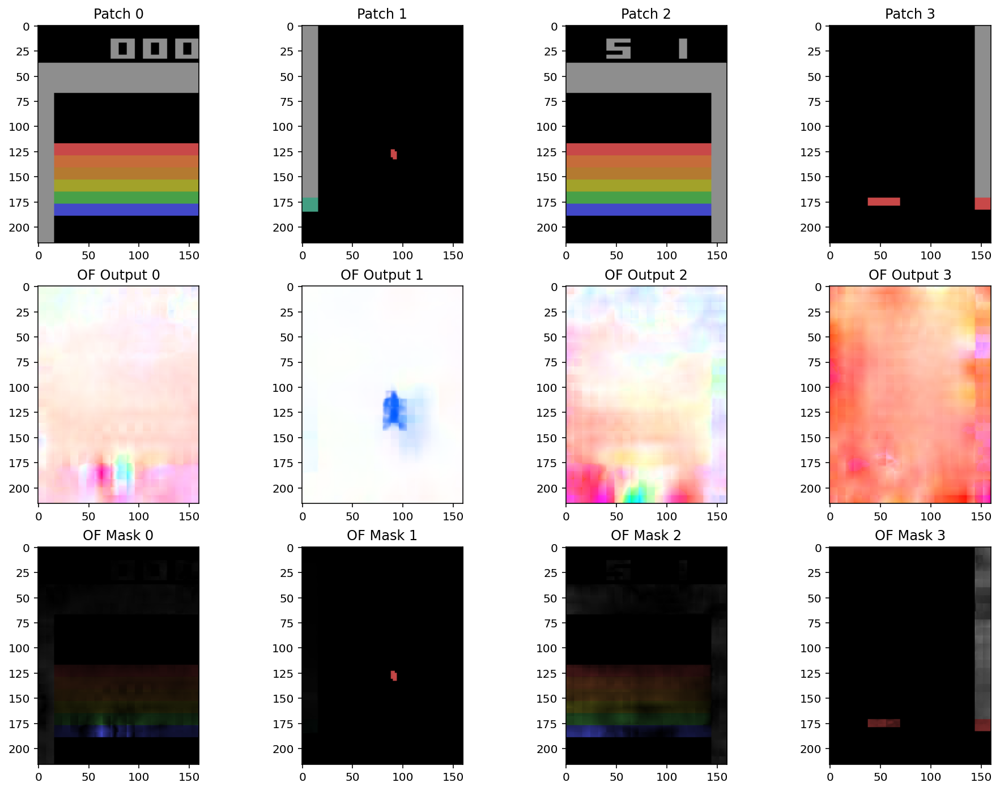

In [ ]:
plot_optical_flow_for_game(
    of_selected_game_frames_2x2patches, 
    of_games[0],
    raft_args,
    input_resolution1,
    flow_output_types
    )

<Figure size 1152x864 with 0 Axes>

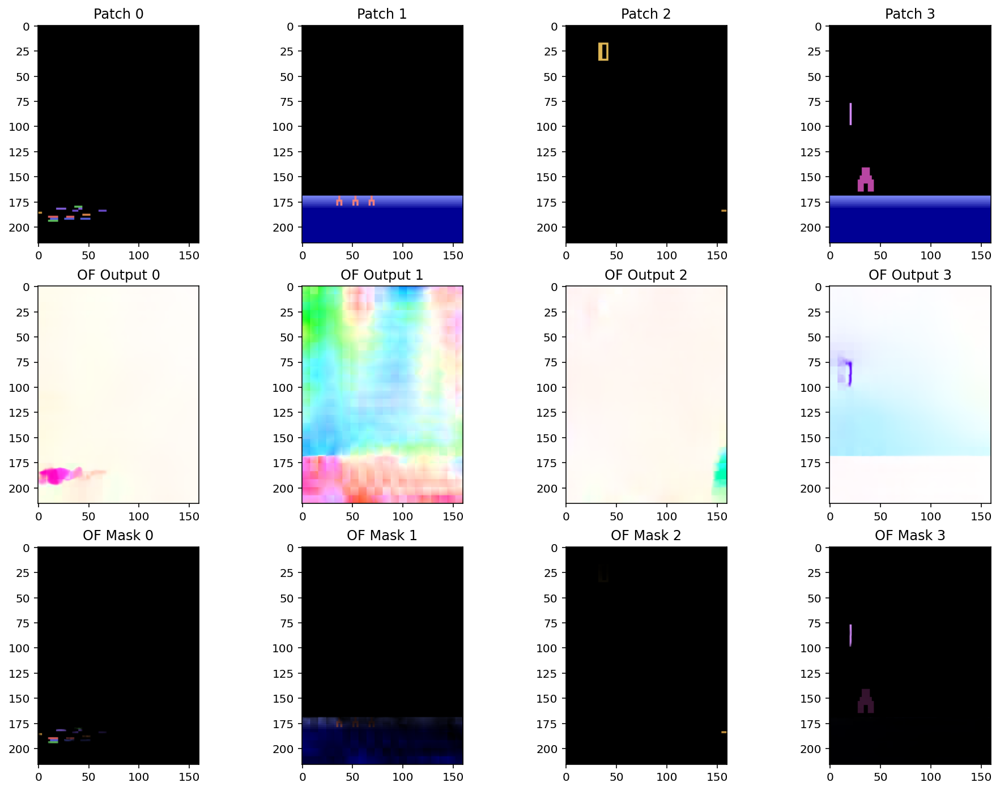

<Figure size 1152x864 with 0 Axes>

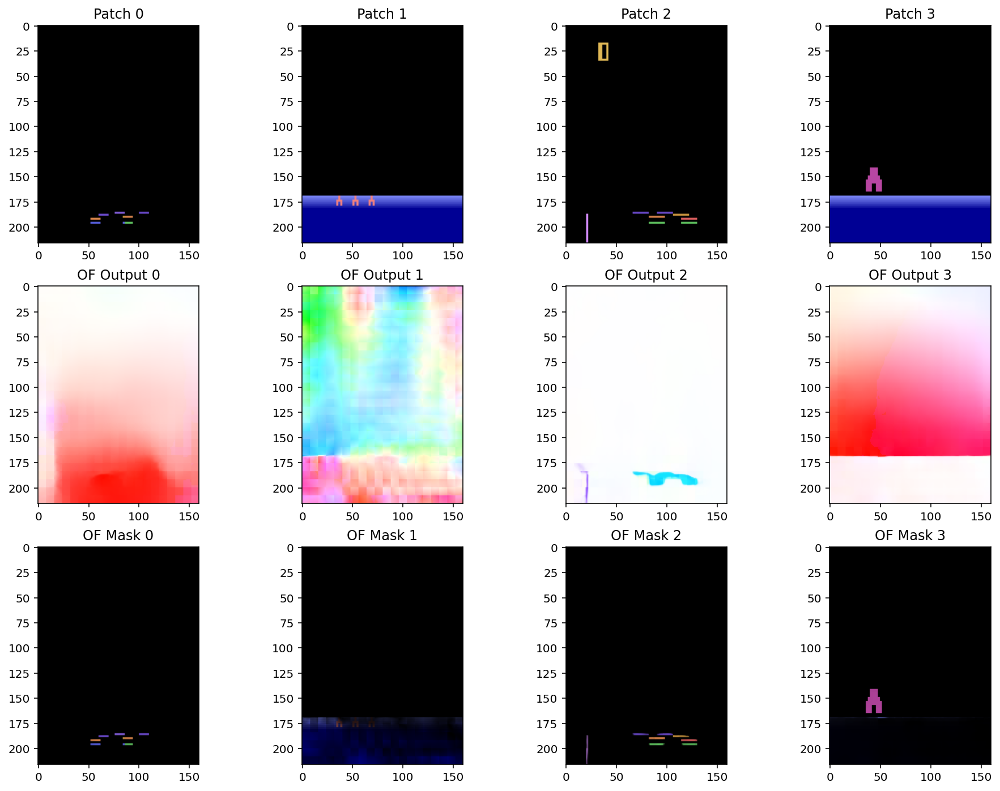

<Figure size 1152x864 with 0 Axes>

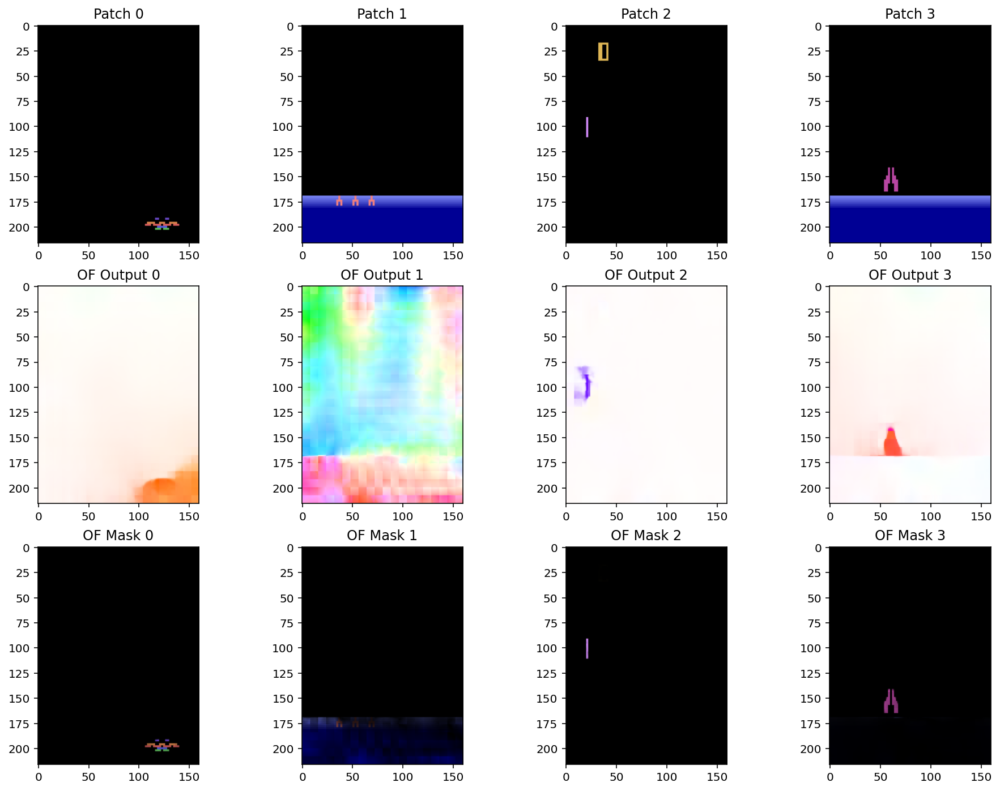

<Figure size 1152x864 with 0 Axes>

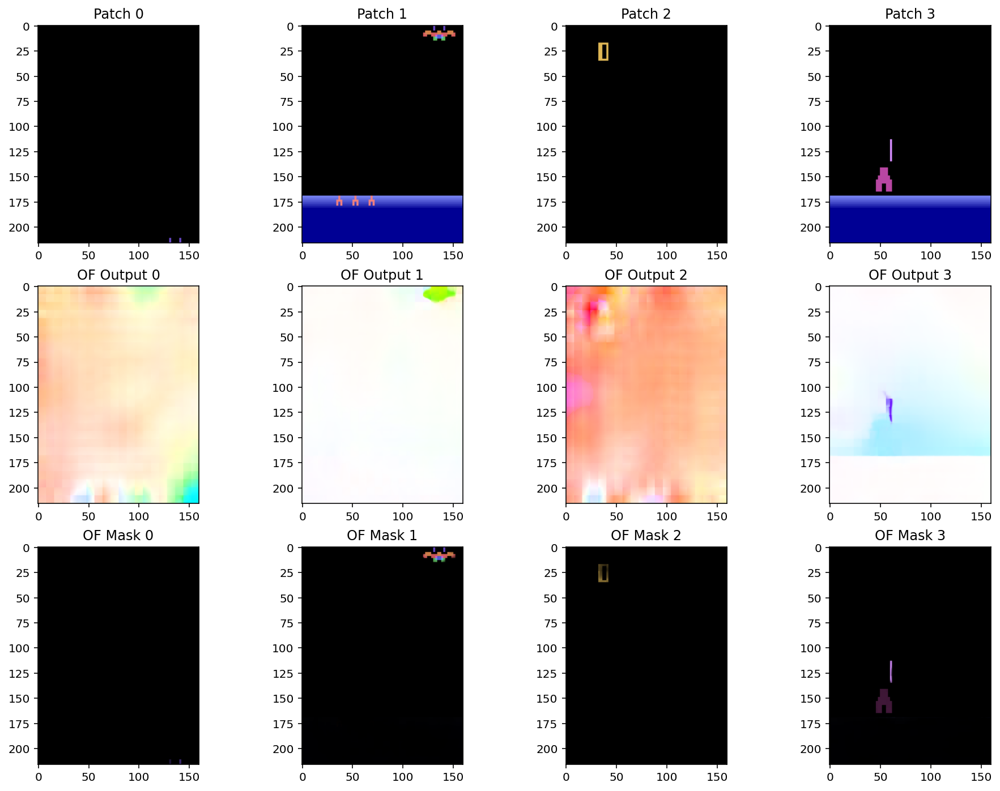

<Figure size 1152x864 with 0 Axes>

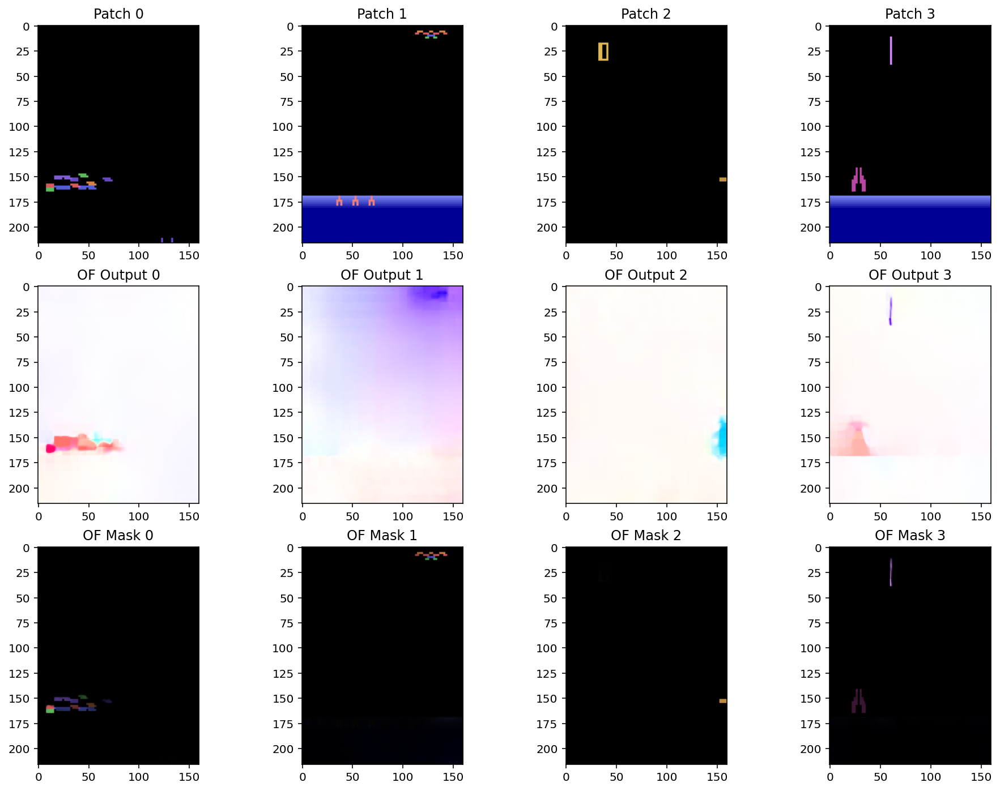

<Figure size 1152x864 with 0 Axes>

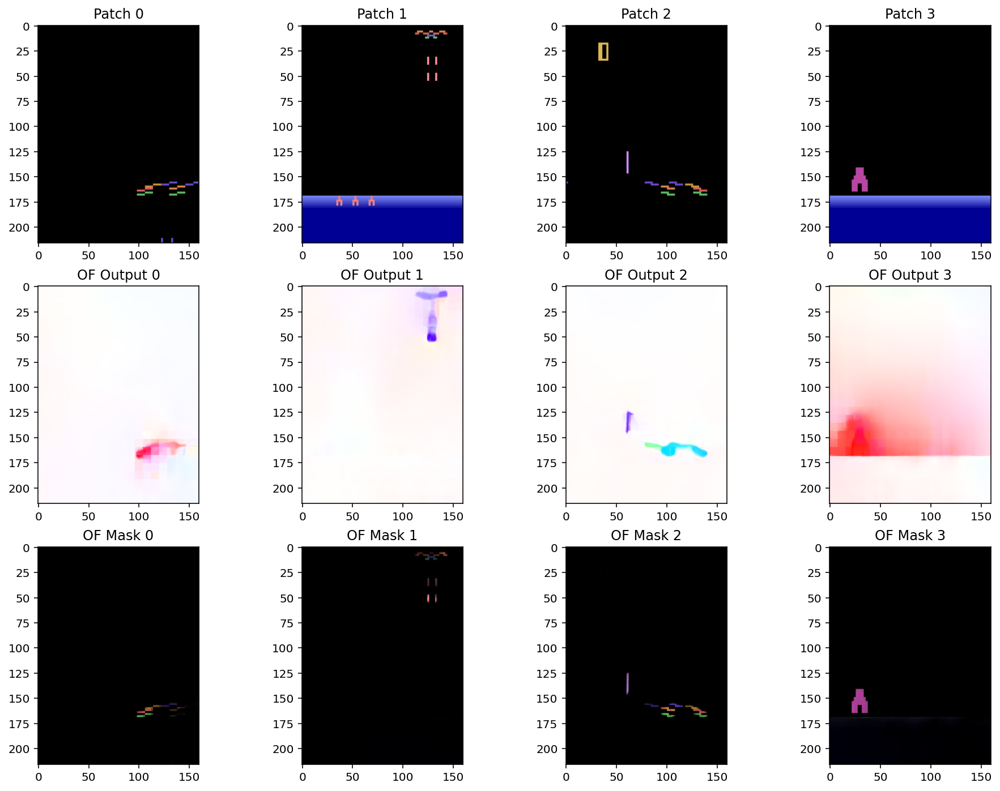

In [ ]:
plot_optical_flow_for_game(
    of_selected_game_frames_2x2patches, 
    of_games[1],
    raft_args,
    input_resolution1,
    flow_output_types
    )

<Figure size 1152x864 with 0 Axes>

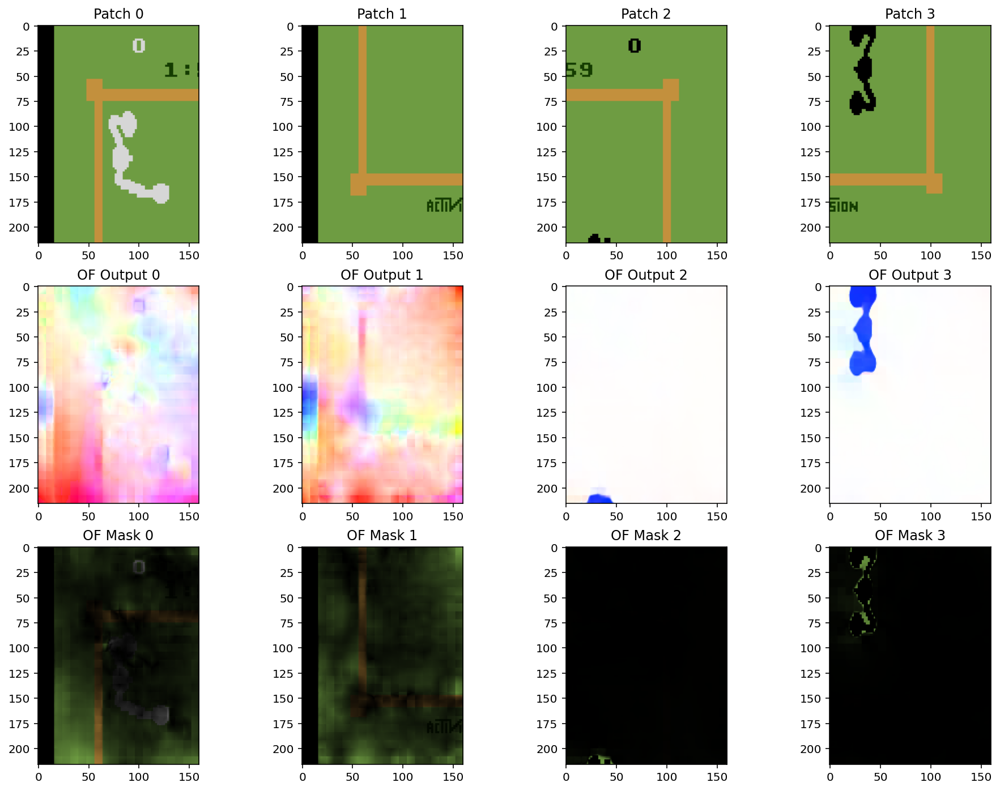

<Figure size 1152x864 with 0 Axes>

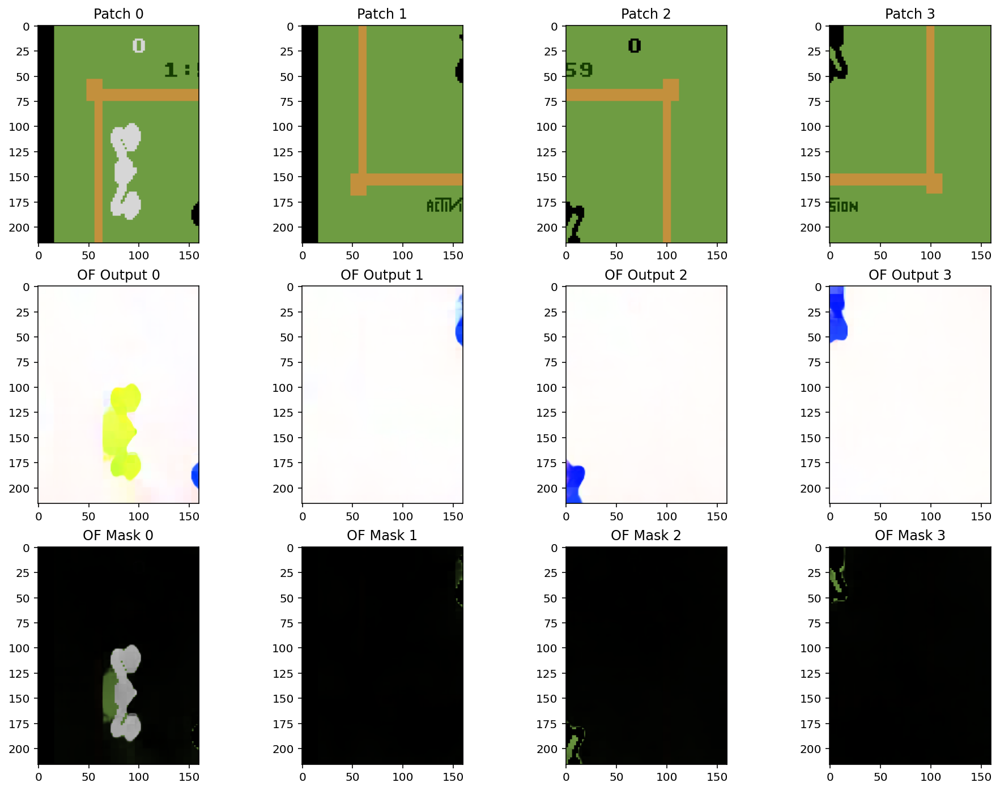

<Figure size 1152x864 with 0 Axes>

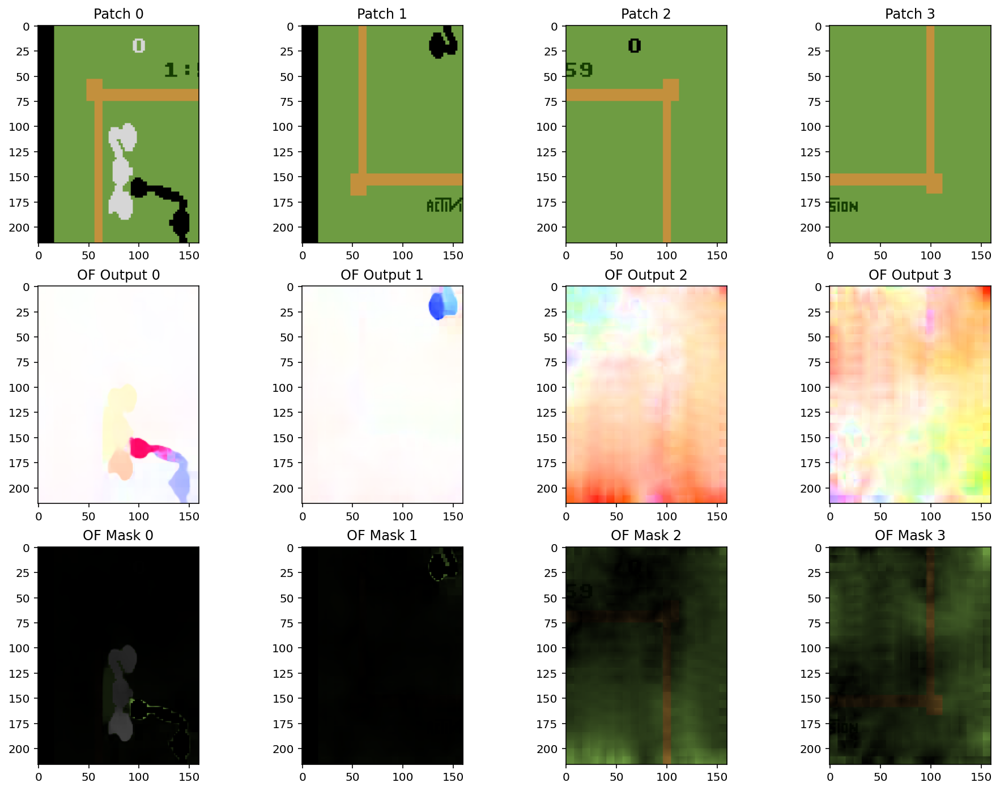

<Figure size 1152x864 with 0 Axes>

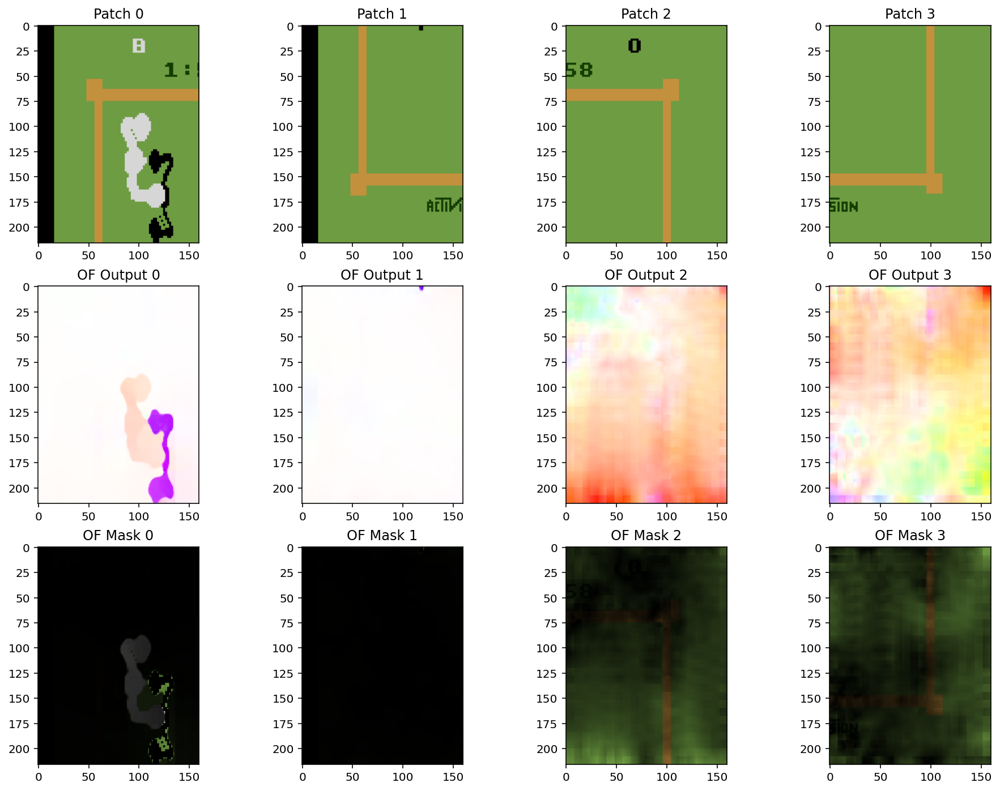

<Figure size 1152x864 with 0 Axes>

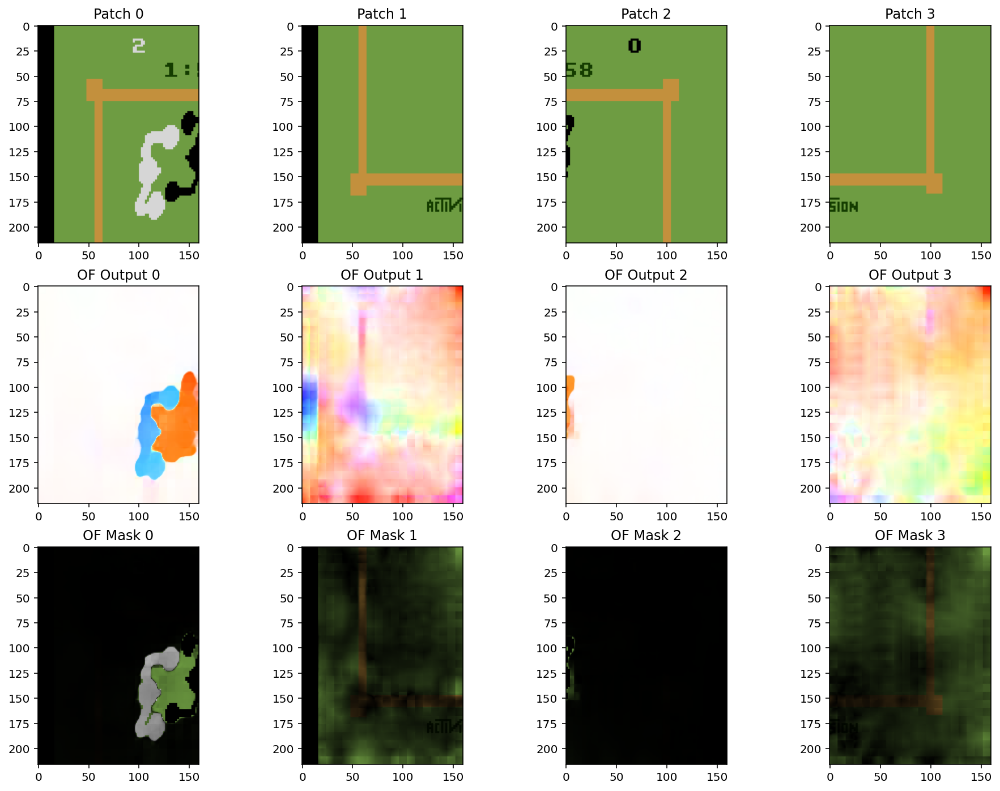

<Figure size 1152x864 with 0 Axes>

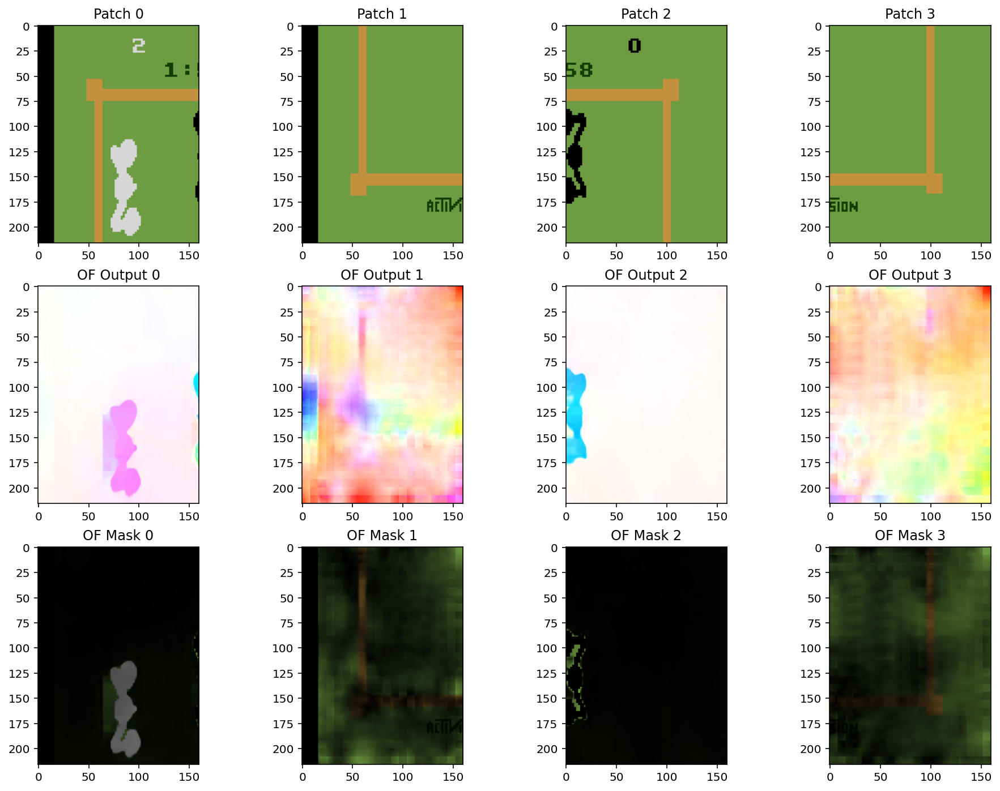

In [ ]:
plot_optical_flow_for_game(
    of_selected_game_frames_2x2patches, 
    of_games[2],
    raft_args,
    input_resolution1,
    flow_output_types
    )

### 4x4 patches

In [ ]:
of_games = list(of_selected_game_frames_4x4patches.keys())

<Figure size 2304x360 with 0 Axes>

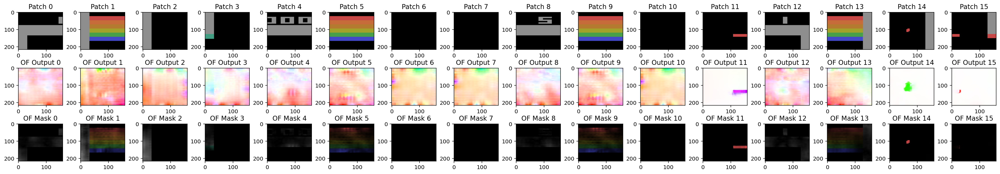

<Figure size 2304x360 with 0 Axes>

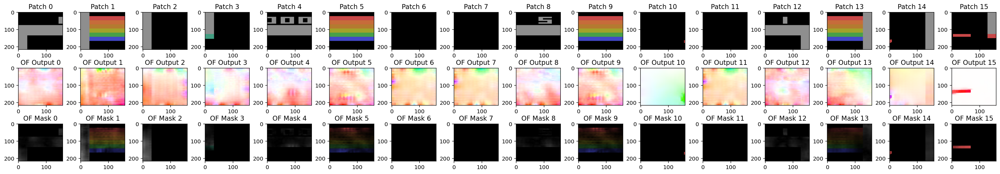

<Figure size 2304x360 with 0 Axes>

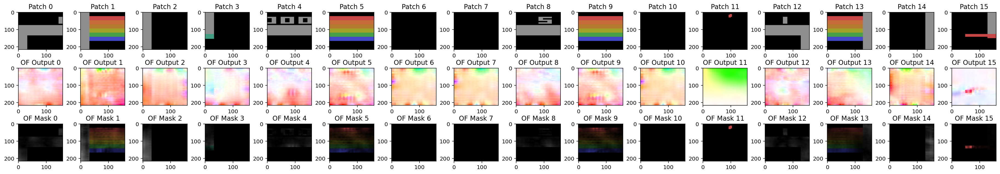

<Figure size 2304x360 with 0 Axes>

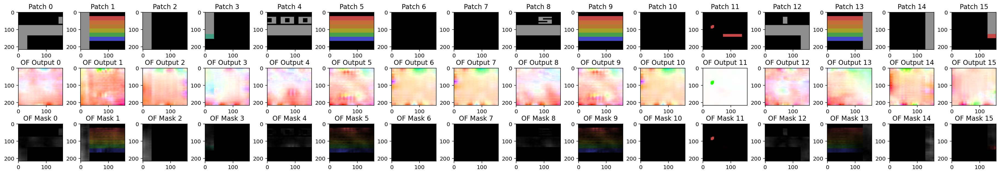

<Figure size 2304x360 with 0 Axes>

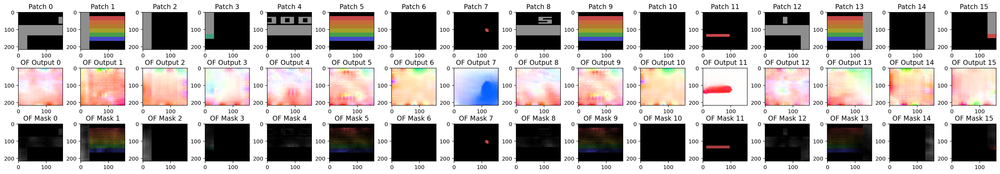

<Figure size 2304x360 with 0 Axes>

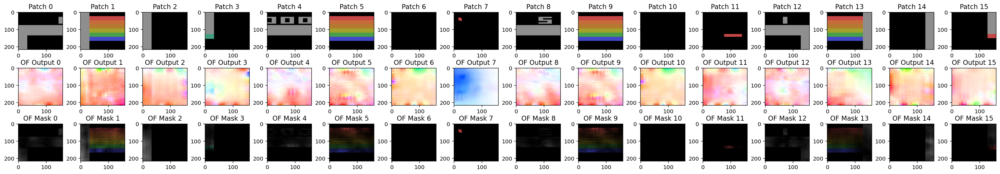

In [ ]:
plot_optical_flow_for_game(
    of_selected_game_frames_4x4patches, 
    of_games[0],
    raft_args,
    input_resolution2,
    flow_output_types
    )

<Figure size 2304x360 with 0 Axes>

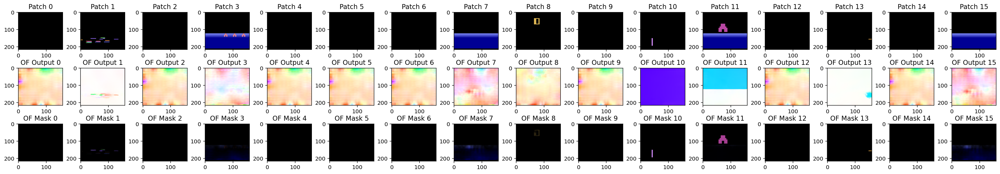

<Figure size 2304x360 with 0 Axes>

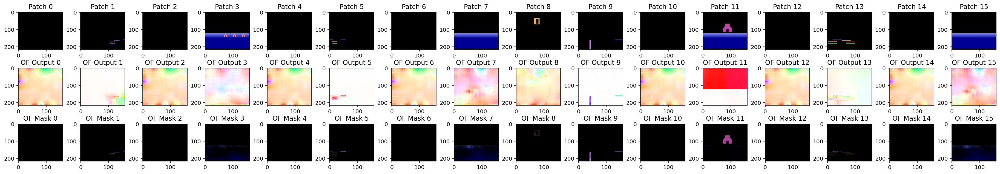

<Figure size 2304x360 with 0 Axes>

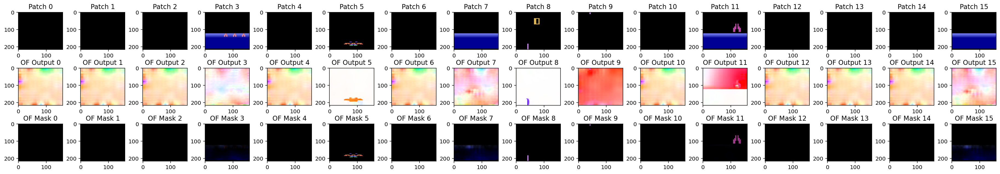

<Figure size 2304x360 with 0 Axes>

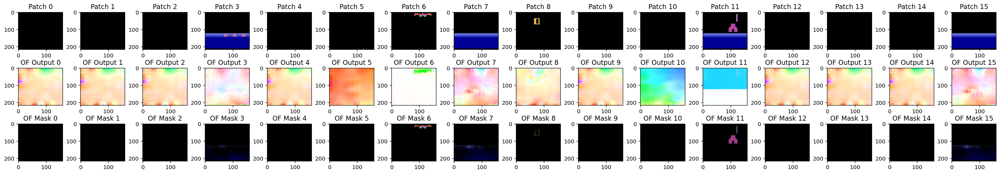

<Figure size 2304x360 with 0 Axes>

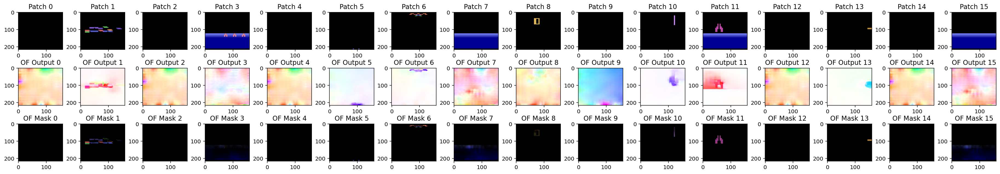

<Figure size 2304x360 with 0 Axes>

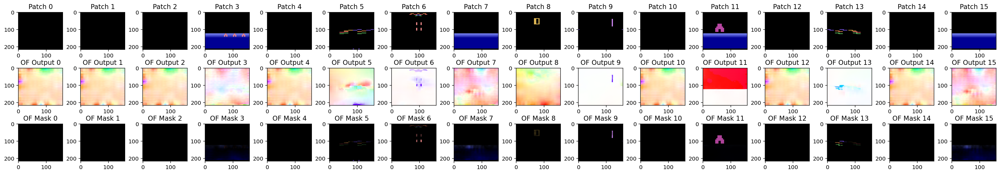

In [ ]:
plot_optical_flow_for_game(
    of_selected_game_frames_4x4patches, 
    of_games[1],
    raft_args,
    input_resolution2,
    flow_output_types
    )

<Figure size 2304x360 with 0 Axes>

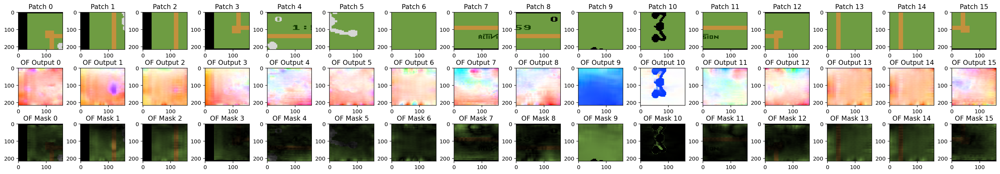

<Figure size 2304x360 with 0 Axes>

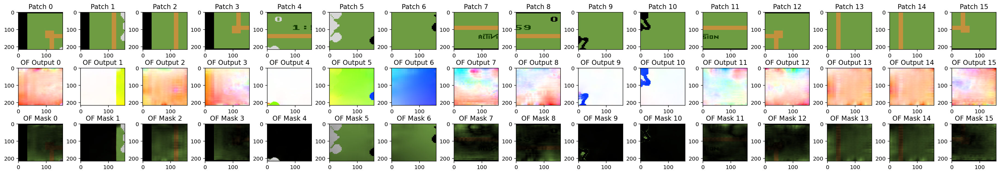

<Figure size 2304x360 with 0 Axes>

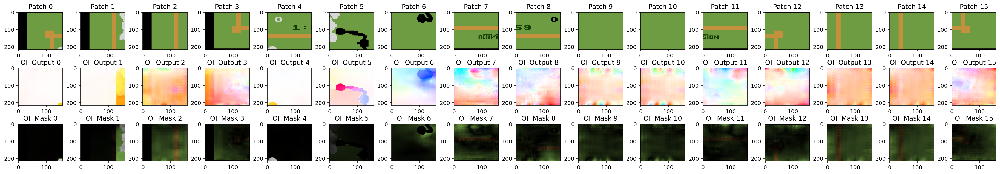

<Figure size 2304x360 with 0 Axes>

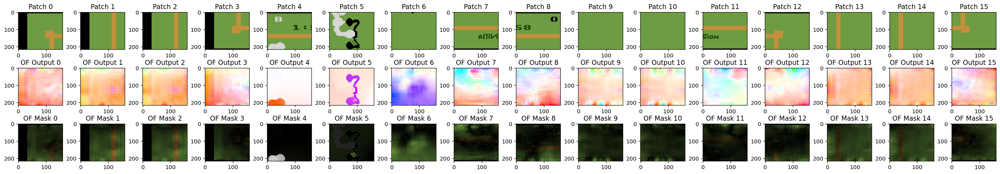

<Figure size 2304x360 with 0 Axes>

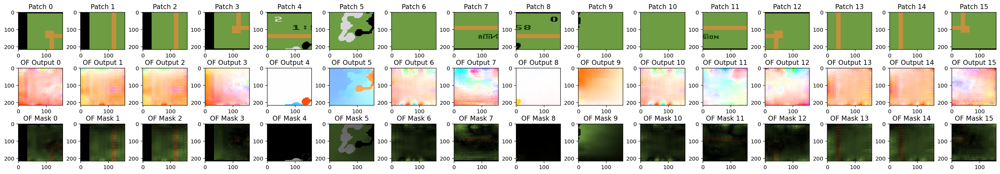

<Figure size 2304x360 with 0 Axes>

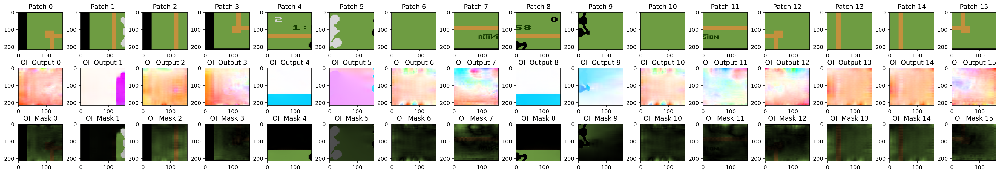

In [ ]:
plot_optical_flow_for_game(
    of_selected_game_frames_4x4patches, 
    of_games[2],
    raft_args,
    input_resolution2,
    flow_output_types
    )

# Viz3 : Dino, efficientDet and image diff


In [ ]:
selected_game_frames_full = torch.load("all_imges")

In [ ]:
games = list(selected_game_frames_full.keys())

## Image diff

In [ ]:
from skimage.metrics import structural_similarity as ssim
import argparse
import imutils
import cv2
from google.colab.patches import cv2_imshow

In [ ]:
def image_diff(img1,img2, img1_nop):
  # load the two input images
  imageA = img1
  imageB = img2
  # convert the images to grayscale
  grayA = cv2.cvtColor(imageA, cv2.COLOR_RGB2GRAY)
  grayB = cv2.cvtColor(imageB, cv2.COLOR_RGB2GRAY)

  # compute the Structural Similarity Index (SSIM) between the two
  # images, ensuring that the difference image is returned
  (score, diff) = ssim(grayA, grayB, full=True)
  diff = (diff*255).astype("uint8")

  # threshold the difference image, followed by finding contours to
  # obtain the regions of the two input images that differ
  thresh = cv2.threshold(diff, 0, 1,
    cv2.THRESH_BINARY_INV | cv2.THRESH_OTSU)[1]
  cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL,
    cv2.CHAIN_APPROX_SIMPLE)
  cnts = imutils.grab_contours(cnts)

  maskkkkk = np.zeros((210,160), dtype="uint8")

  # loop over the contours
  for c in cnts:
    (x, y, w, h) = cv2.boundingRect(c)
    cv2.rectangle(maskkkkk, (x, y), (x + w, y + h), 1, -1)

  new_list = [maskkkkk,maskkkkk,maskkkkk]
  stacked_thresh = np.stack(new_list)
  final_masked = torch.from_numpy(stacked_thresh * img1_nop)

  if score == 1:
    final_masked = torch.from_numpy(img1_nop)

  plt.figure()
  fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 16))
  ax1.set_title('Original')
  ax2.set_title('Image Diff')
  _ = ax1.imshow(img1)
  _ = ax2.imshow(final_masked.permute(1,2,0).numpy())

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:36: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<Figure size 432x288 with 0 Axes>

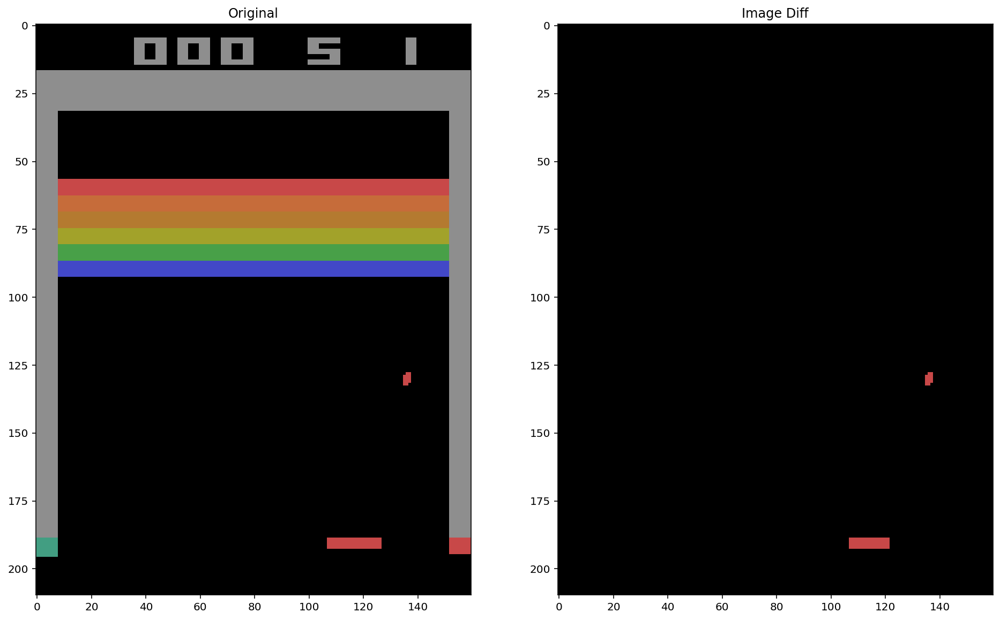

<Figure size 432x288 with 0 Axes>

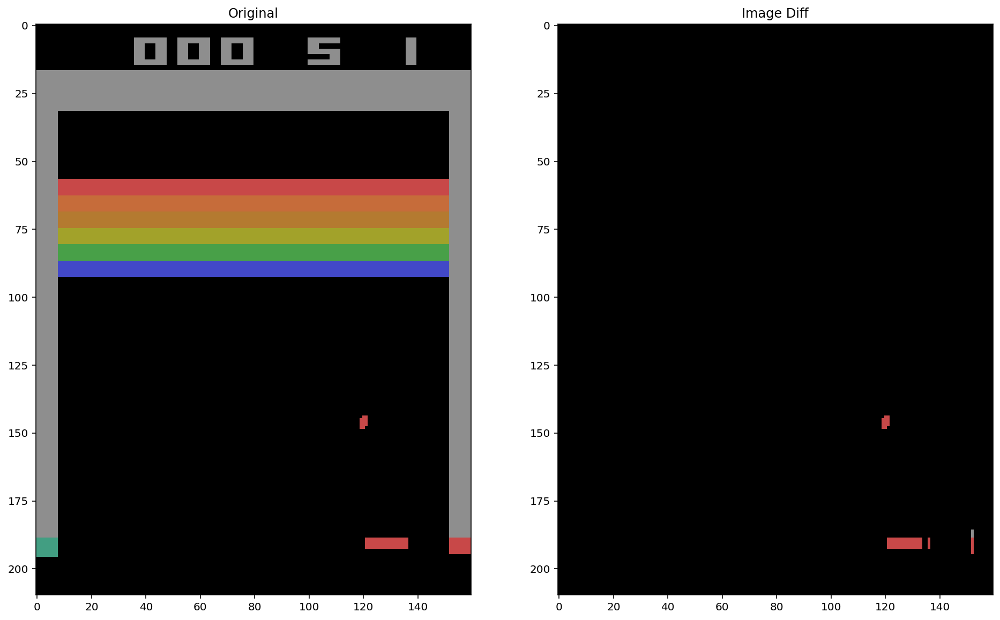

<Figure size 432x288 with 0 Axes>

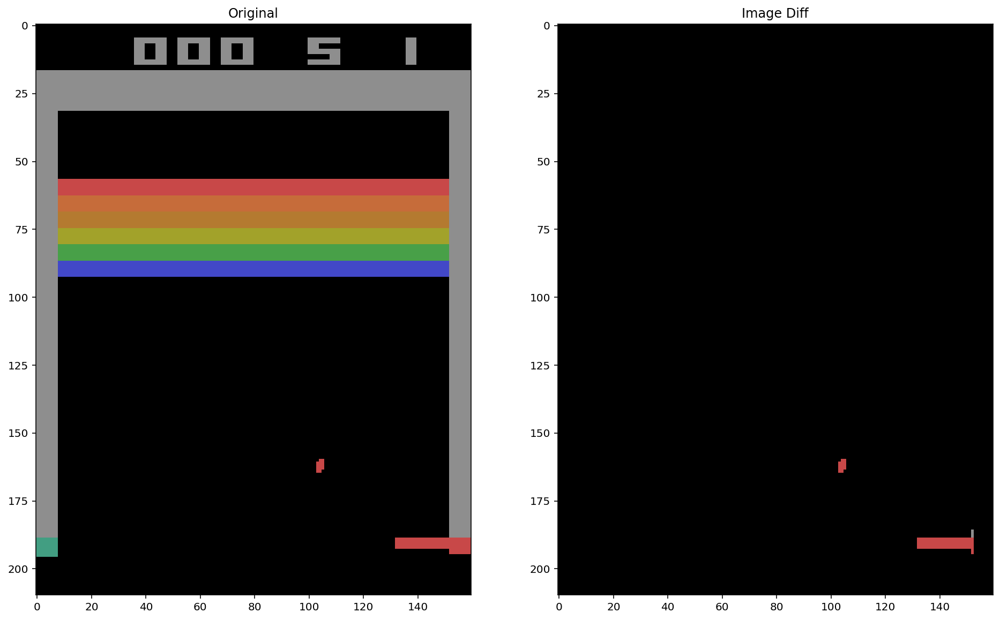

<Figure size 432x288 with 0 Axes>

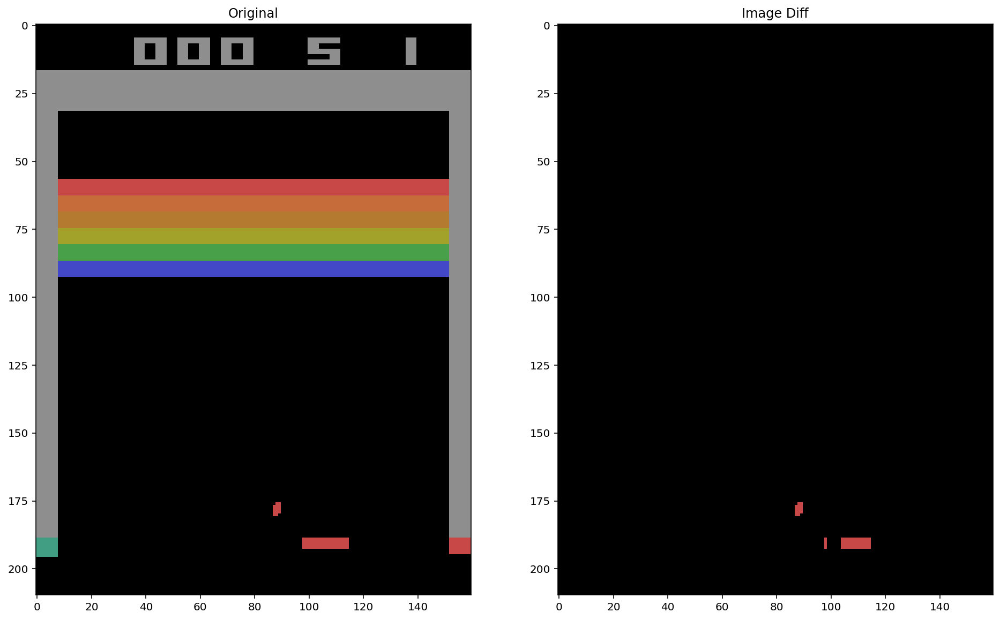

<Figure size 432x288 with 0 Axes>

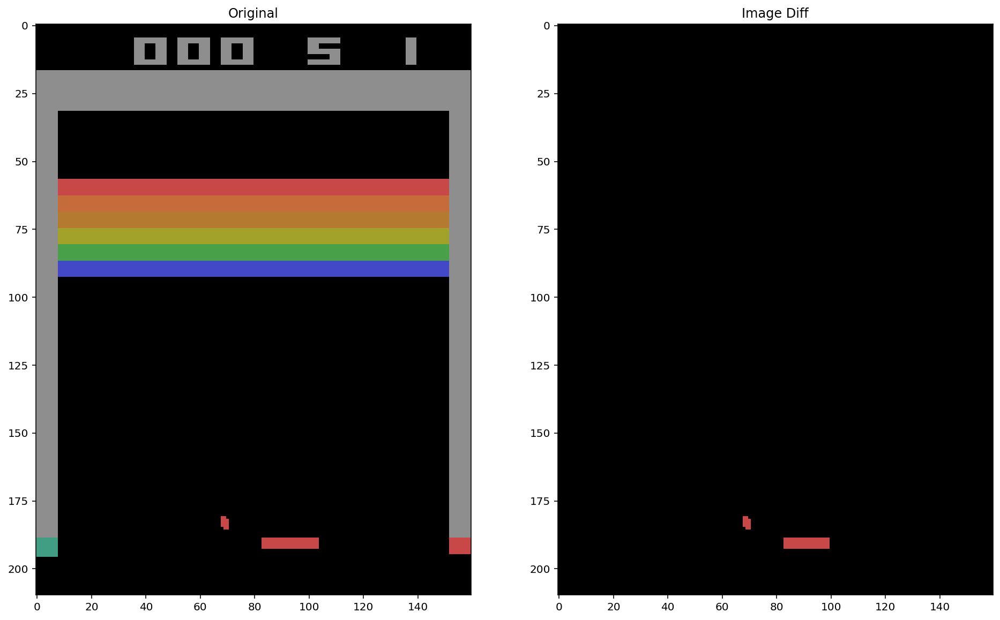

<Figure size 432x288 with 0 Axes>

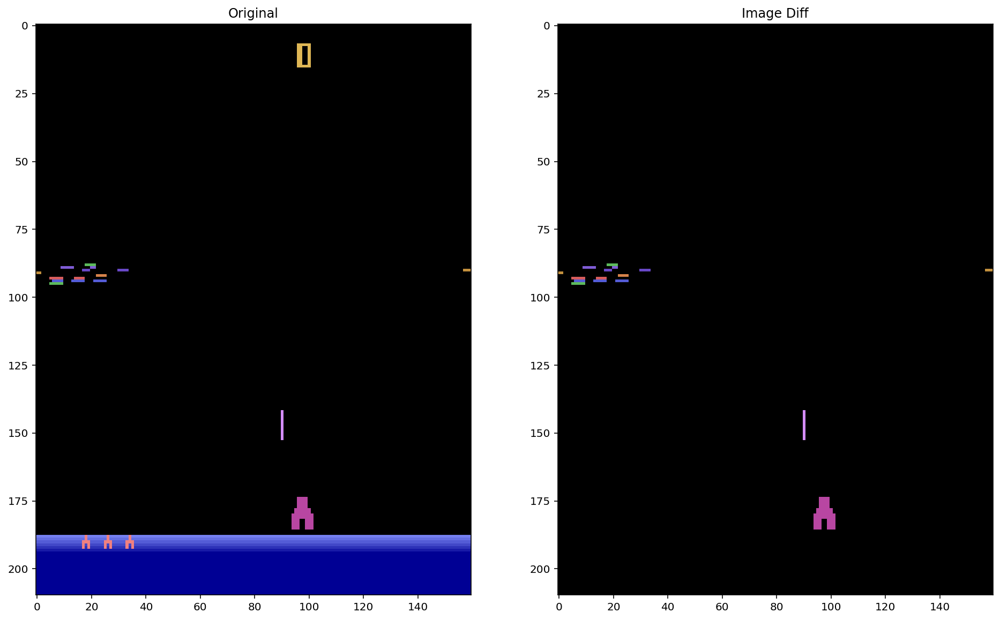

<Figure size 432x288 with 0 Axes>

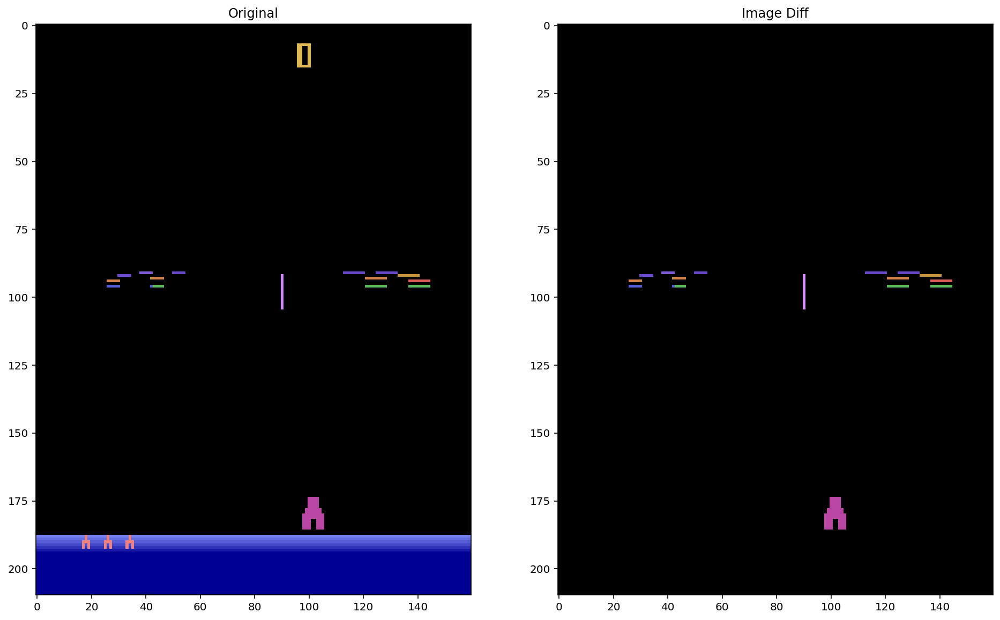

<Figure size 432x288 with 0 Axes>

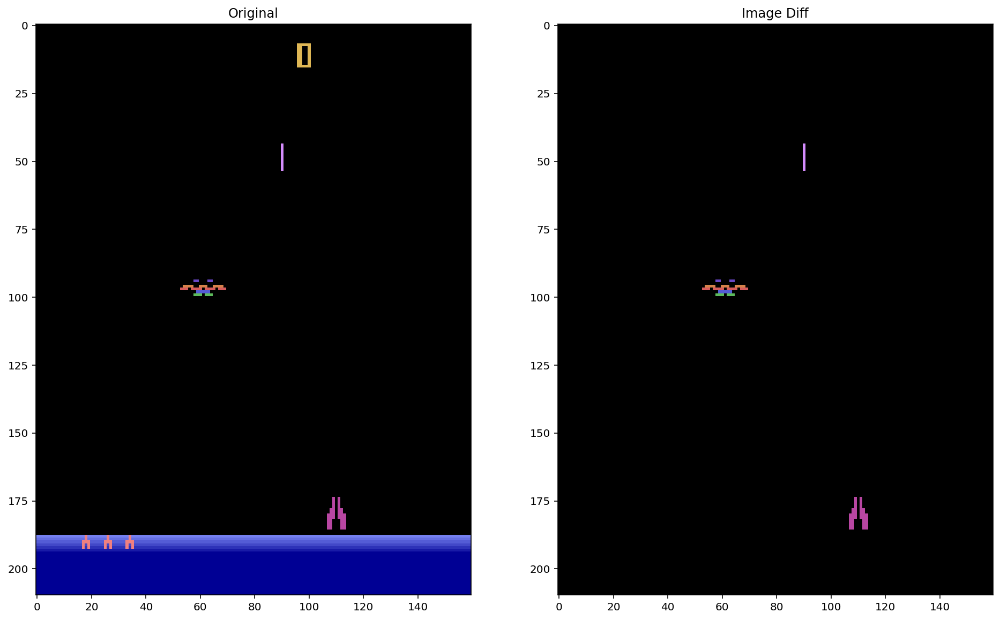

<Figure size 432x288 with 0 Axes>

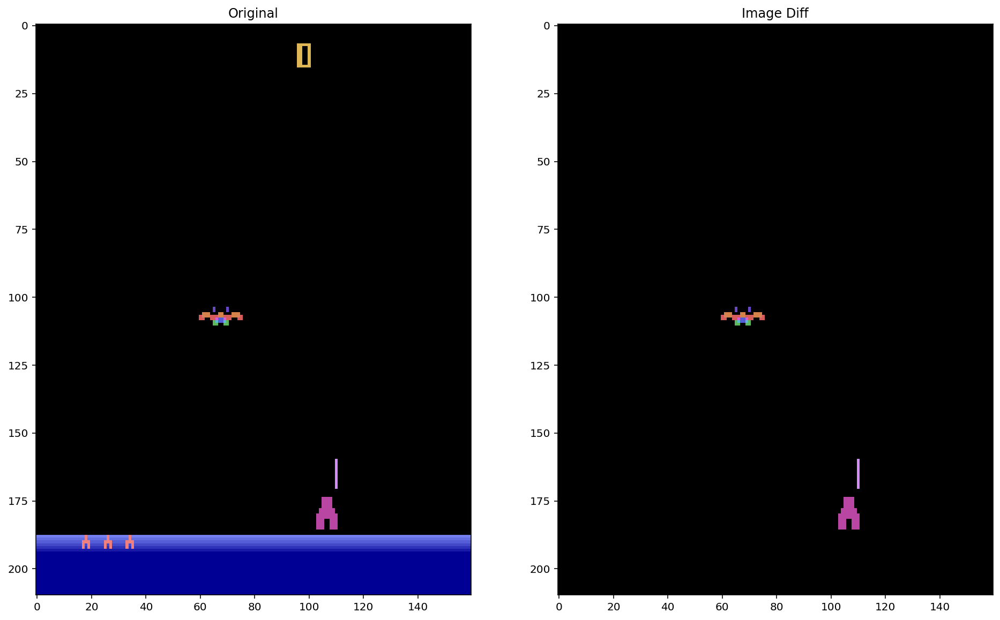

<Figure size 432x288 with 0 Axes>

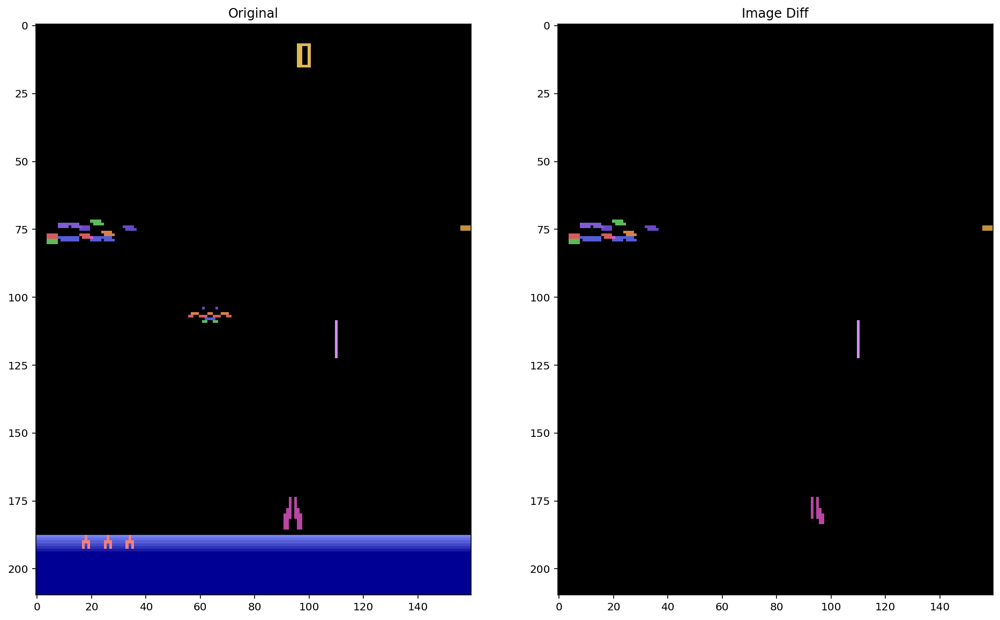

<Figure size 432x288 with 0 Axes>

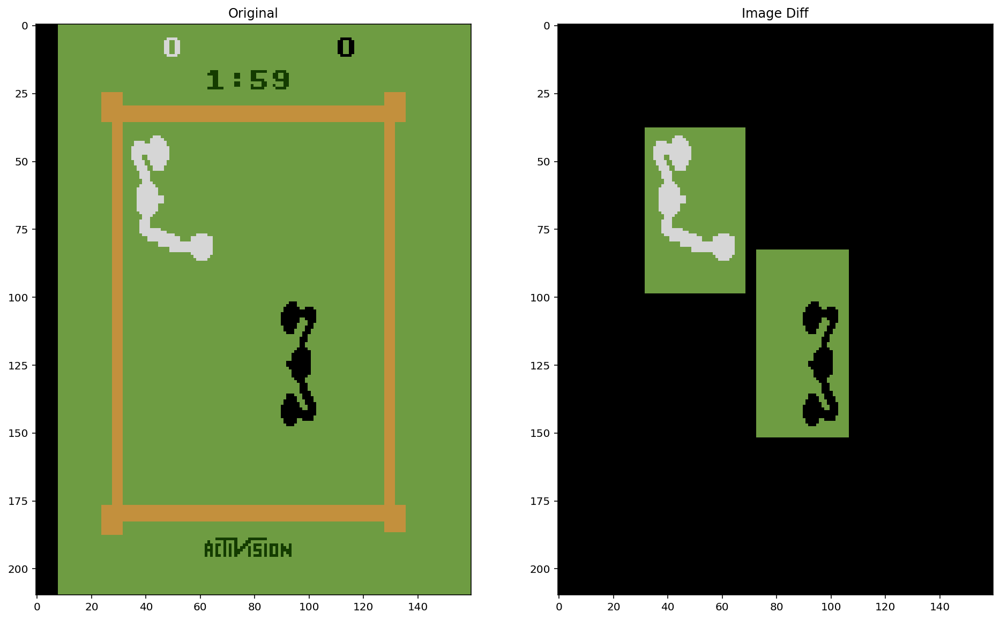

<Figure size 432x288 with 0 Axes>

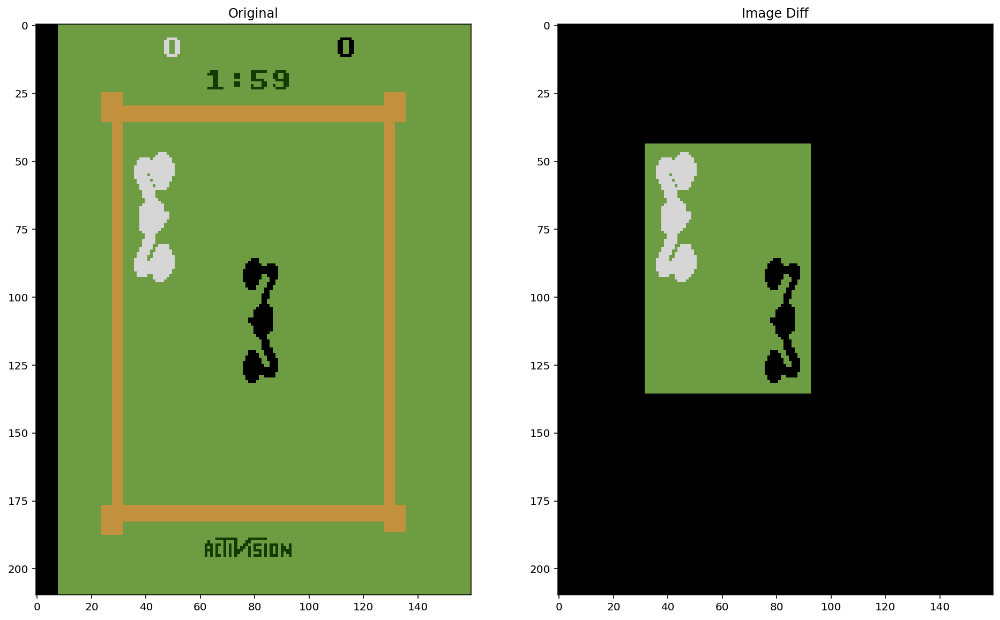

<Figure size 432x288 with 0 Axes>

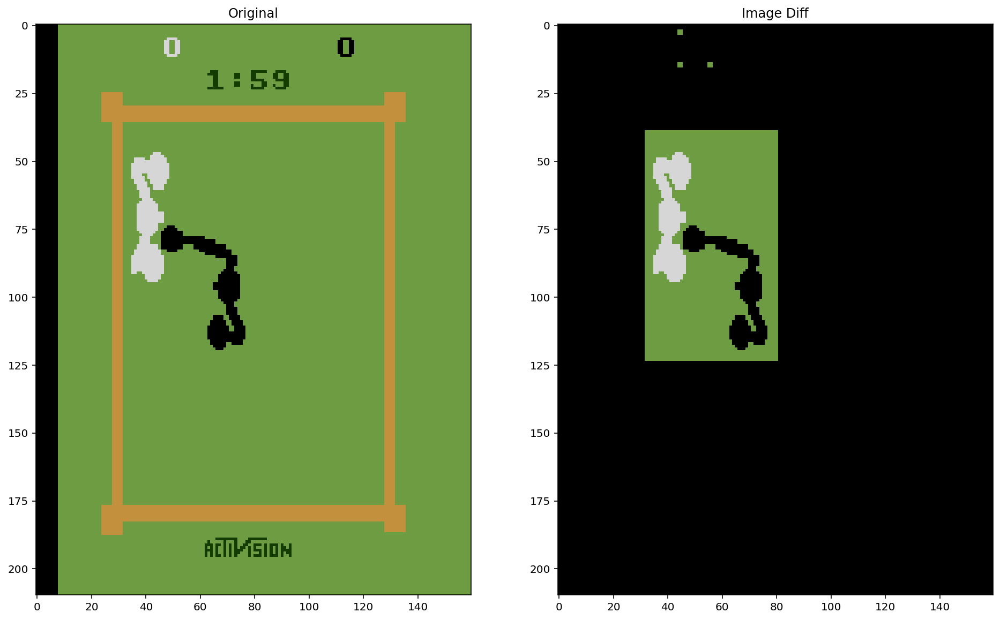

<Figure size 432x288 with 0 Axes>

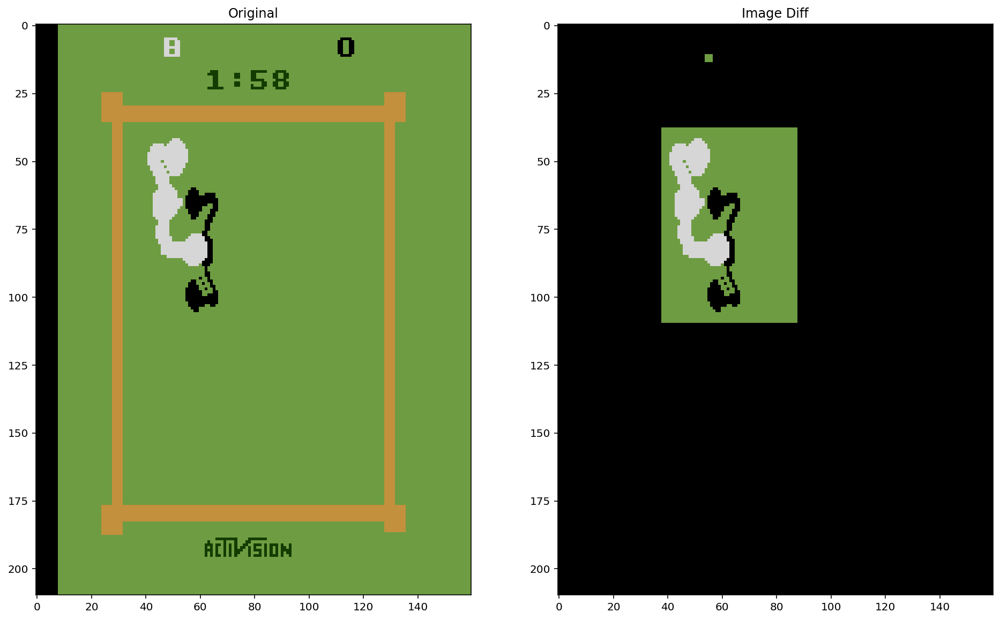

<Figure size 432x288 with 0 Axes>

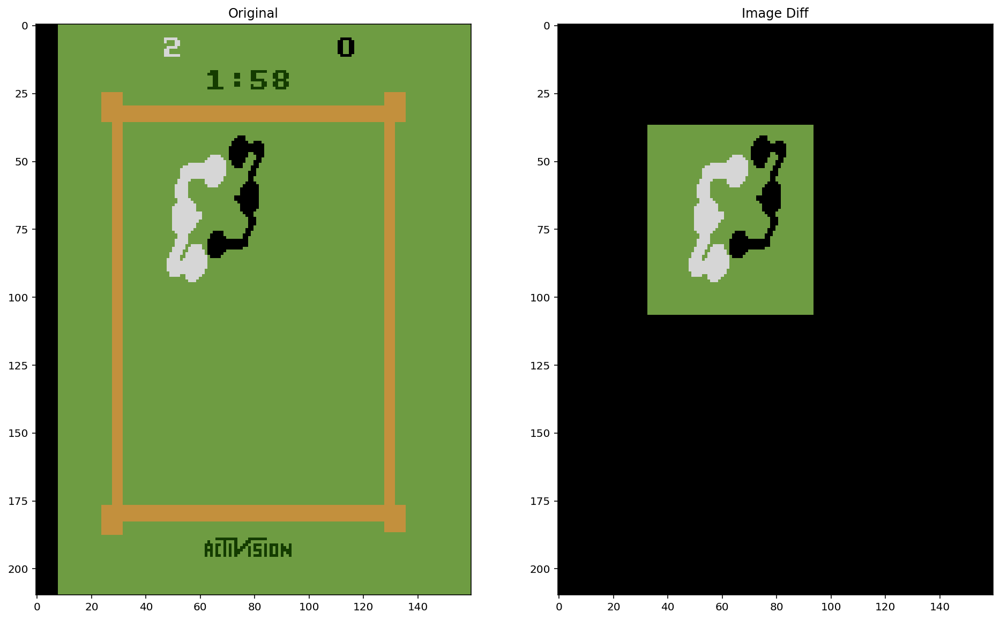

In [ ]:
for game in games:
  for i in range(len(selected_game_frames_full[game])):
    if i+1 < len(selected_game_frames_full[game]):
      img1 = selected_game_frames_full[game][i].permute(1,2,0).numpy()
      img2 = selected_game_frames_full[game][i+1].permute(1,2,0).numpy()
      img3 = selected_game_frames_full[game][i].numpy()
      image_diff(img1,img2,img3)

## EfficientDet

In [ ]:
%cd /content/

/content


In [ ]:
# Clone the tensorflow models repository
!git clone --depth 1 https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 2684, done.
remote: Counting objects: 100% (2684/2684), done.
remote: Compressing objects: 100% (2226/2226), done.
remote: Total 2684 (delta 682), reused 1239 (delta 425), pack-reused 0
Receiving objects: 100% (2684/2684), 32.66 MiB | 22.40 MiB/s, done.
Resolving deltas: 100% (682/682), done.


In [ ]:
%%bash
sudo apt install -y protobuf-compiler
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .

Reading package lists...
Building dependency tree...
Reading state information...
protobuf-compiler is already the newest version (3.0.0-9.1ubuntu1).
0 upgraded, 0 newly installed, 0 to remove and 39 not upgraded.
Processing /content/models/research
  Created wheel for object-detection: filename=object_detection-0.1-cp37-none-any.whl size=1652769 sha256=3cc03f5391ab2700f08cdd546256ce53dbe5c3878edd233158b412b028a369dc
  Stored in directory: /tmp/pip-ephem-wheel-cache-ld6aqoj6/wheels/94/49/4b/39b051683087a22ef7e80ec52152a27249d1a644ccf4e442ea
  Created wheel for avro-python3: filename=avro_python3-1.10.2-cp37-none-any.whl size=44011 sha256=ac81ff546e3173d7abcf268552e933f943bbb50eb852597ab58ee1d10d832480
  Stored in directory: /root/.cache/pip/wheels/ee/ee/18/c466221ca6900e3efce2f4ea9c329288808679aecdcb2838d3
  Created wheel for future: filename=future-0.18.2-cp37-none-any.whl size=491070 sha256=896eb48d2df86a3e6c5d9555d898ae3cf413f12f7fd40e977e22366ba4542a76
  Stored in directory: /root/



ERROR: torchtext 0.9.1 has requirement torch==1.8.1, but you'll have torch 1.7.1+cu110 which is incompatible.
ERROR: multiprocess 0.70.11.1 has requirement dill>=0.3.3, but you'll have dill 0.3.1.1 which is incompatible.
ERROR: gym 0.15.7 has requirement cloudpickle~=1.2.0, but you'll have cloudpickle 1.3.0 which is incompatible.
ERROR: google-colab 1.0.0 has requirement requests~=2.23.0, but you'll have requests 2.25.1 which is incompatible.
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have folium 0.8.3 which is incompatible.
ERROR: apache-beam 2.29.0 has requirement avro-python3!=1.9.2,<1.10.0,>=1.8.1, but you'll have avro-python3 1.10.2 which is incompatible.


In [ ]:
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.utils import ops as utils_ops
import tensorflow_hub as hub

%matplotlib inline

In [ ]:
PATH_TO_LABELS = './models/research/object_detection/data/mscoco_label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

print('loading model...')
hub_model = hub.load("https://tfhub.dev/tensorflow/efficientdet/d7/1")
print('model loaded!')

loading model...


model loaded!


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<Figure size 432x288 with 0 Axes>

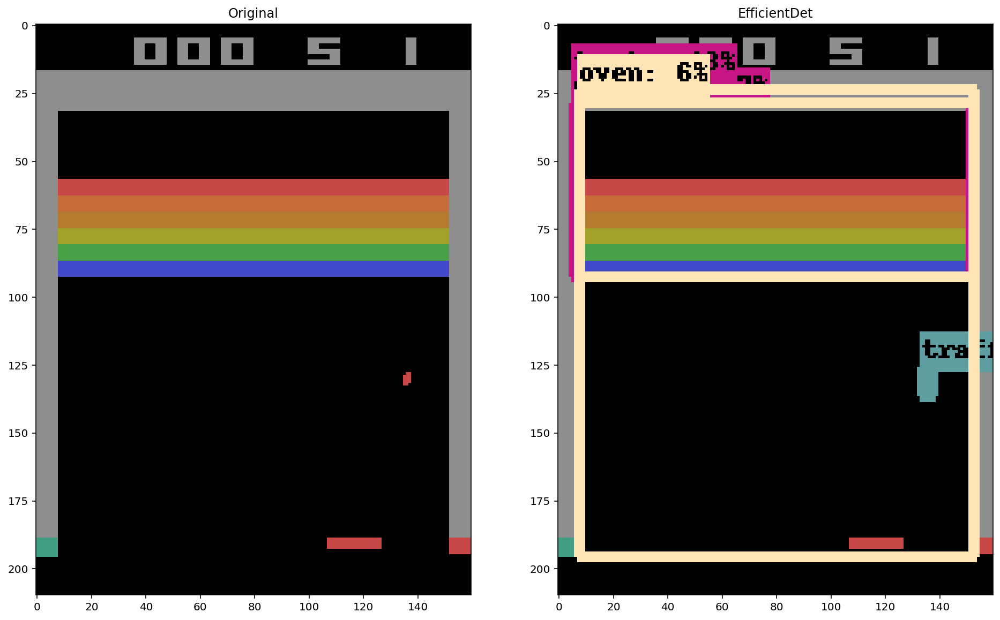

<Figure size 432x288 with 0 Axes>

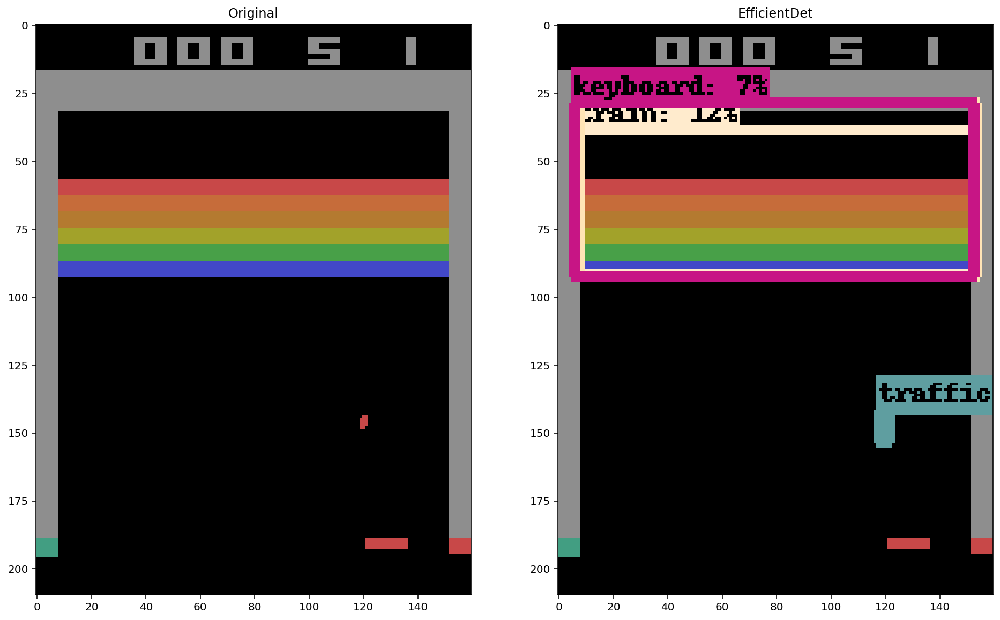

<Figure size 432x288 with 0 Axes>

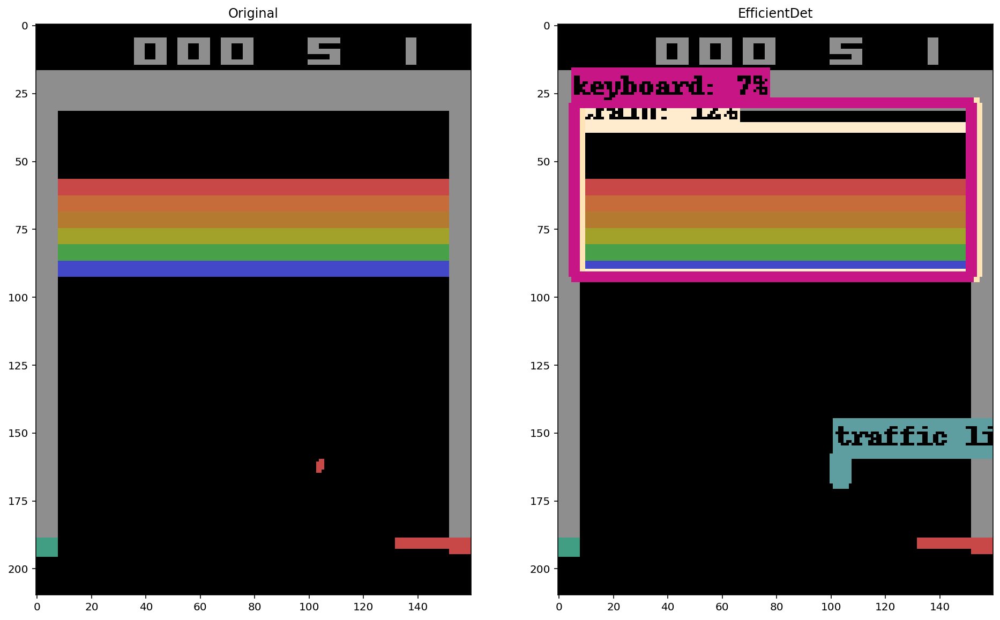

<Figure size 432x288 with 0 Axes>

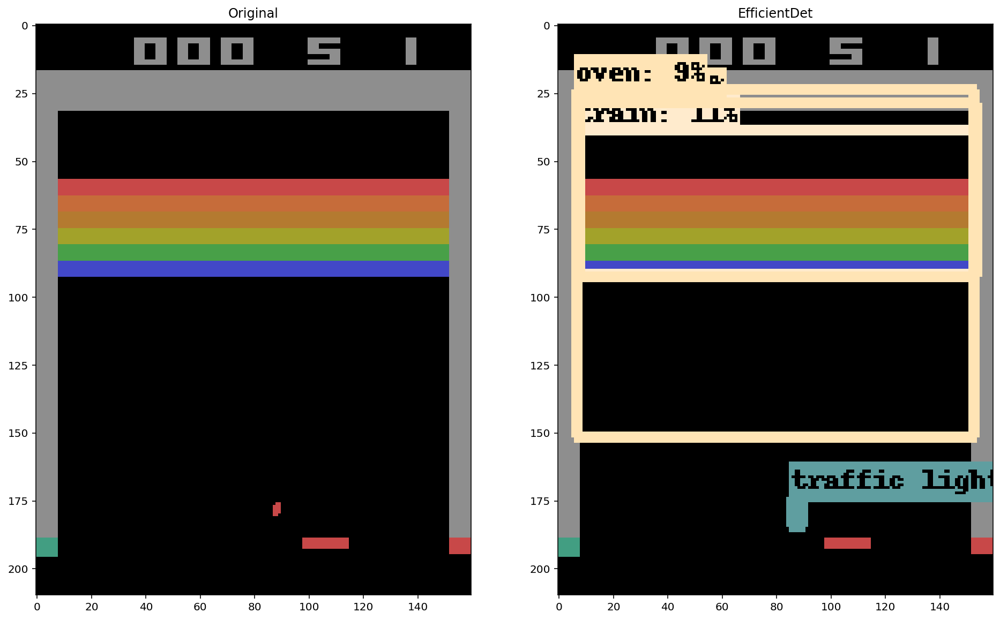

<Figure size 432x288 with 0 Axes>

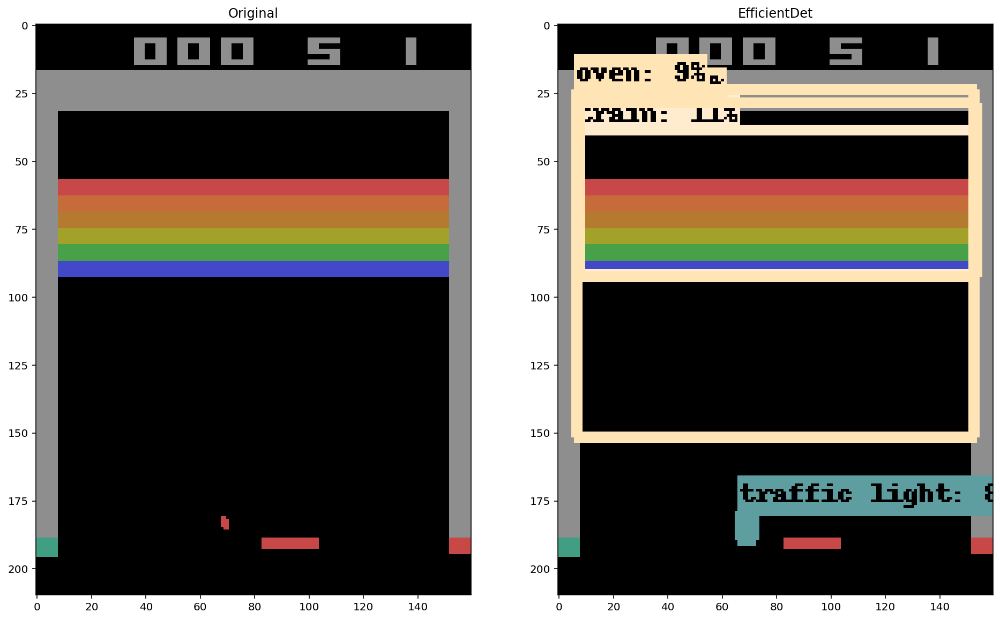

<Figure size 432x288 with 0 Axes>

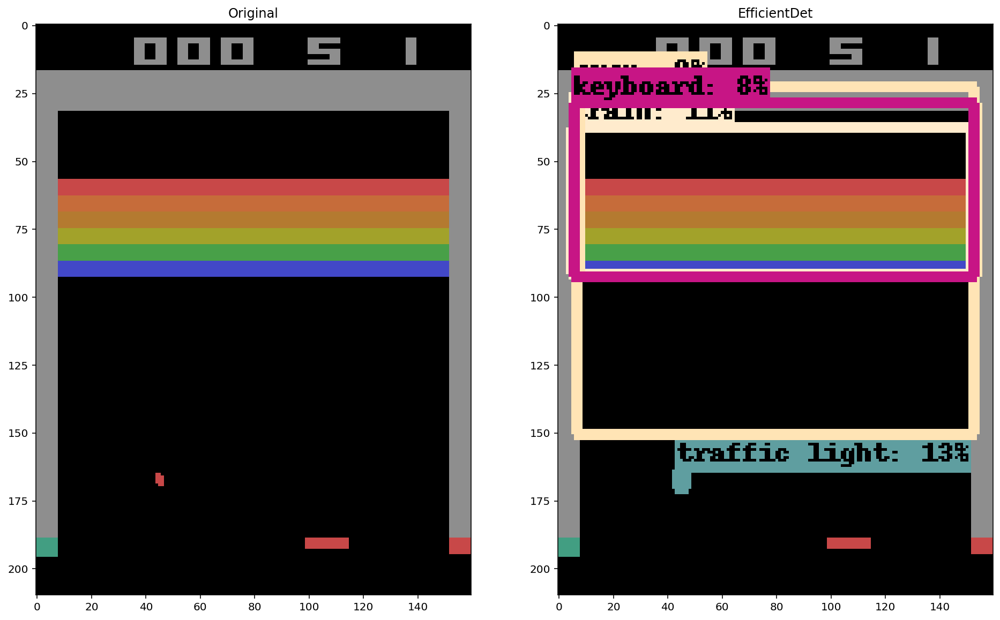

<Figure size 432x288 with 0 Axes>

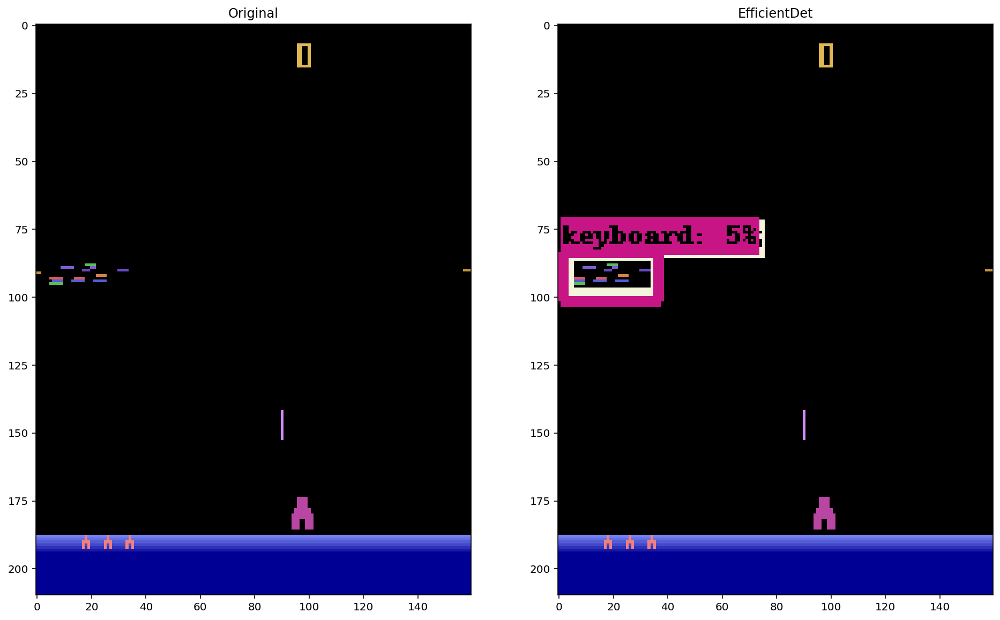

<Figure size 432x288 with 0 Axes>

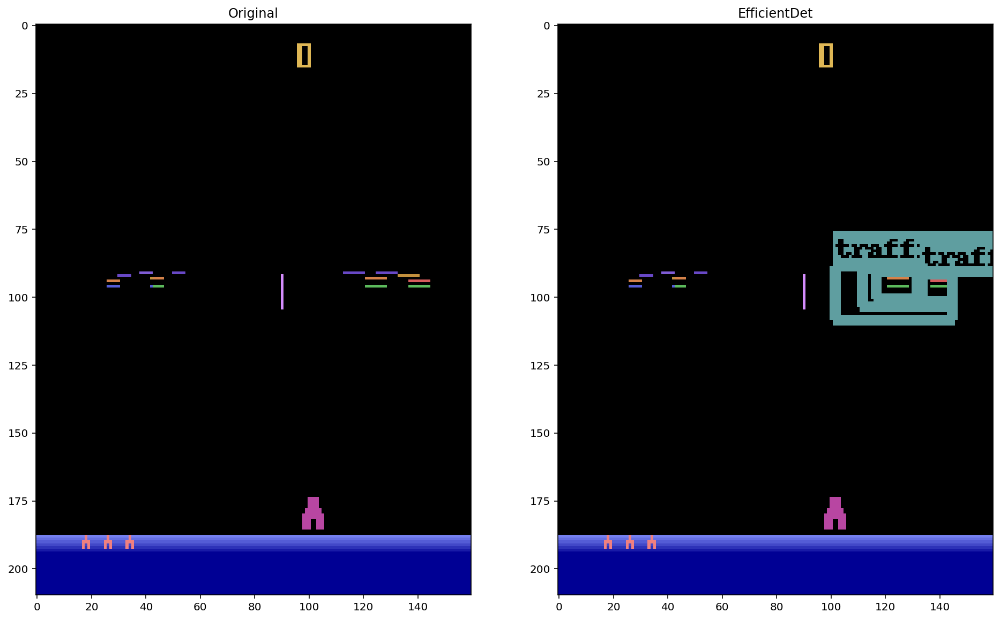

<Figure size 432x288 with 0 Axes>

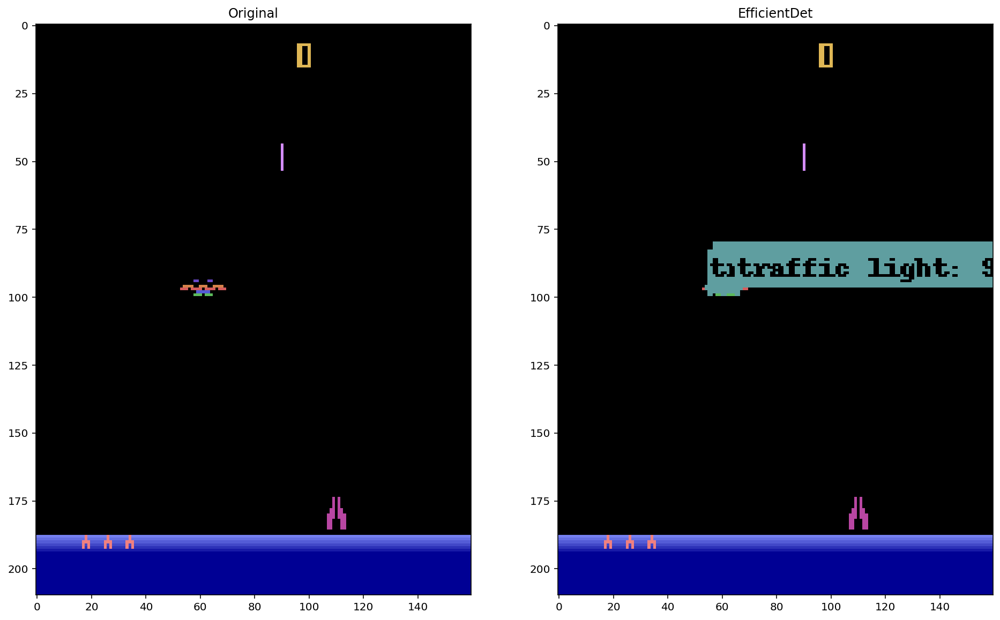

<Figure size 432x288 with 0 Axes>

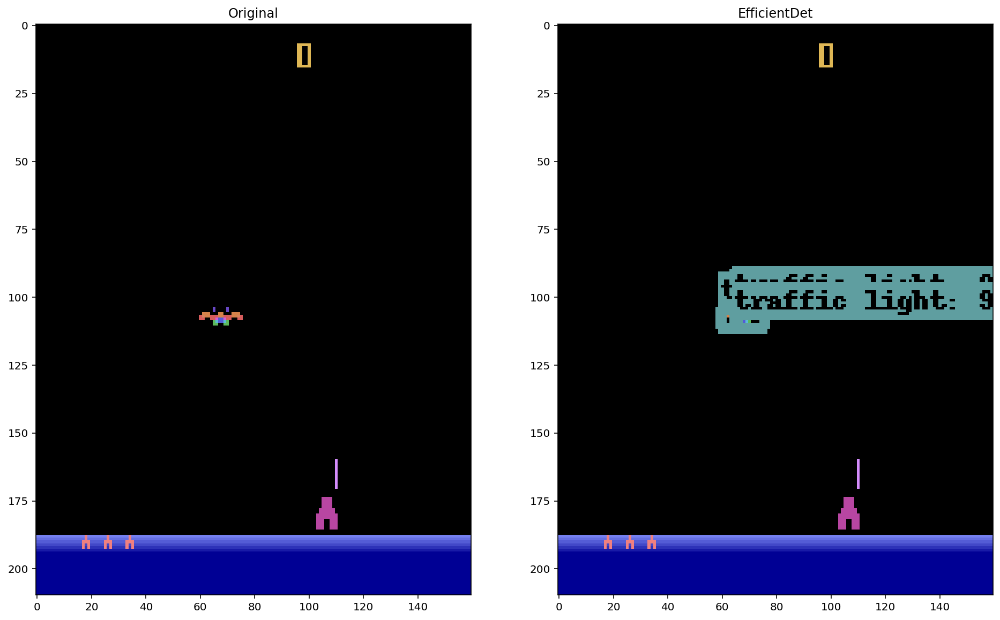

<Figure size 432x288 with 0 Axes>

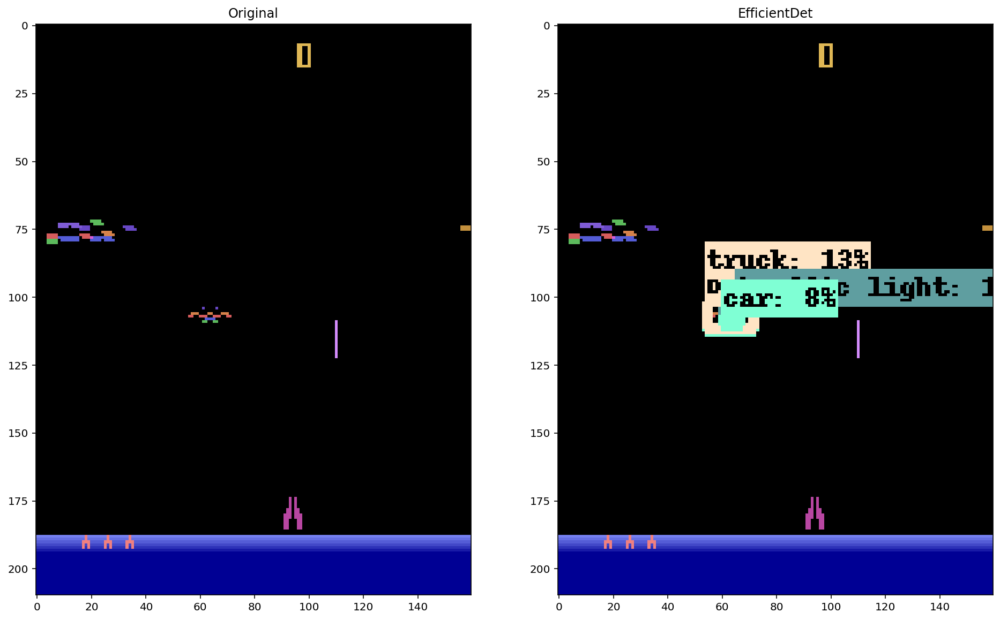

<Figure size 432x288 with 0 Axes>

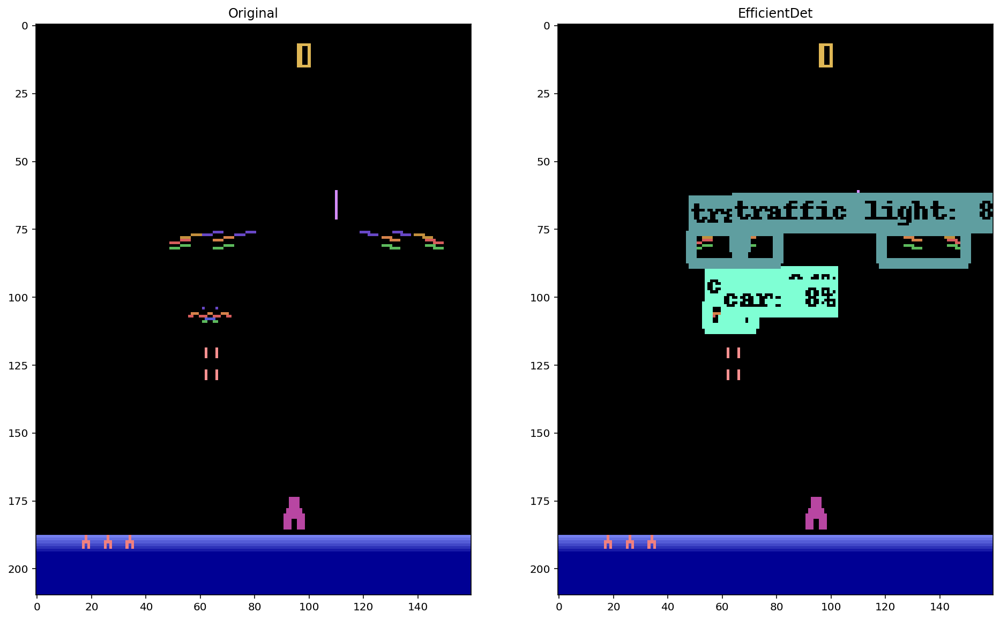

<Figure size 432x288 with 0 Axes>

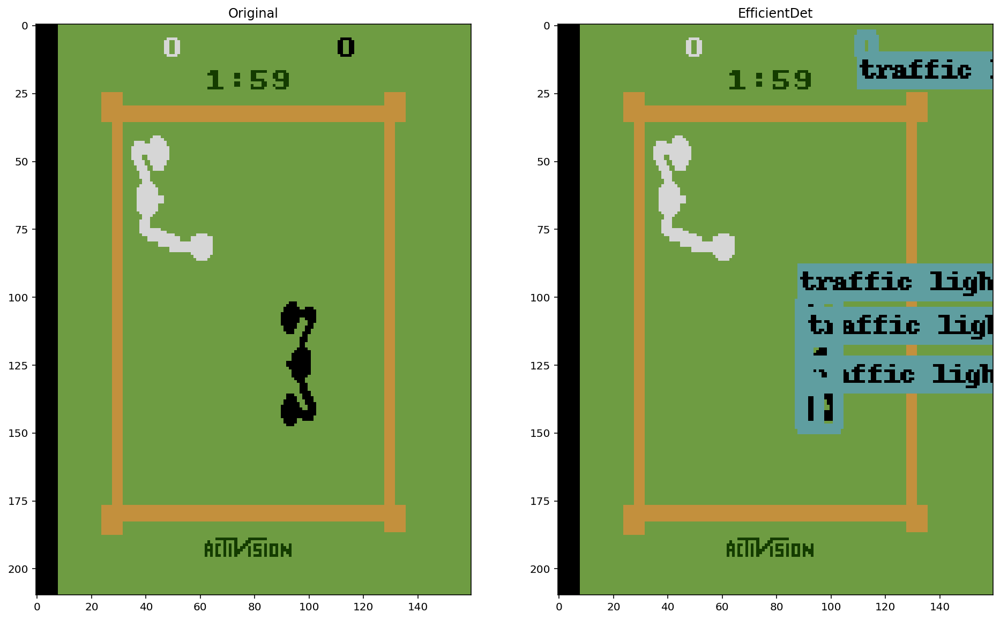

<Figure size 432x288 with 0 Axes>

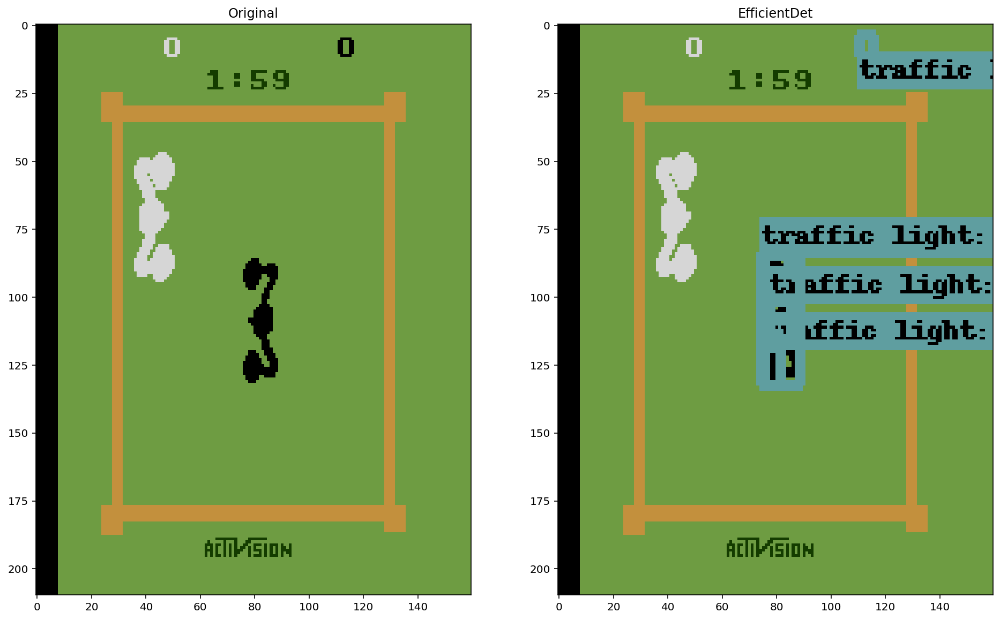

<Figure size 432x288 with 0 Axes>

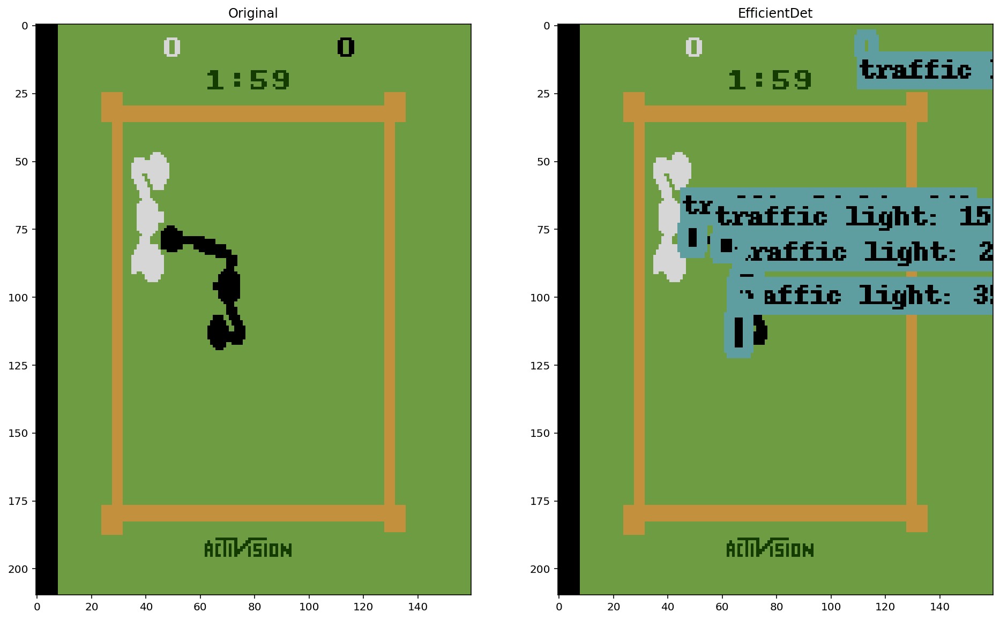

<Figure size 432x288 with 0 Axes>

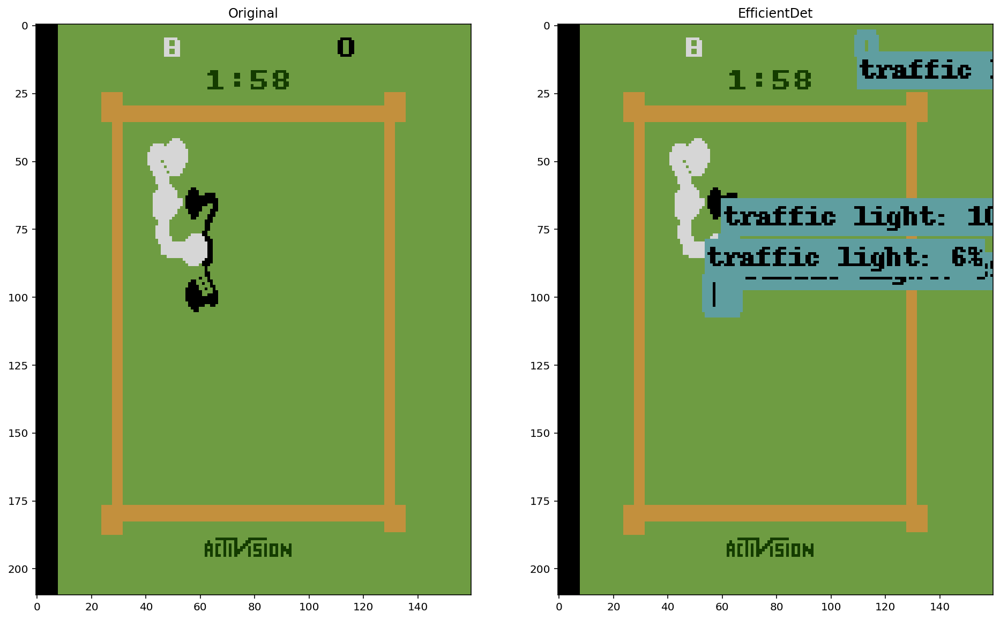

<Figure size 432x288 with 0 Axes>

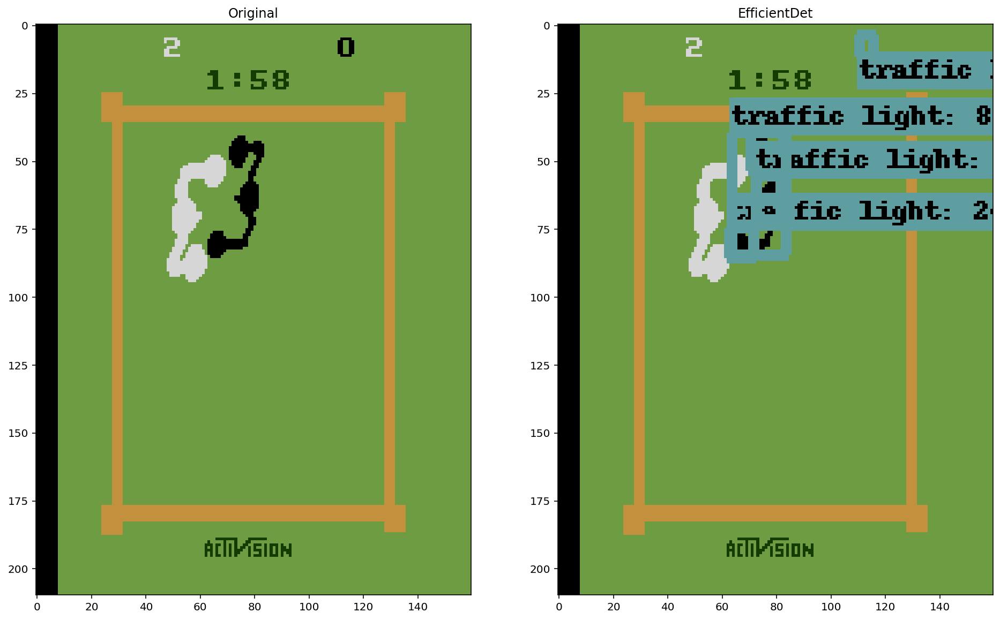

<Figure size 432x288 with 0 Axes>

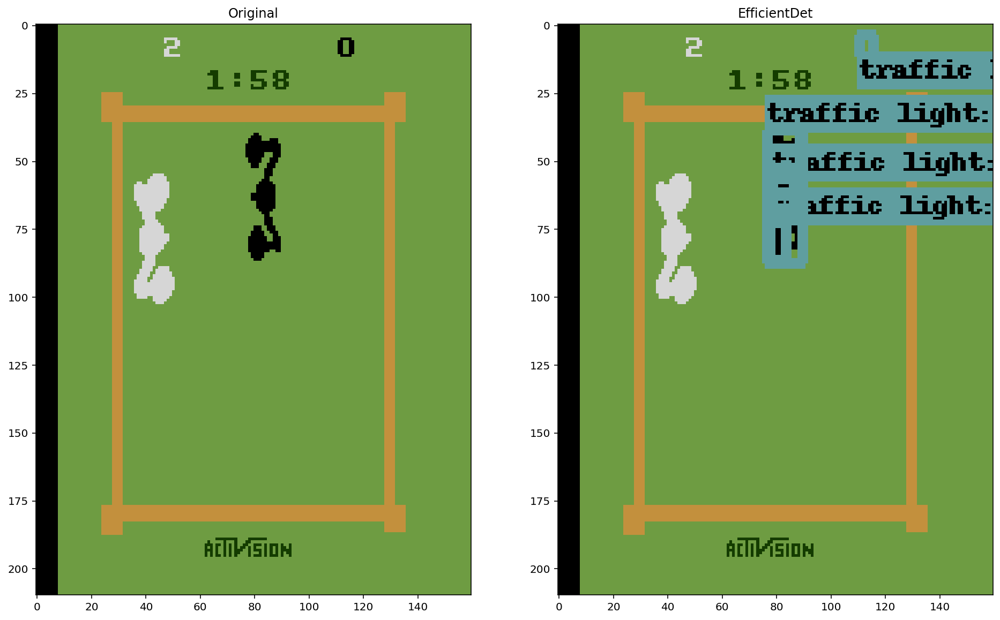

In [ ]:
for game in games:
  for img in selected_game_frames_full[game]:
    data = []
    data.append(img.permute(1, 2, 0).numpy())
    image_data = np.stack(data)
    results = hub_model(image_data)
    result = {key:value.numpy() for key,value in results.items()}
    label_id_offset = 0
    image_np_with_detections = image_data.copy()

    # Use keypoints if available in detections
    keypoints, keypoint_scores = None, None
    if 'detection_keypoints' in result:
      keypoints = result['detection_keypoints'][0]
      keypoint_scores = result['detection_keypoint_scores'][0]

    viz_utils.visualize_boxes_and_labels_on_image_array(
          image_np_with_detections[0],
          result['detection_boxes'][0],
          (result['detection_classes'][0] + label_id_offset).astype(int),
          result['detection_scores'][0],
          category_index,
          use_normalized_coordinates=True,
          max_boxes_to_draw=5,
          min_score_thresh=.05,
          agnostic_mode=False,
          keypoints=keypoints,
          keypoint_scores=keypoint_scores)
    
    plt.figure()
    fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(16, 16))
    ax1.set_title('Original')
    ax2.set_title('EfficientDet')
    _ = ax1.imshow(img.permute(1,2,0).numpy())
    _ = ax2.imshow(image_np_with_detections[0])

## Dino

In [ ]:
%cd /content/

/content


In [ ]:
rm -rf dino

In [ ]:
def plot_attention_map_full_dino(att_map):
    plt.figure()
    fig, (ax1) = plt.subplots(ncols=1, figsize=(16, 16))
    ax1.set_title('Dino Masked')
    _ = ax1.imshow(att_map)

In [ ]:
!git clone https://github.com/crimsontrigger/dino.git

Cloning into 'dino'...
remote: Enumerating objects: 219, done.
remote: Counting objects: 100% (79/79), done.
remote: Compressing objects: 100% (53/53), done.
remote: Total 219 (delta 51), reused 53 (delta 26), pack-reused 140
Receiving objects: 100% (219/219), 24.43 MiB | 22.06 MiB/s, done.
Resolving deltas: 100% (132/132), done.


In [ ]:
%cd /content/dino

/content/dino


In [ ]:
from dino.visualize_attention import (run_vis)

In [ ]:
all_games = []
for game in games:
  ep_masked_images = run_vis(selected_game_frames_full[game])
  all_games.append(ep_masked_images)

  0%|          | 0/6 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3063: UserWarning: Default upsampling behavior when mode=bicubic is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:3103: UserWarning: The default behavior for interpolate/upsample with float scale_factor changed in 1.6.0 to align with other frameworks/libraries, and now uses scale_factor directly, instead of relying on the computed output size. If you wish to restore the old behavior, please set recompute_scale_factor=True. See the documentation of nn.Upsample for details. 
  warnings.warn("The default behavior for interpolate/upsample with float scale_factor changed "
100%|██████████| 6/6 [00:00<00:00, 10.95it/s]


<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

<Figure size 360x360 with 0 Axes>

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<Figure size 432x288 with 0 Axes>

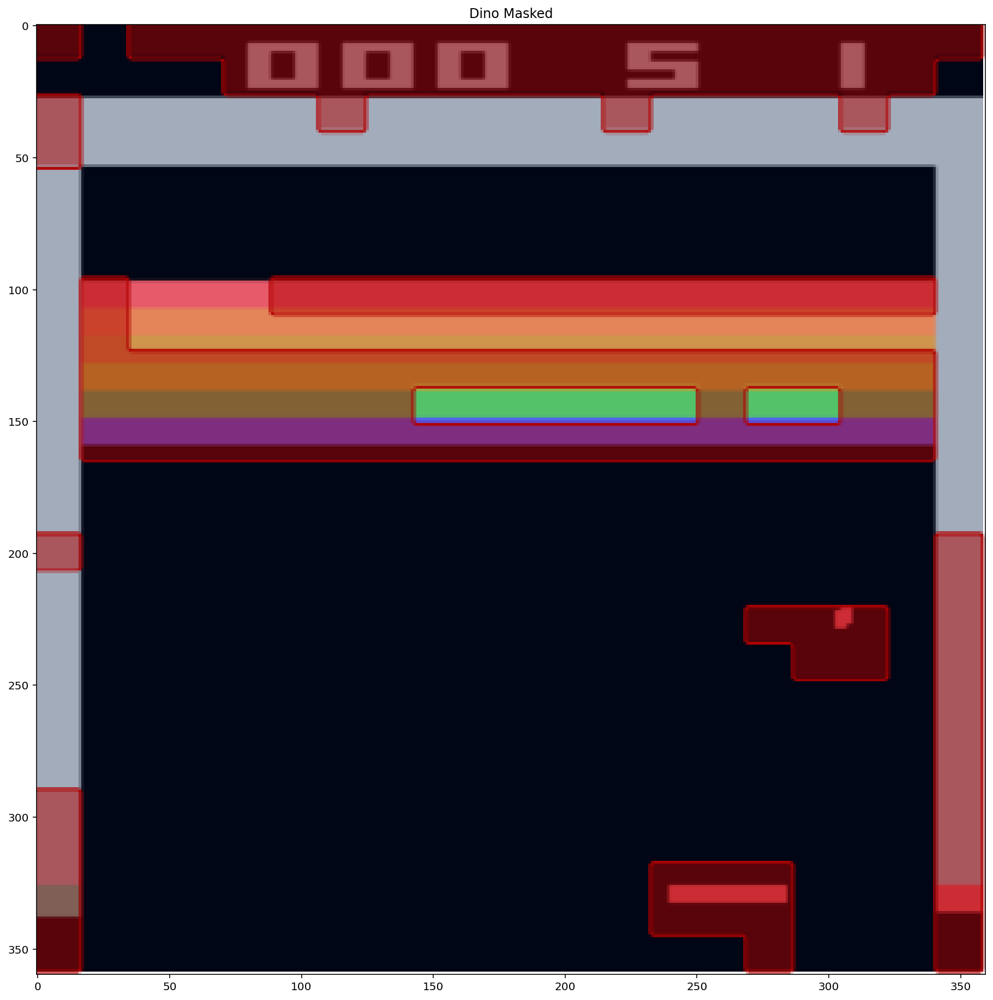

<Figure size 432x288 with 0 Axes>

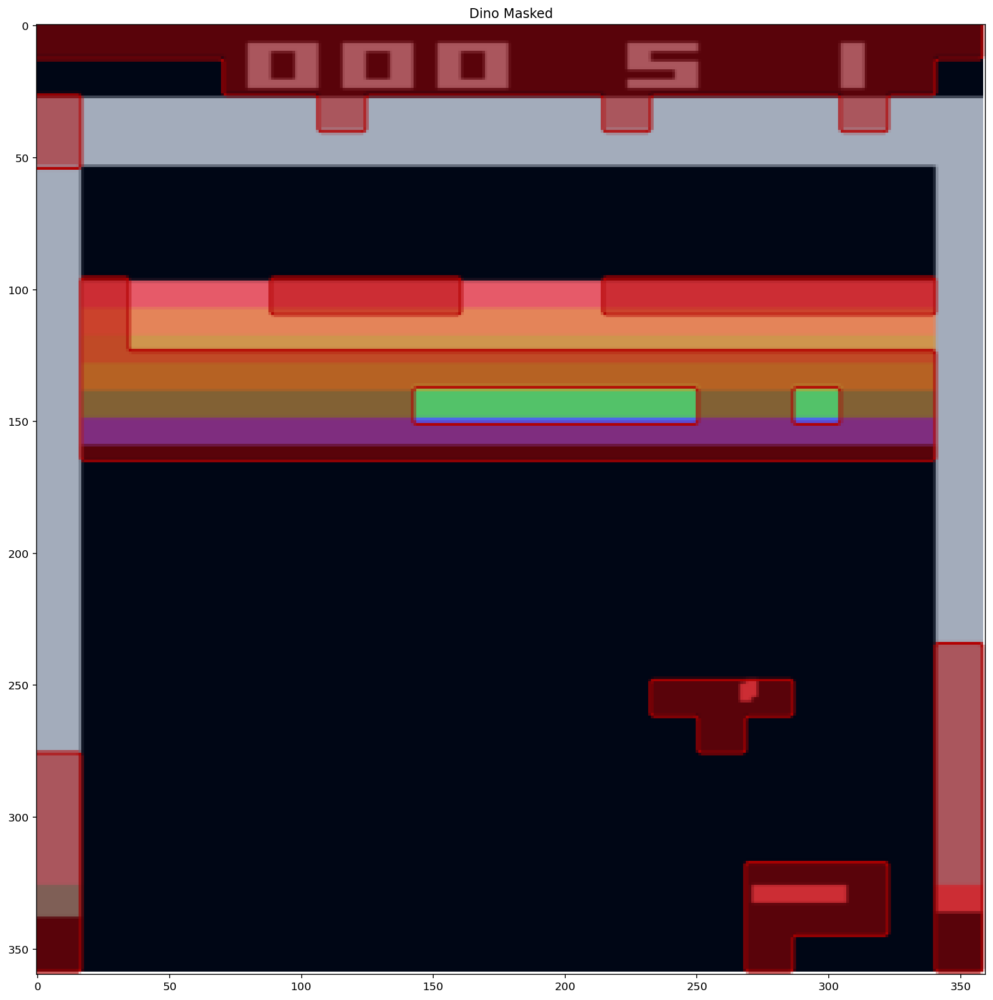

<Figure size 432x288 with 0 Axes>

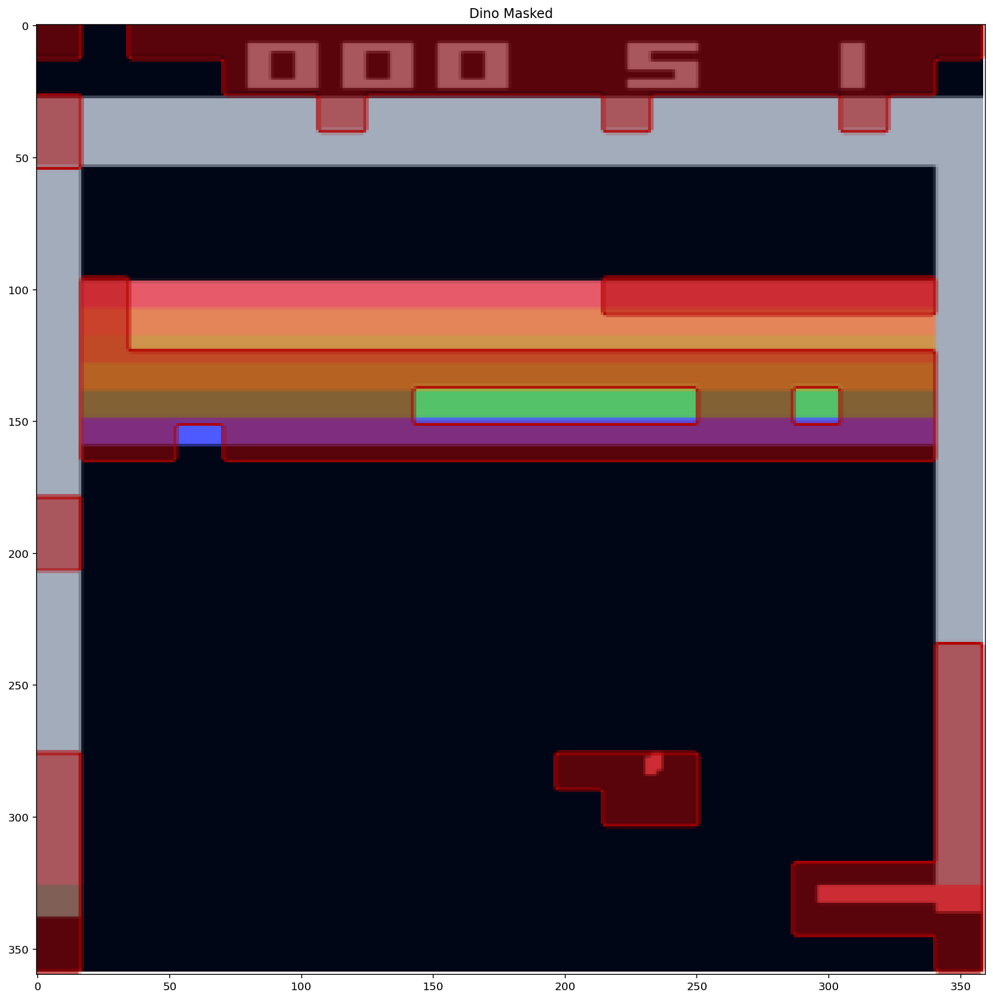

<Figure size 432x288 with 0 Axes>

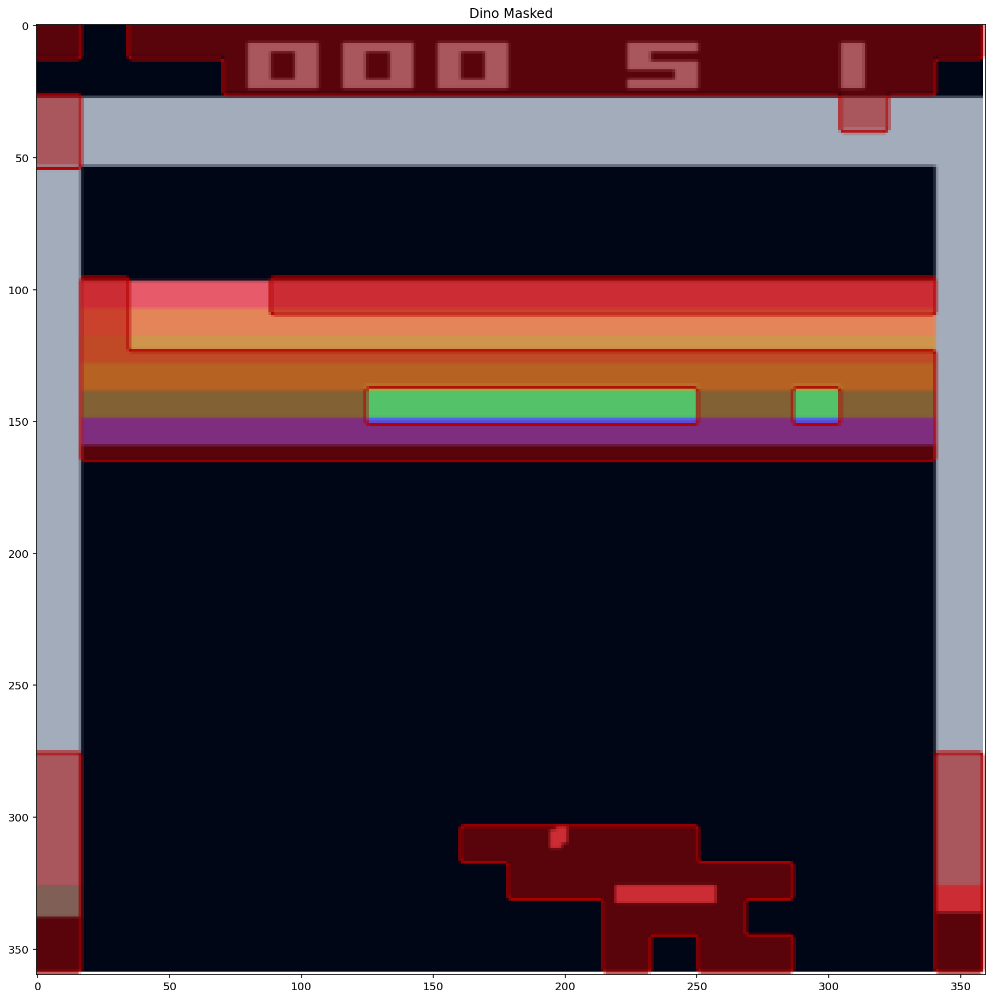

<Figure size 432x288 with 0 Axes>

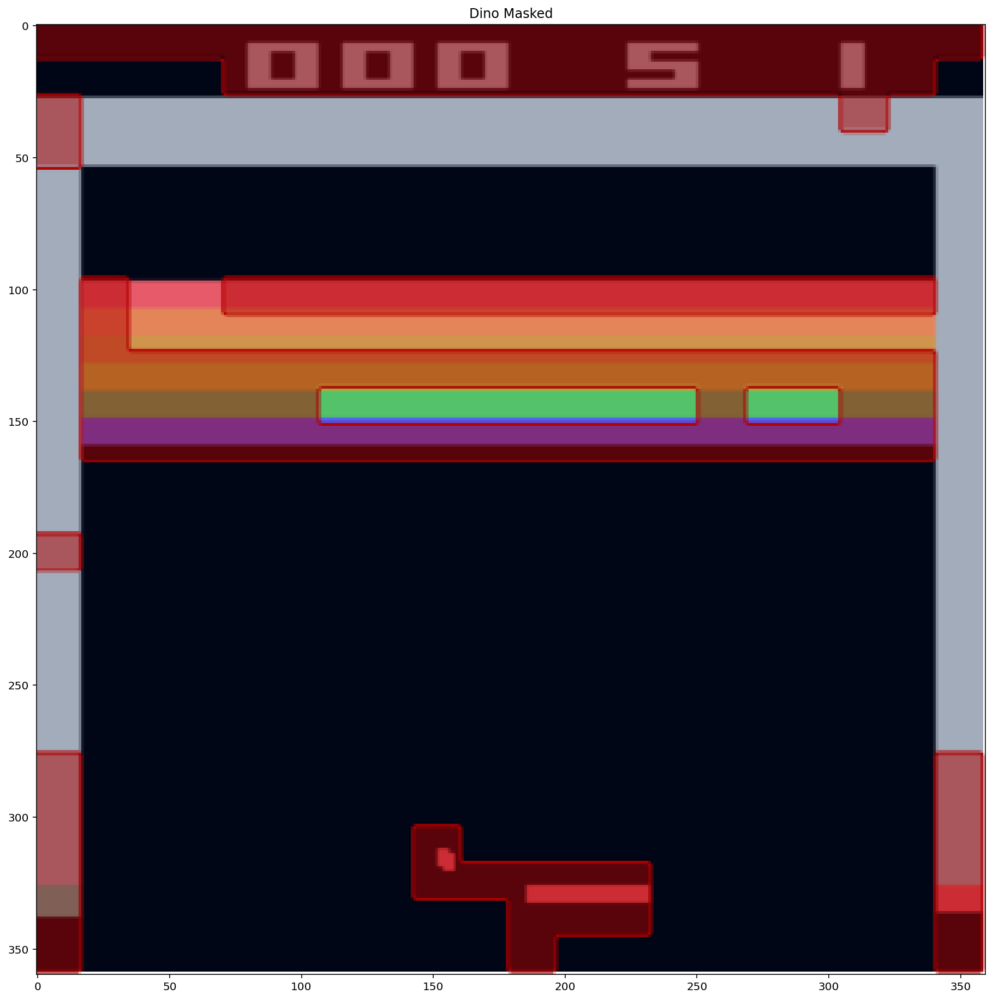

<Figure size 432x288 with 0 Axes>

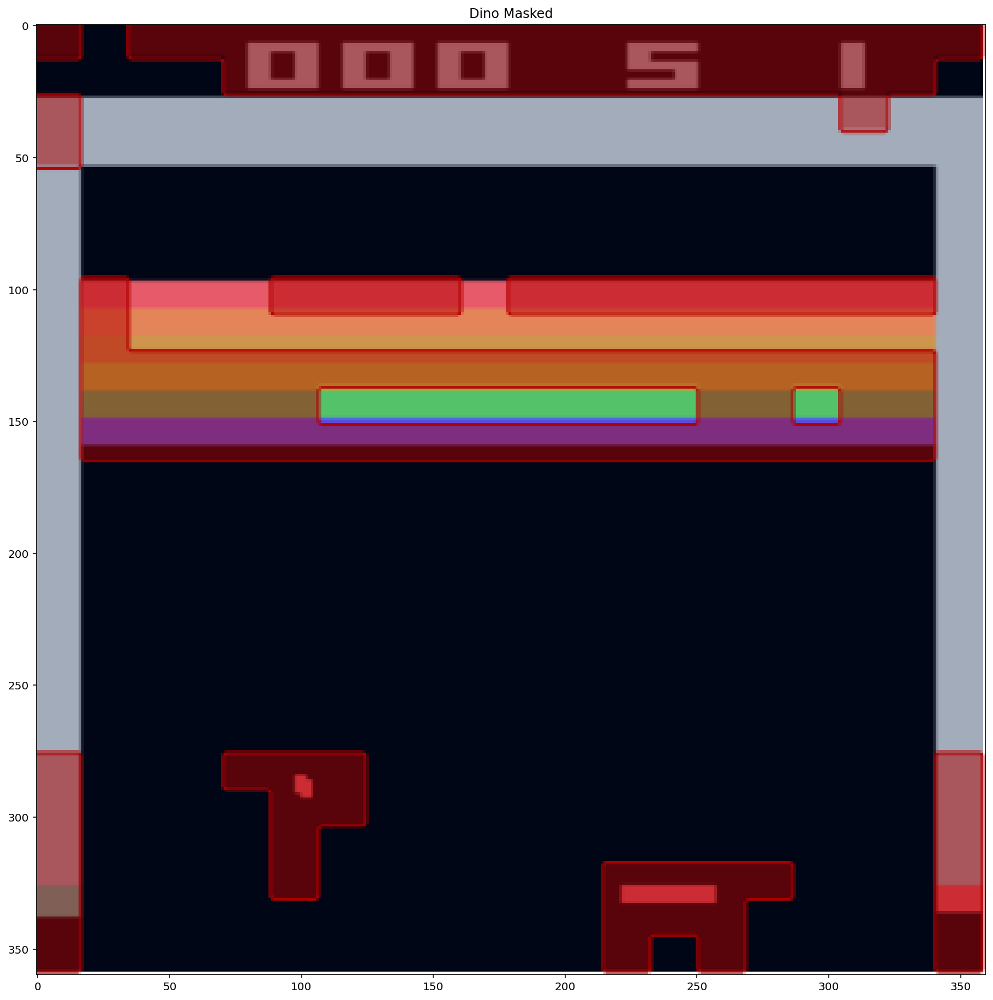

<Figure size 432x288 with 0 Axes>

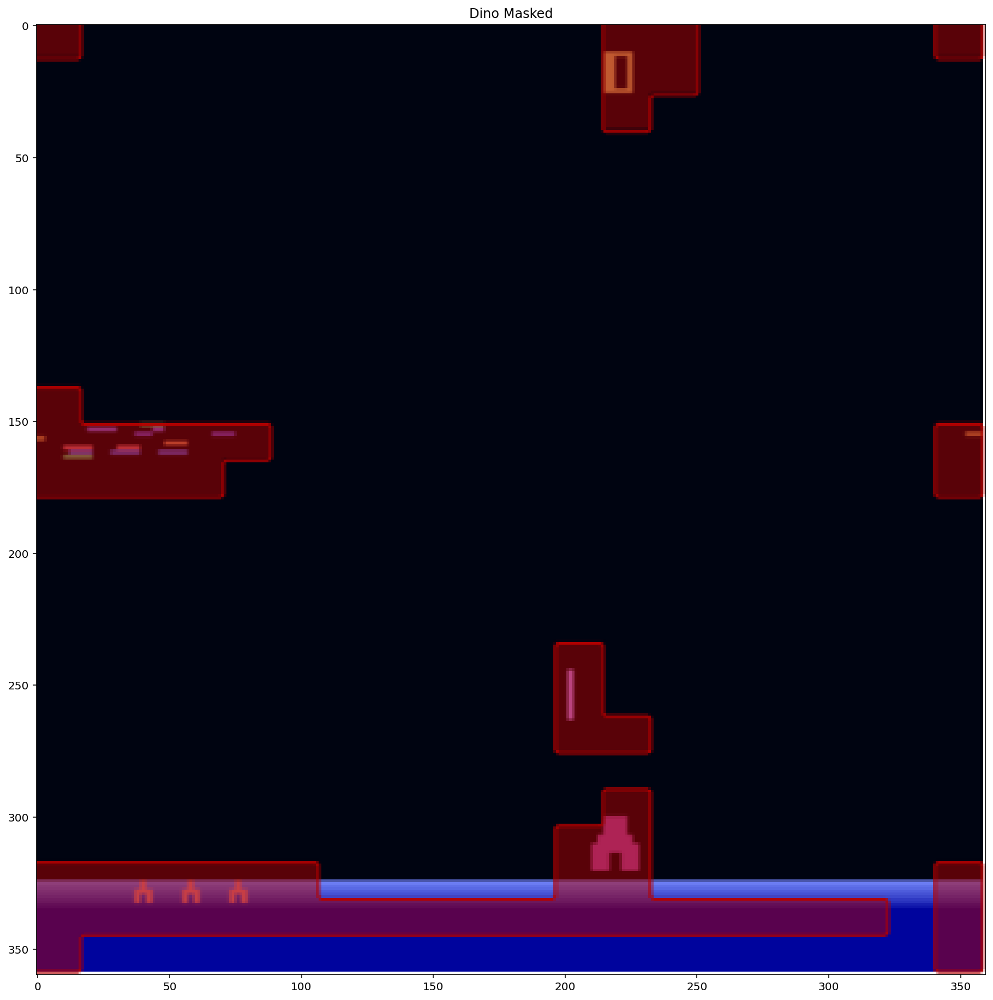

<Figure size 432x288 with 0 Axes>

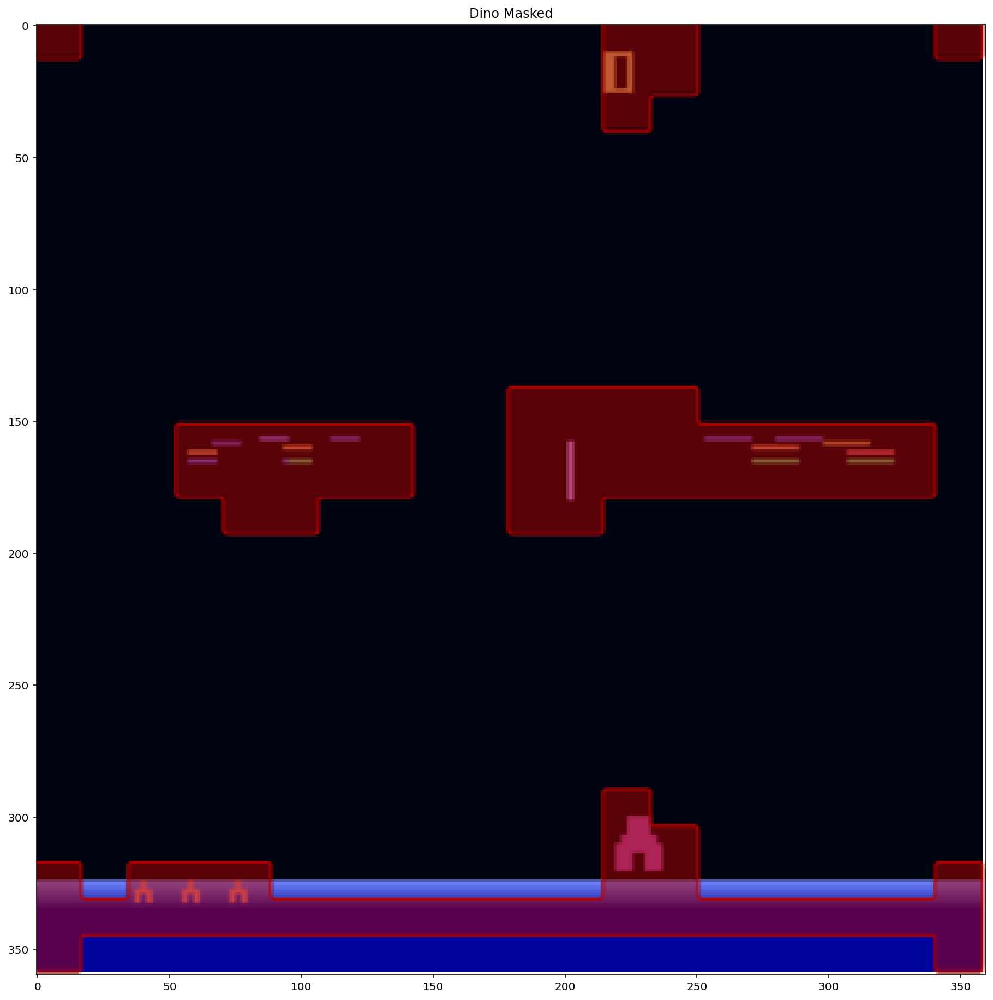

<Figure size 432x288 with 0 Axes>

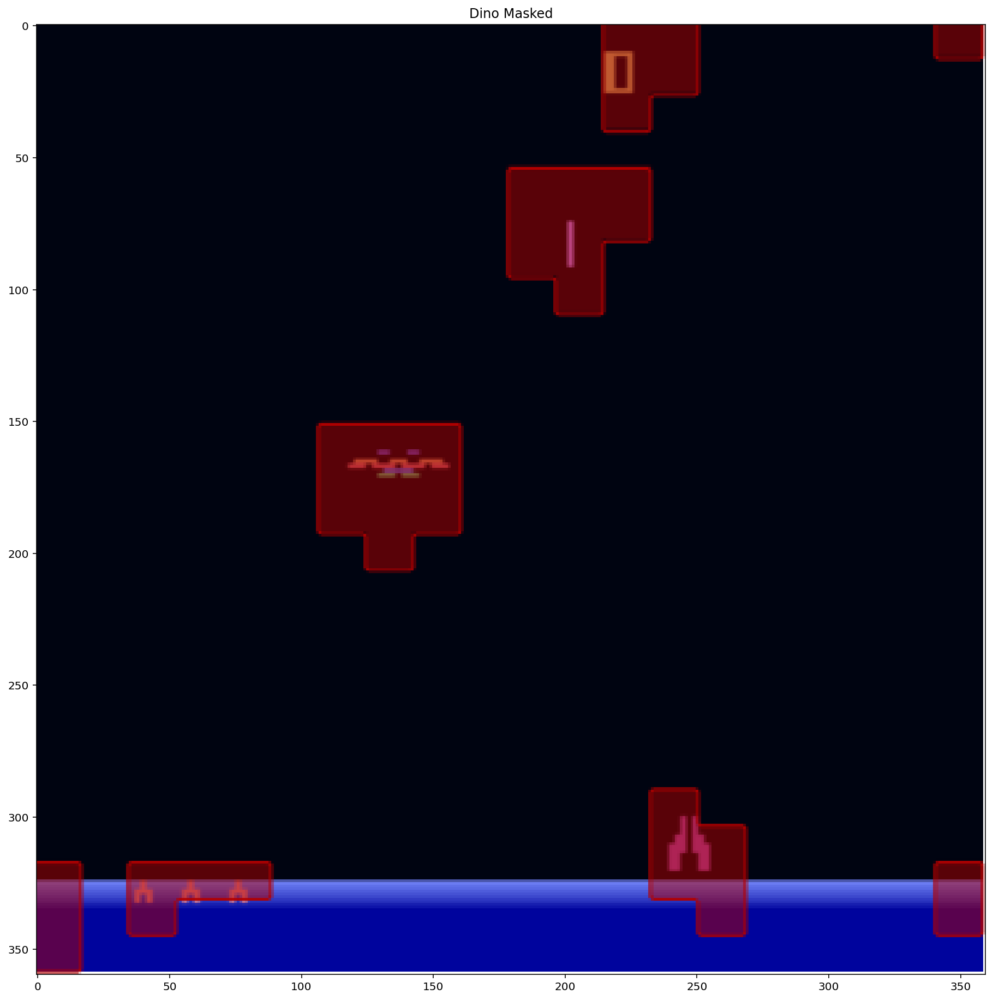

<Figure size 432x288 with 0 Axes>

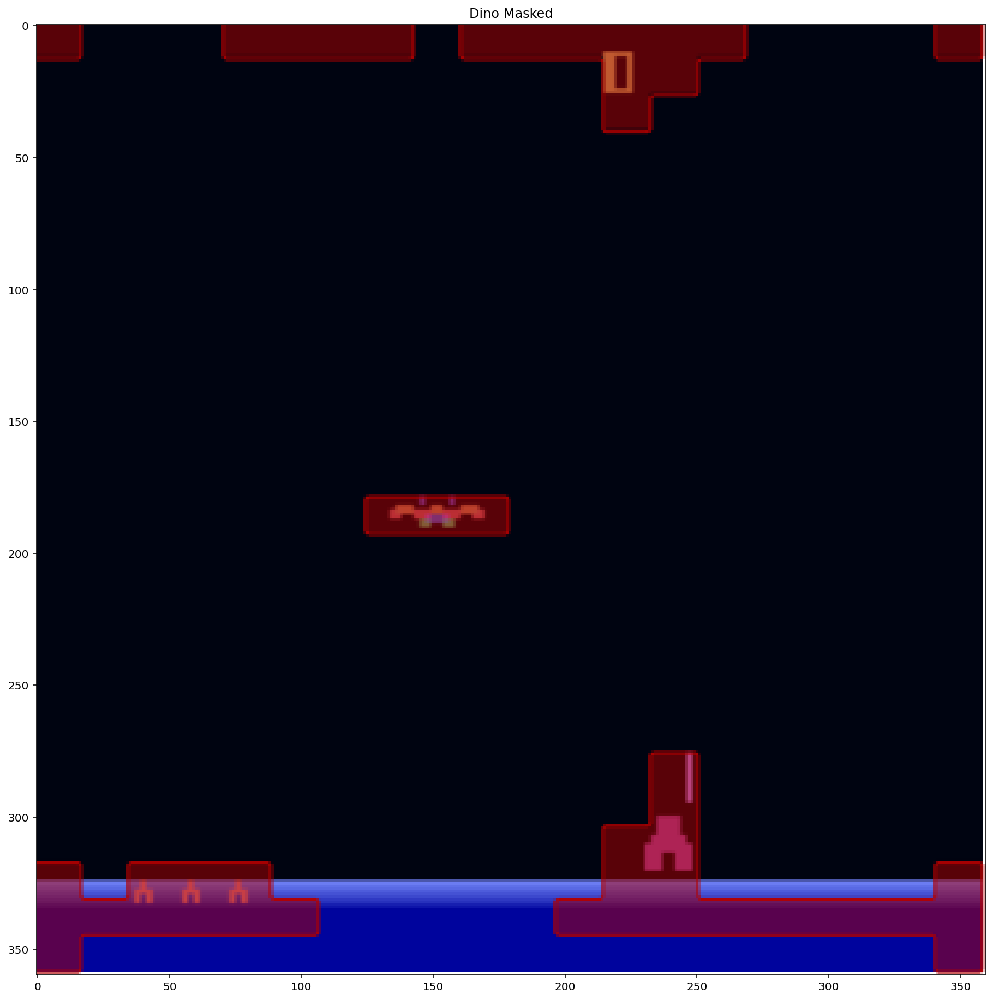

<Figure size 432x288 with 0 Axes>

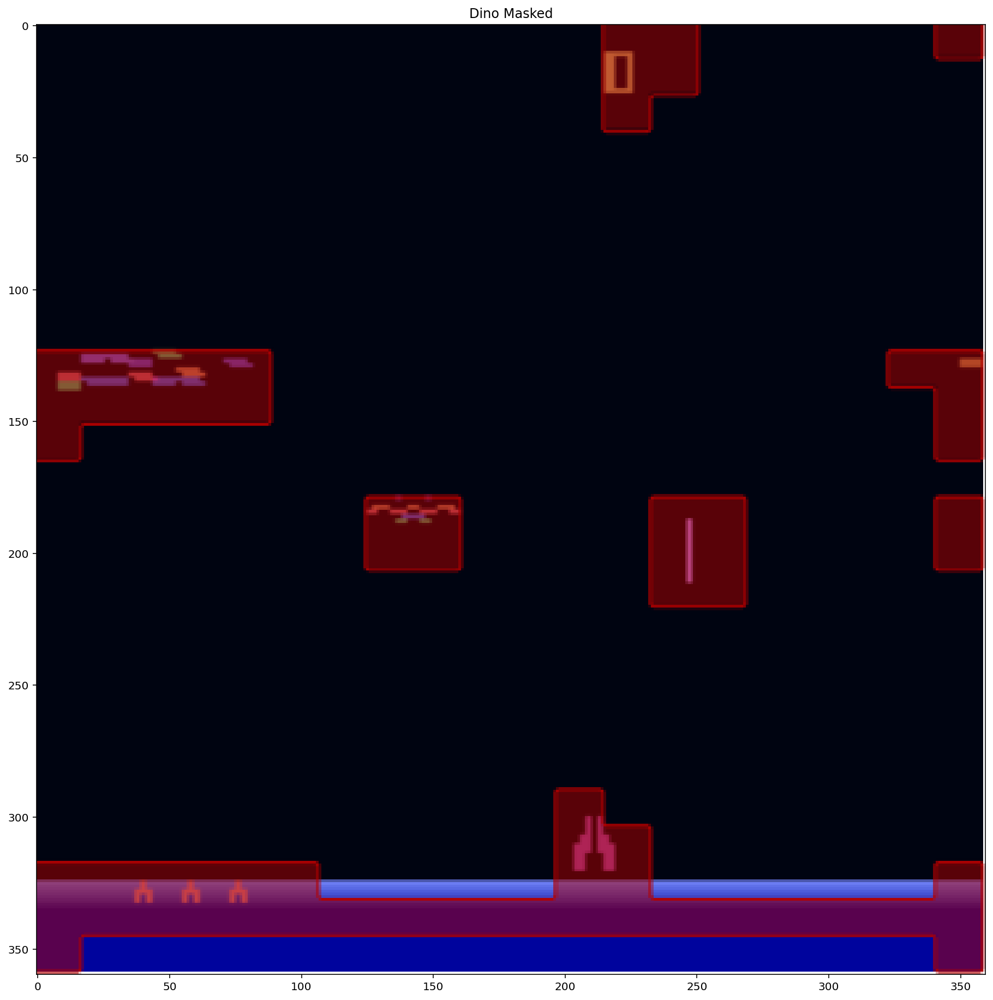

<Figure size 432x288 with 0 Axes>

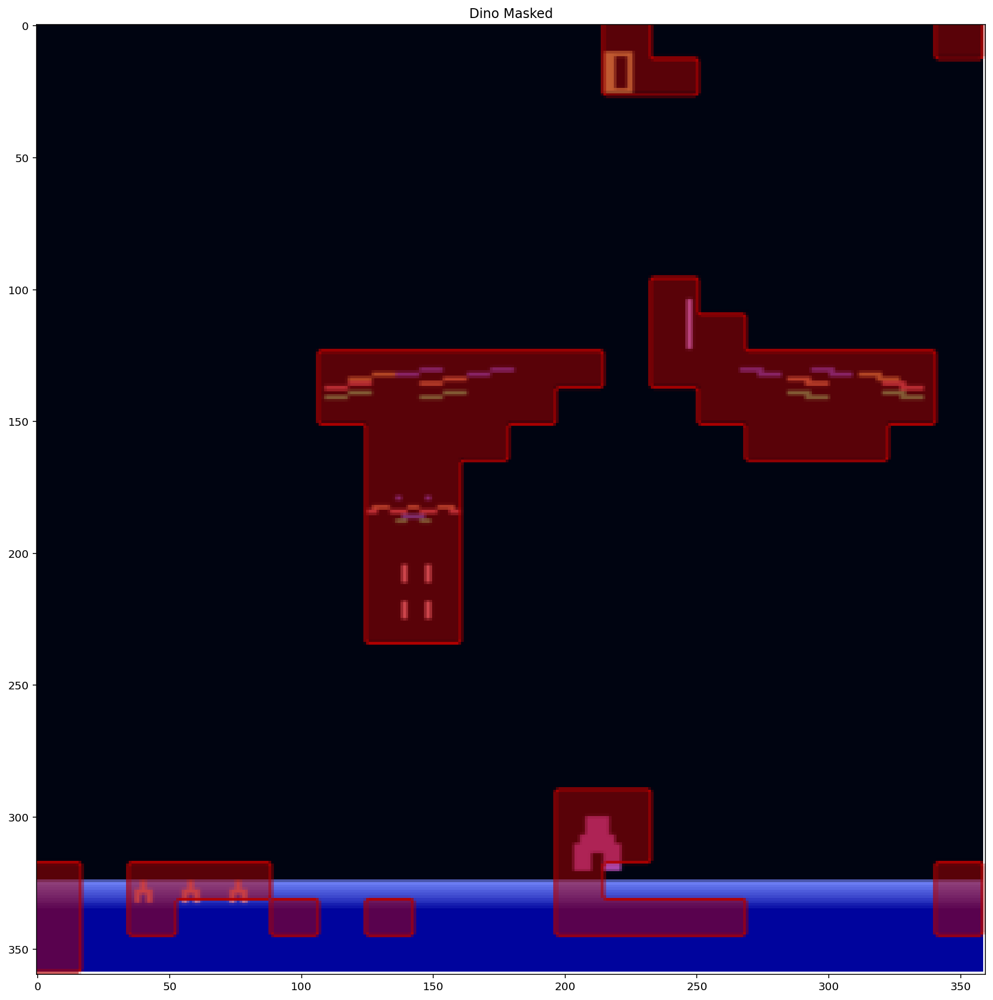

<Figure size 432x288 with 0 Axes>

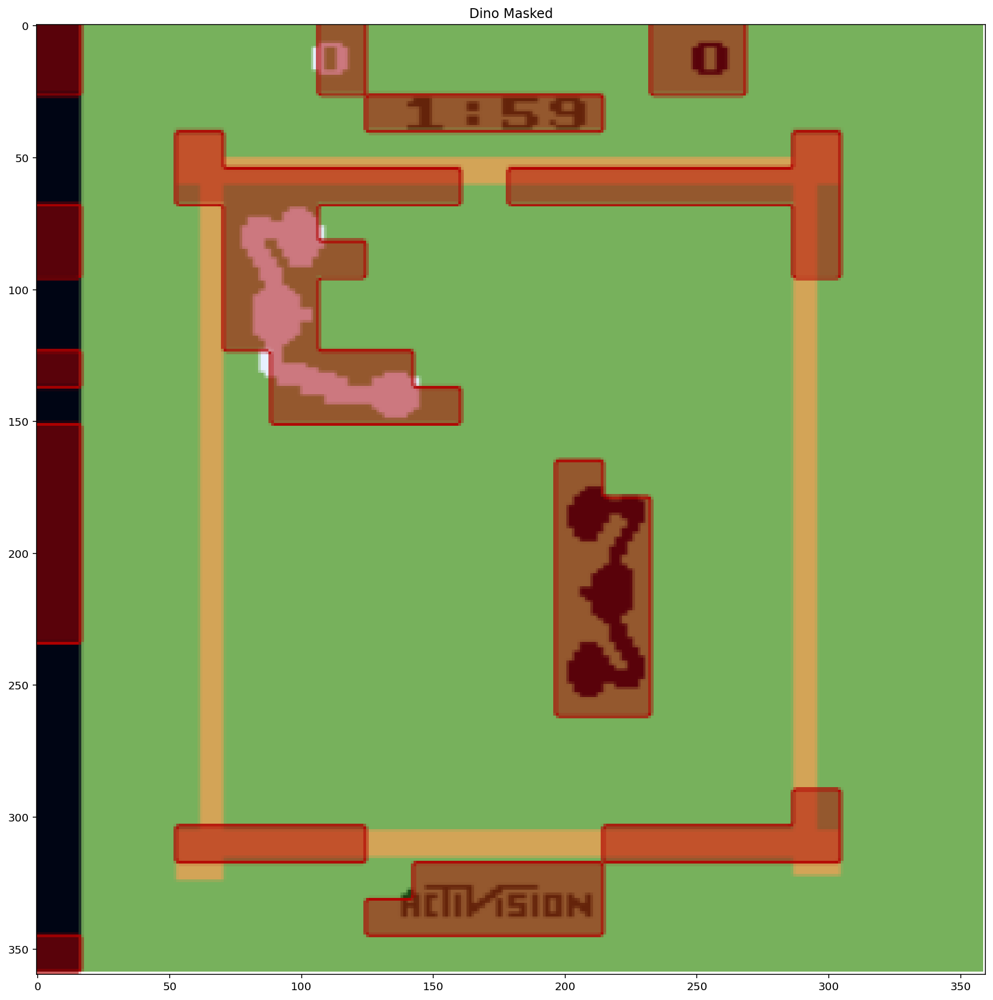

<Figure size 432x288 with 0 Axes>

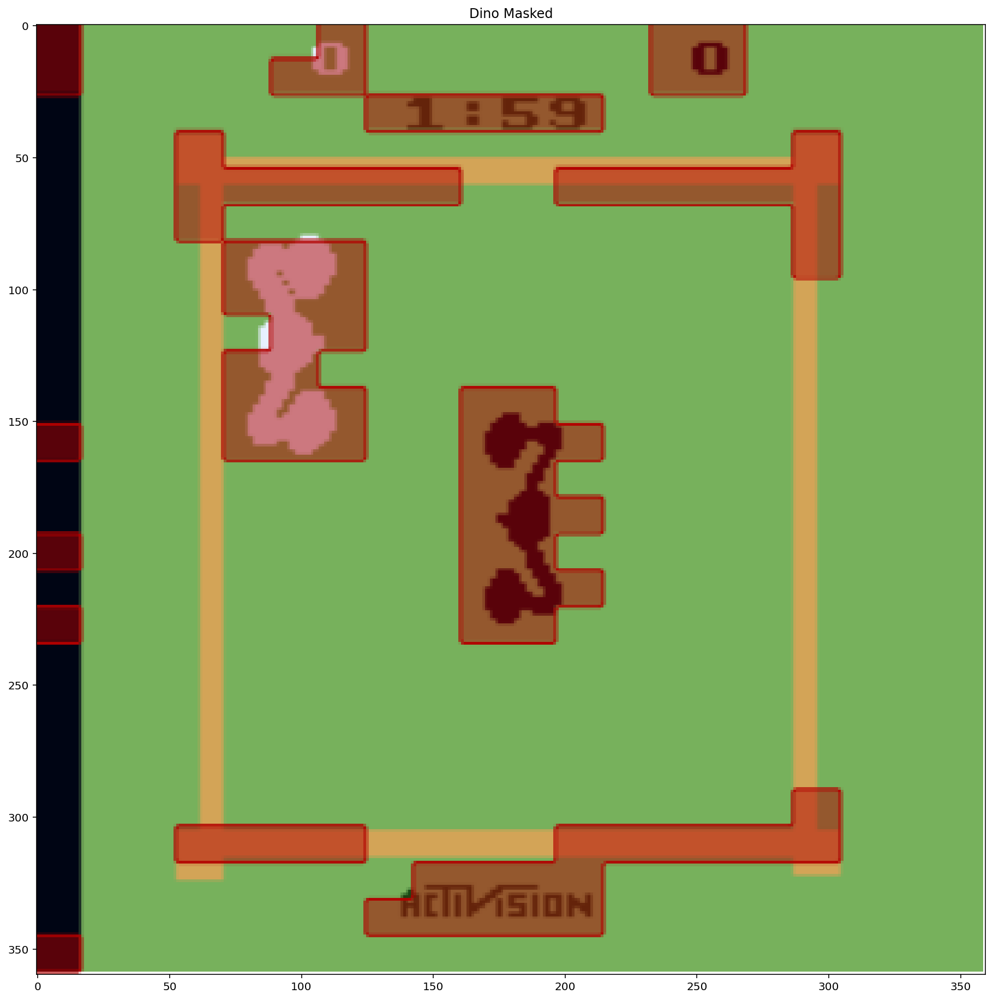

<Figure size 432x288 with 0 Axes>

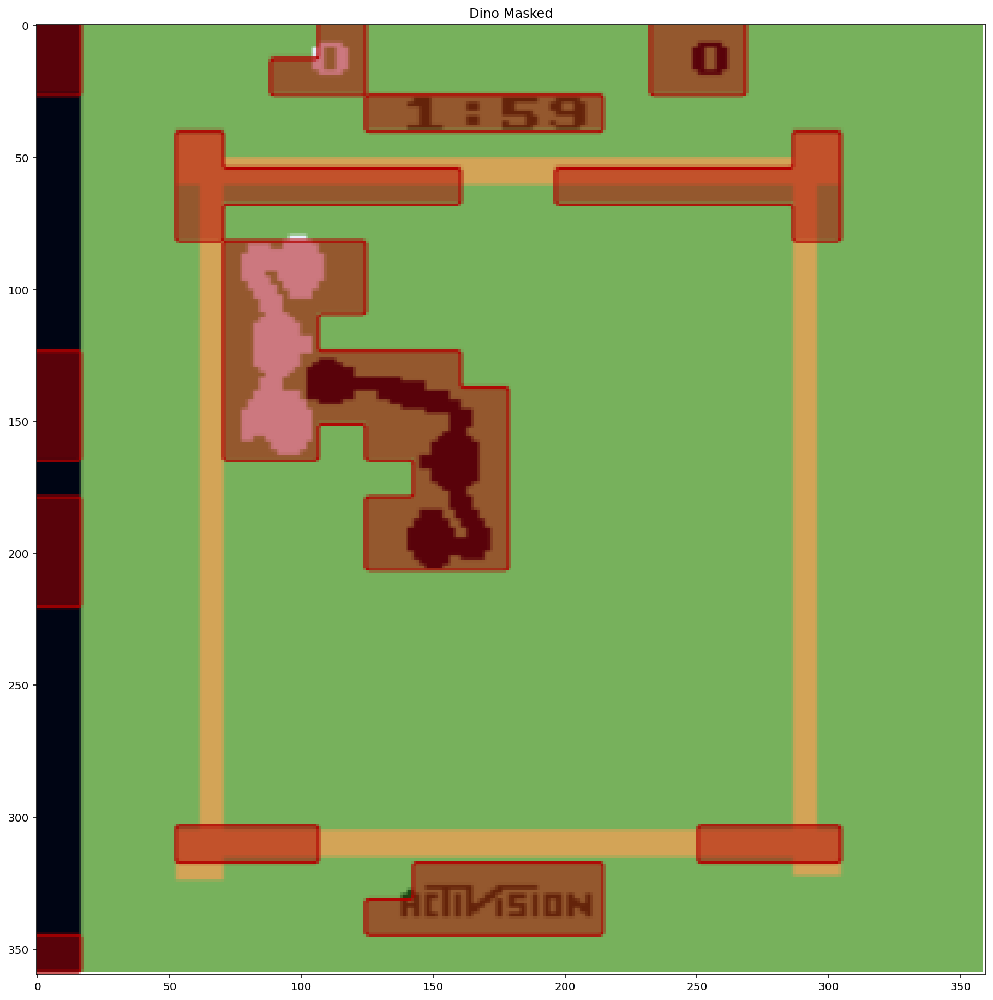

<Figure size 432x288 with 0 Axes>

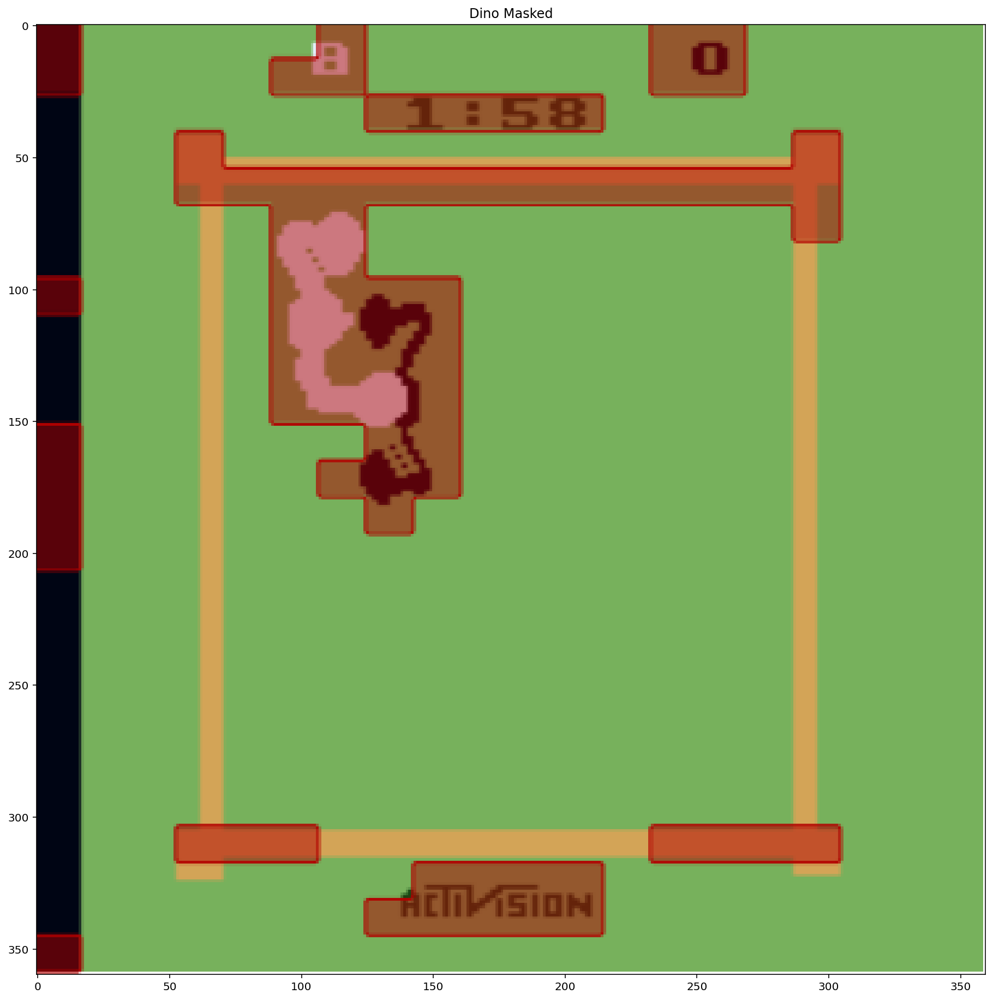

<Figure size 432x288 with 0 Axes>

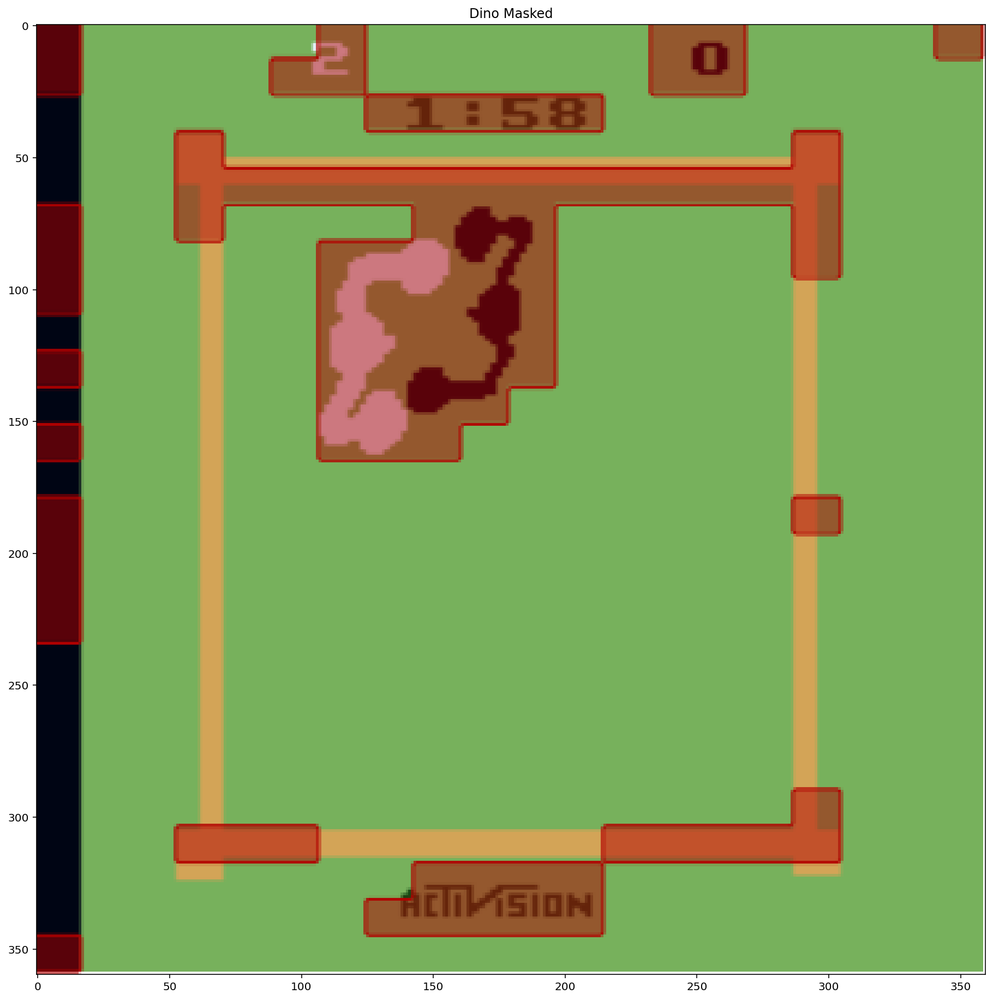

<Figure size 432x288 with 0 Axes>

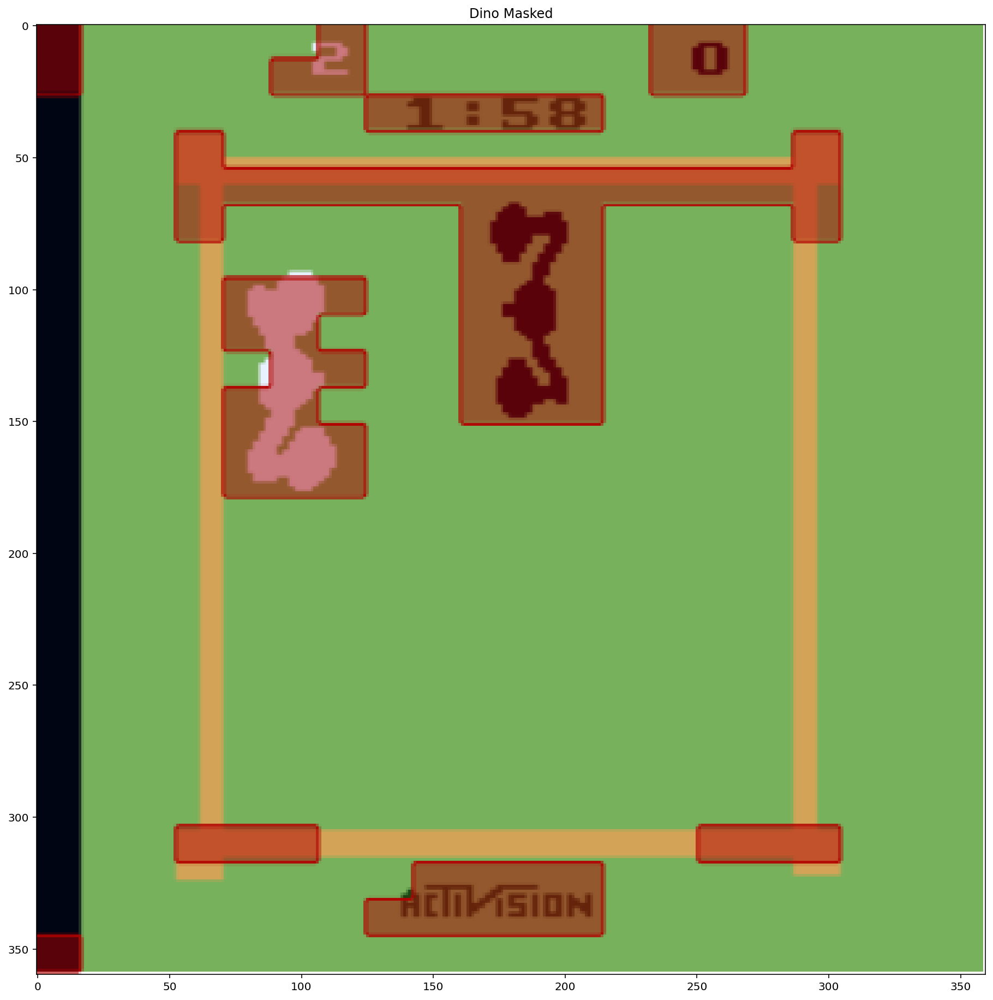

In [ ]:
for game_img in all_games:
  for ind_game_img in game_img:
    plot_attention_map_full_dino(ind_game_img)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<Figure size 432x288 with 0 Axes>

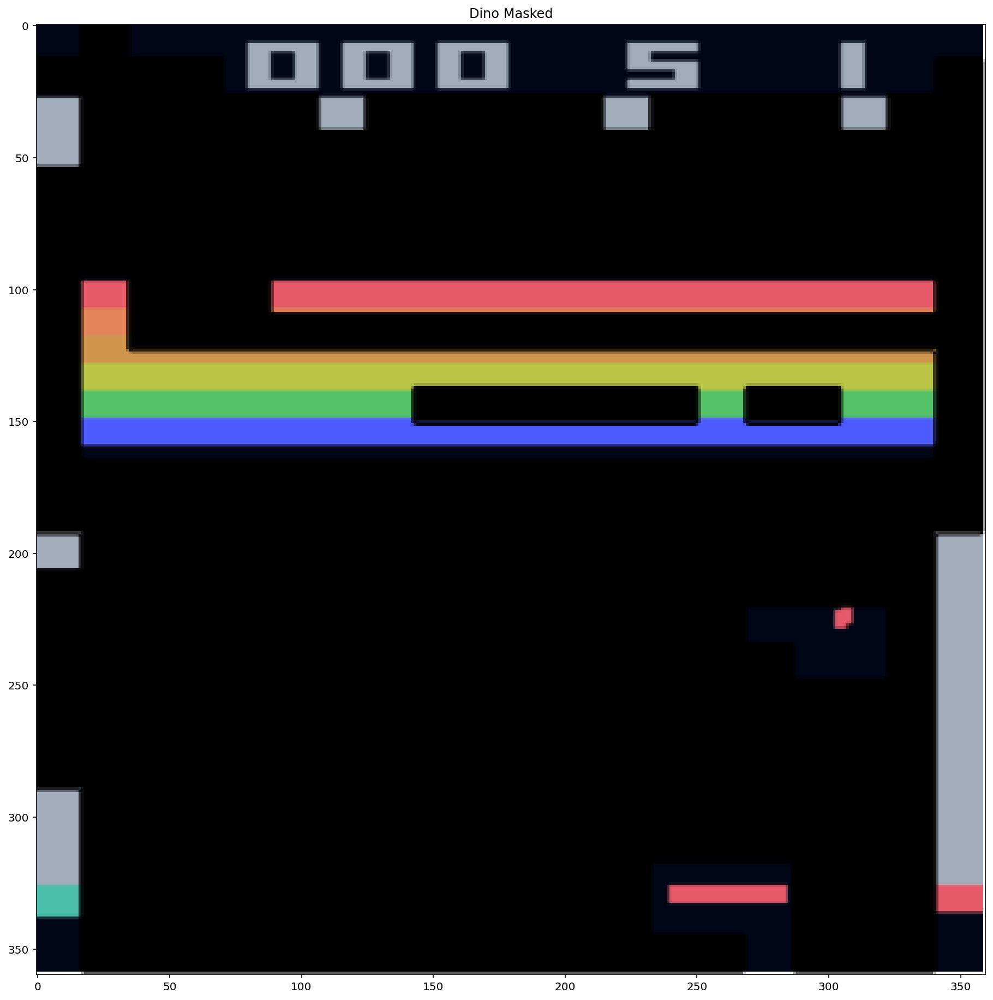

<Figure size 432x288 with 0 Axes>

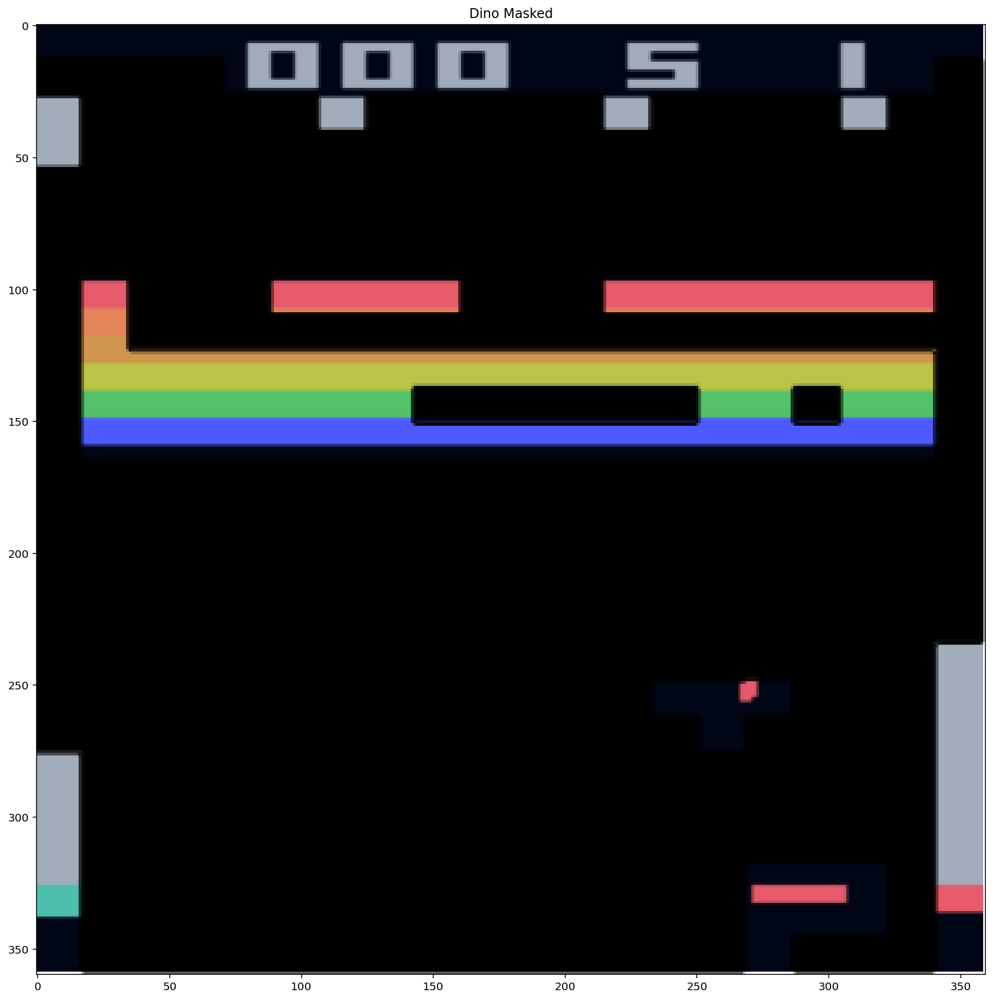

<Figure size 432x288 with 0 Axes>

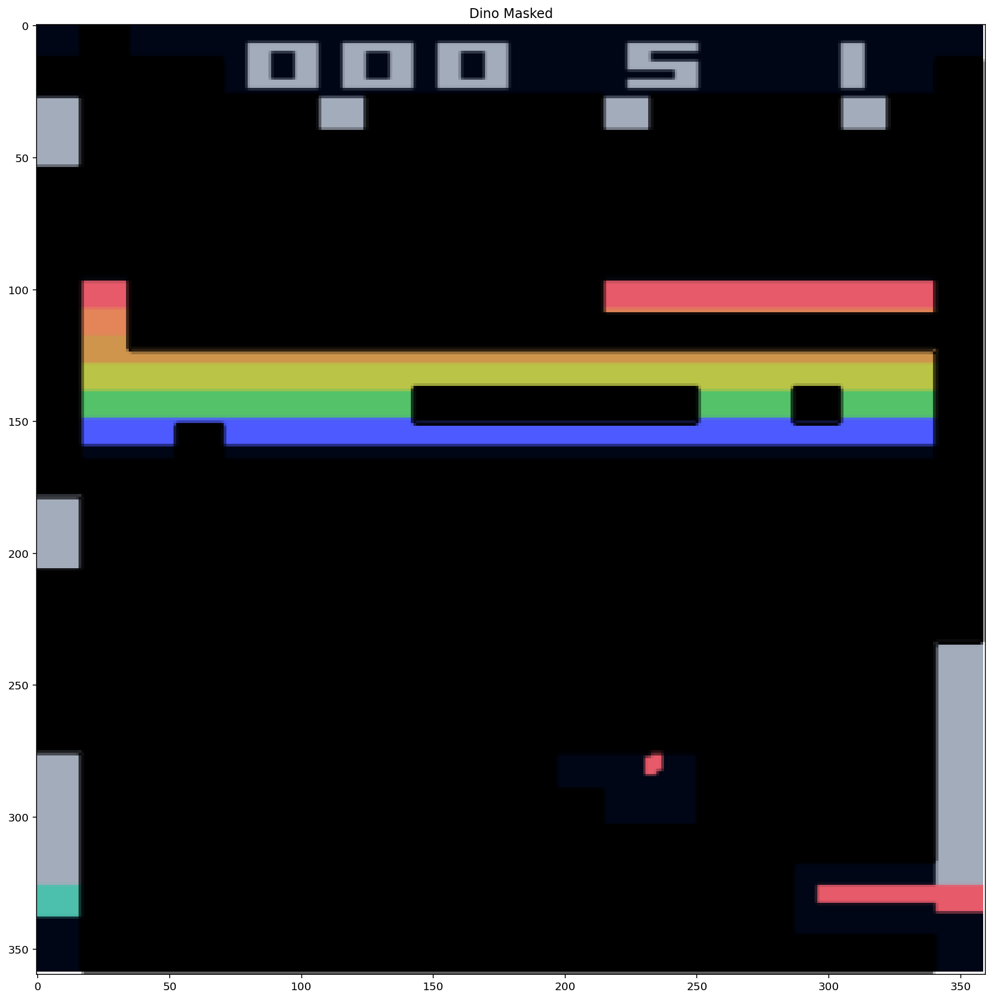

<Figure size 432x288 with 0 Axes>

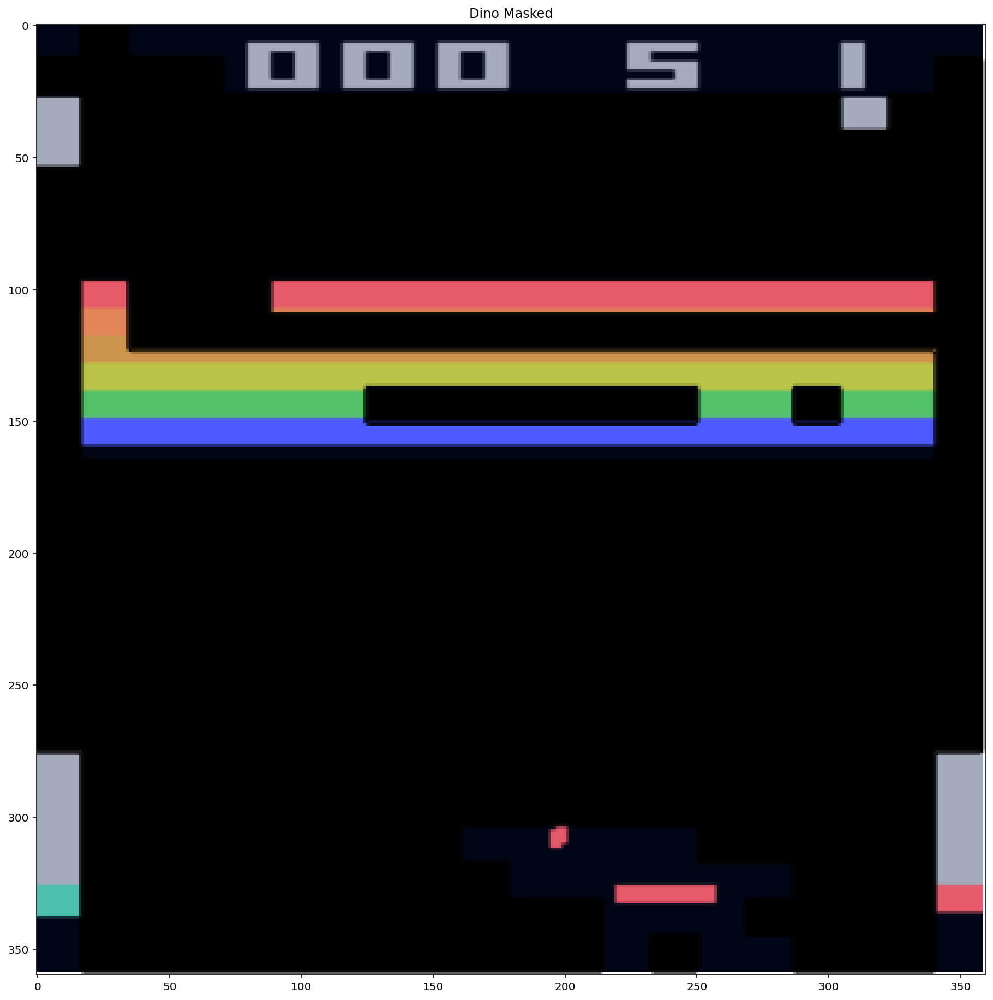

<Figure size 432x288 with 0 Axes>

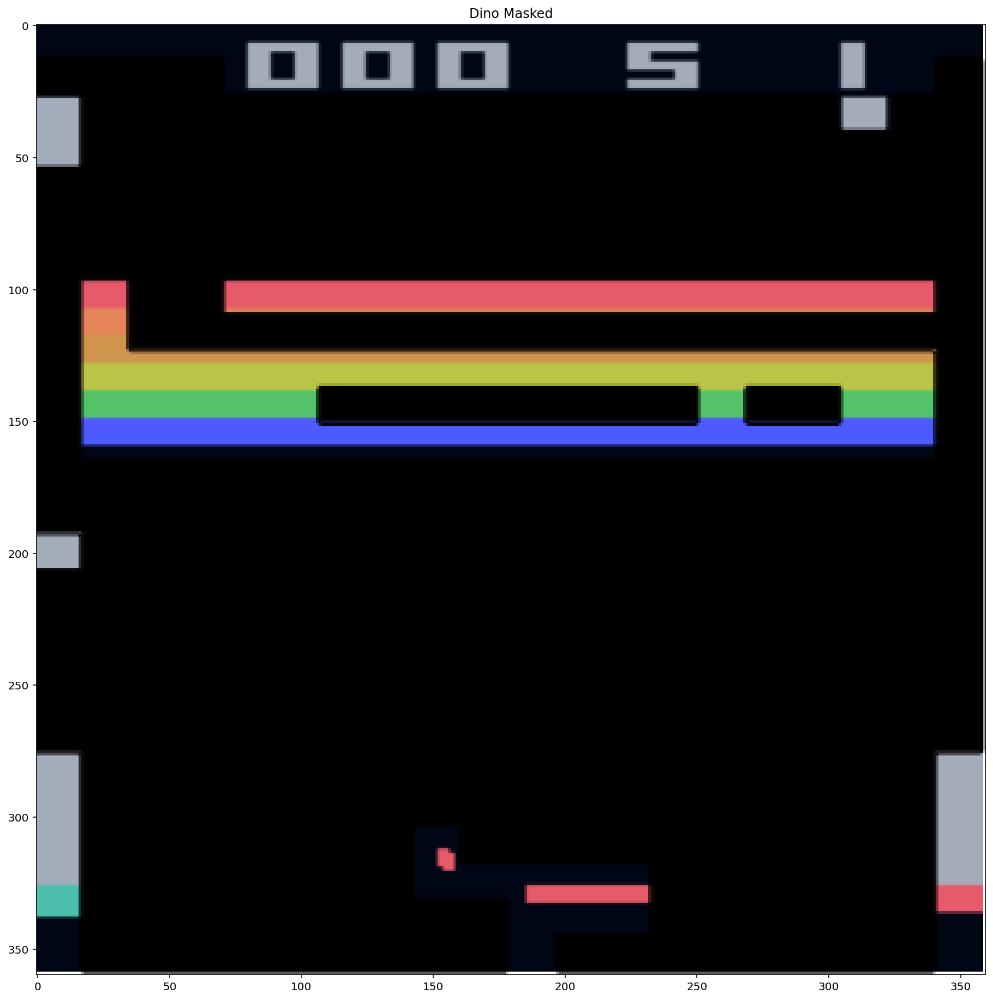

<Figure size 432x288 with 0 Axes>

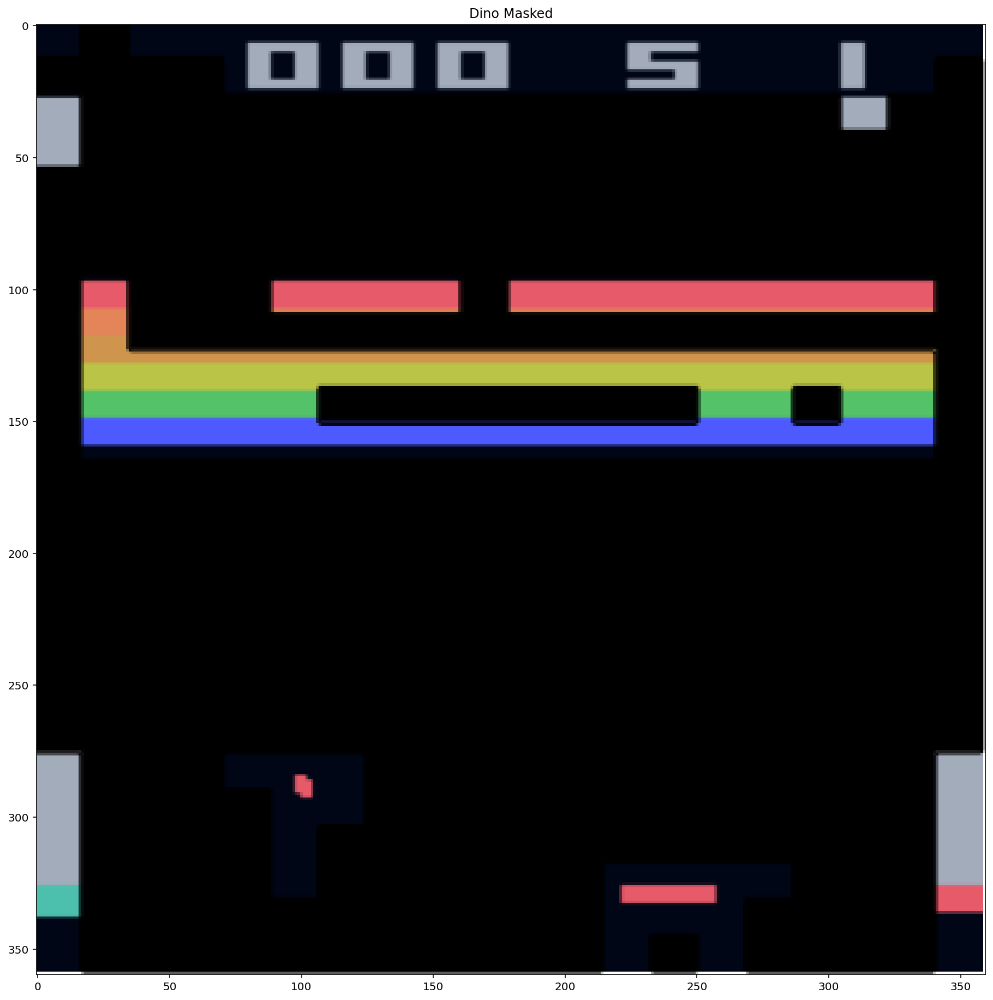

<Figure size 432x288 with 0 Axes>

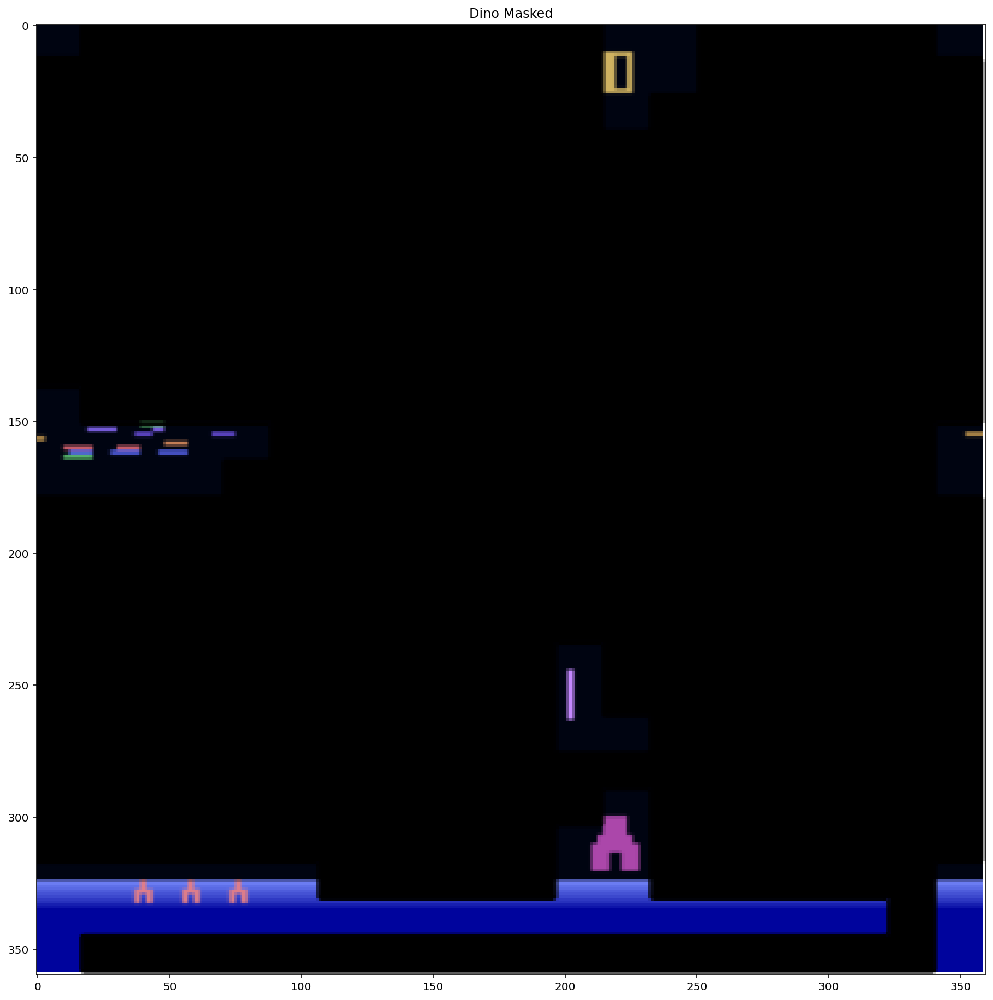

<Figure size 432x288 with 0 Axes>

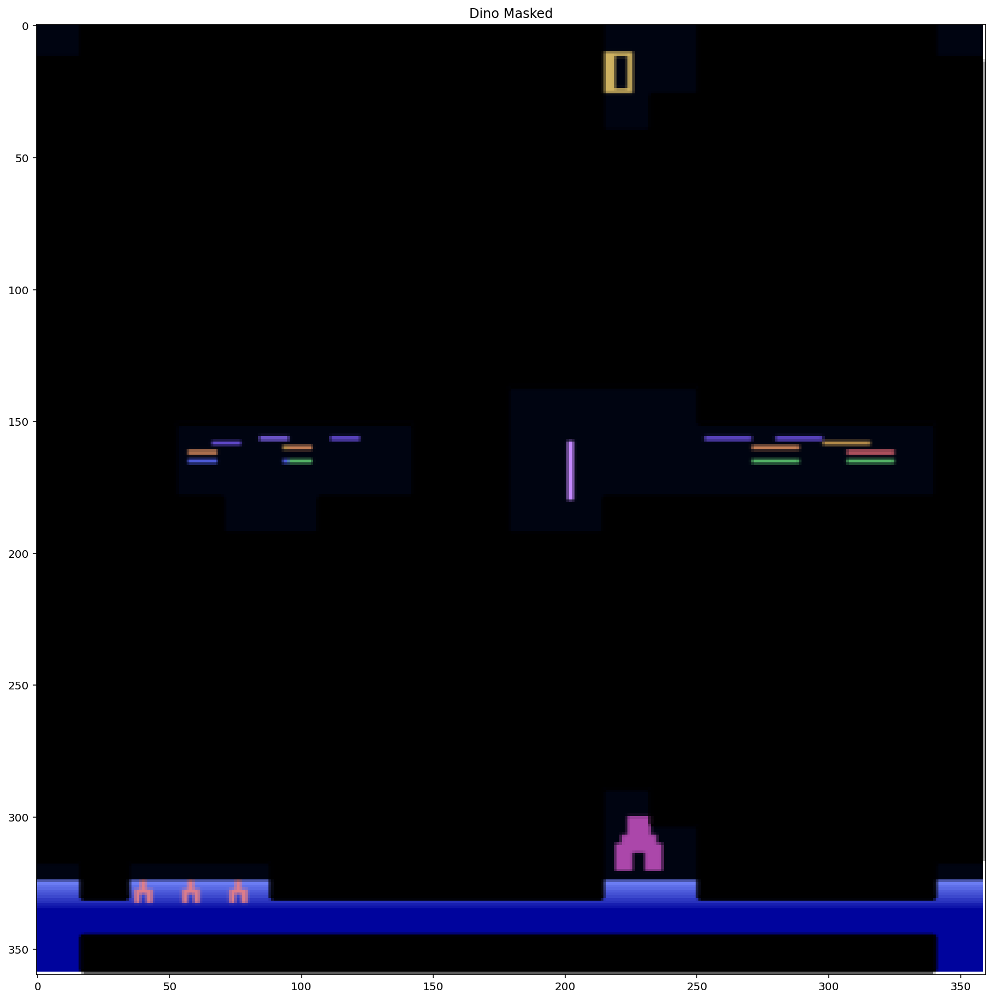

<Figure size 432x288 with 0 Axes>

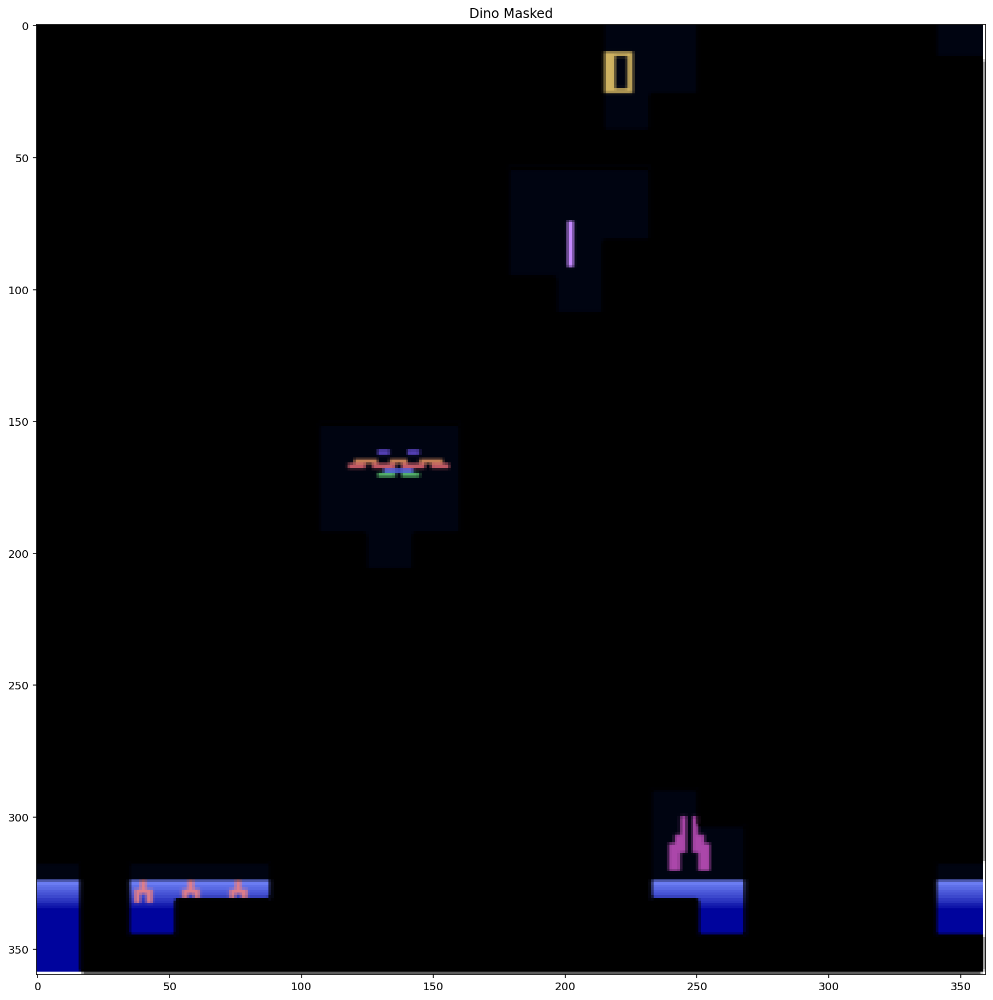

<Figure size 432x288 with 0 Axes>

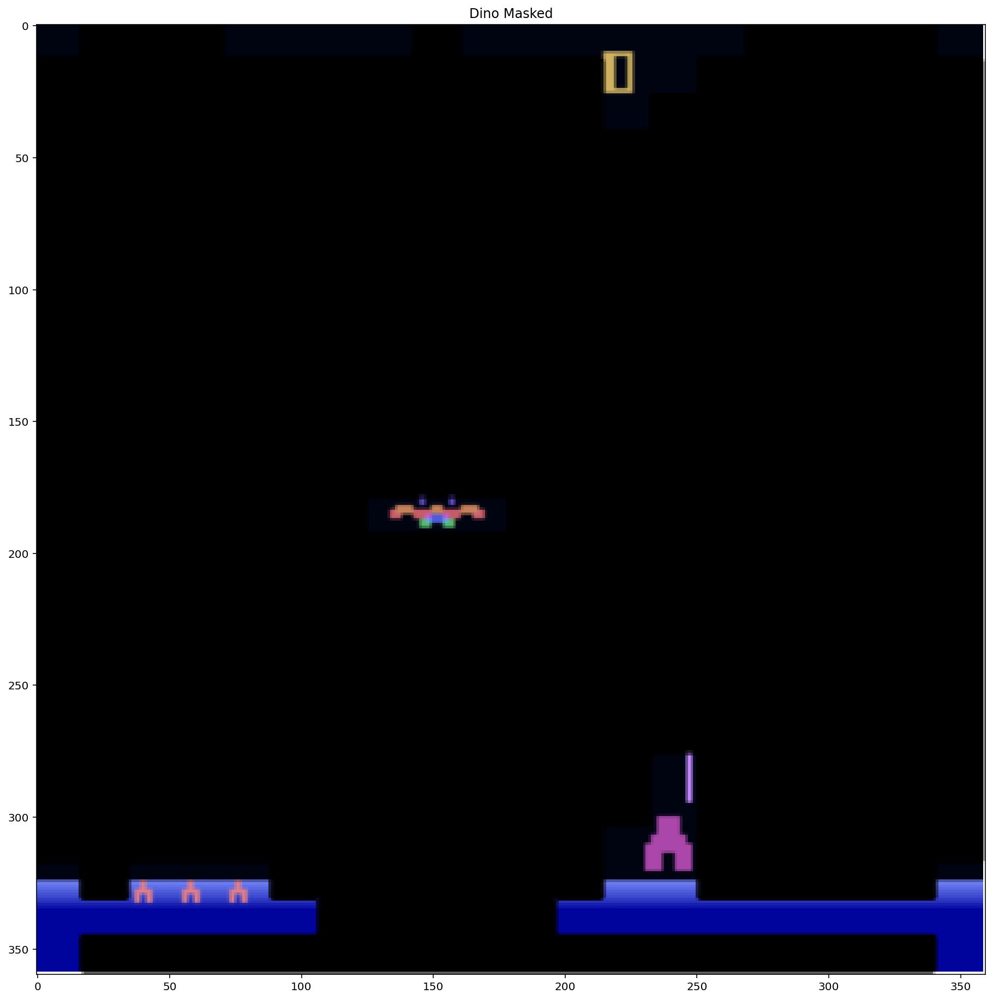

<Figure size 432x288 with 0 Axes>

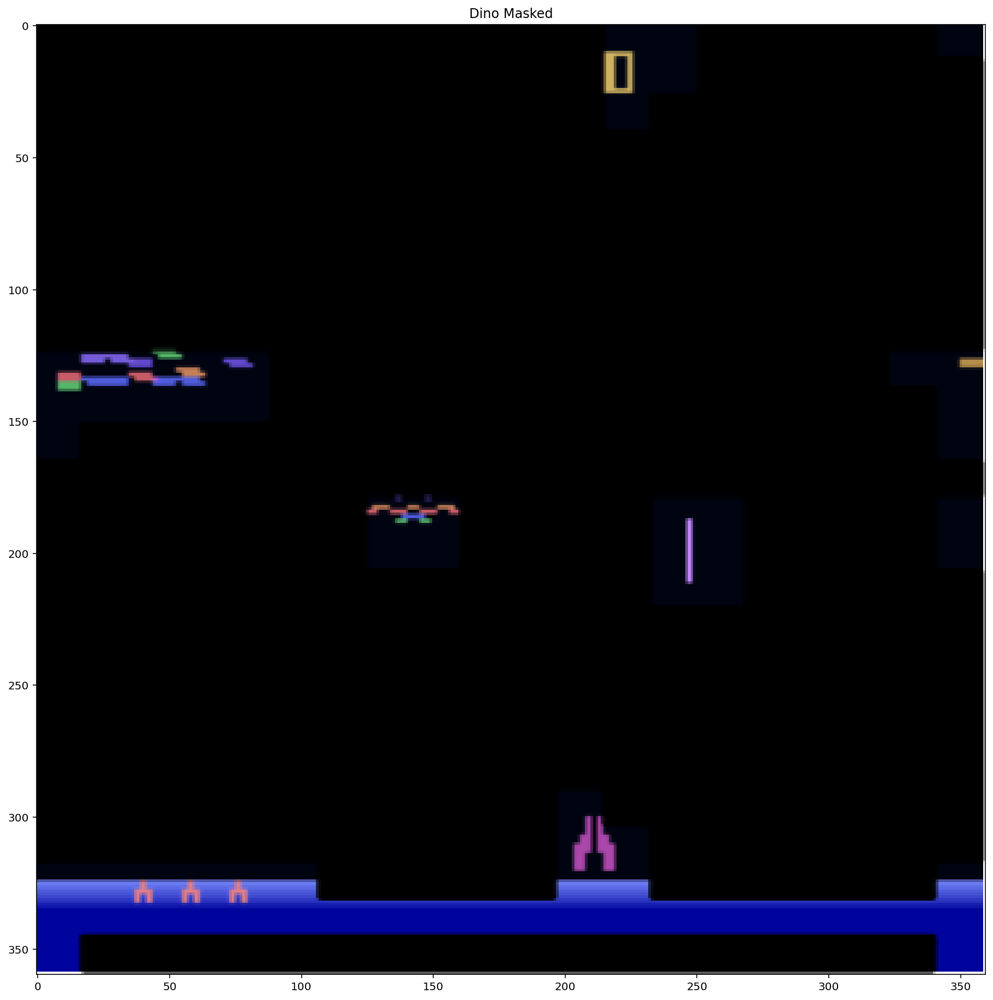

<Figure size 432x288 with 0 Axes>

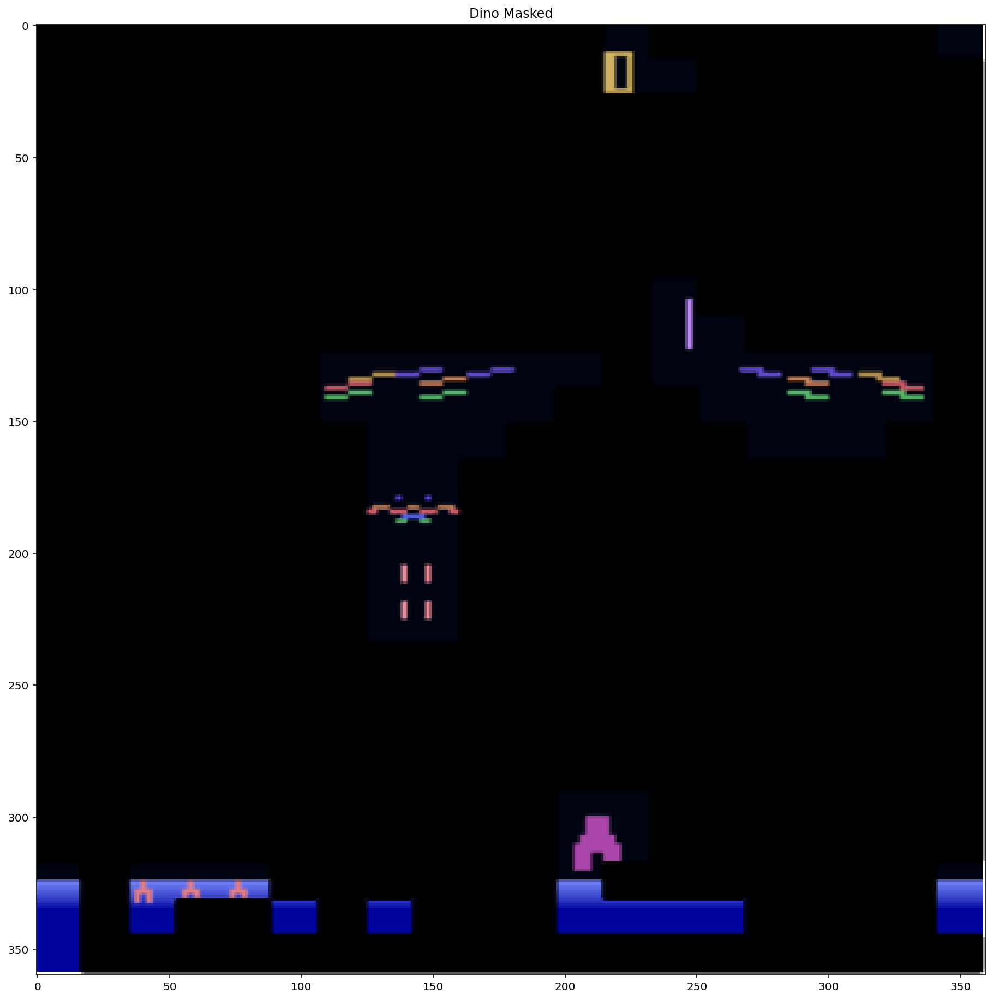

<Figure size 432x288 with 0 Axes>

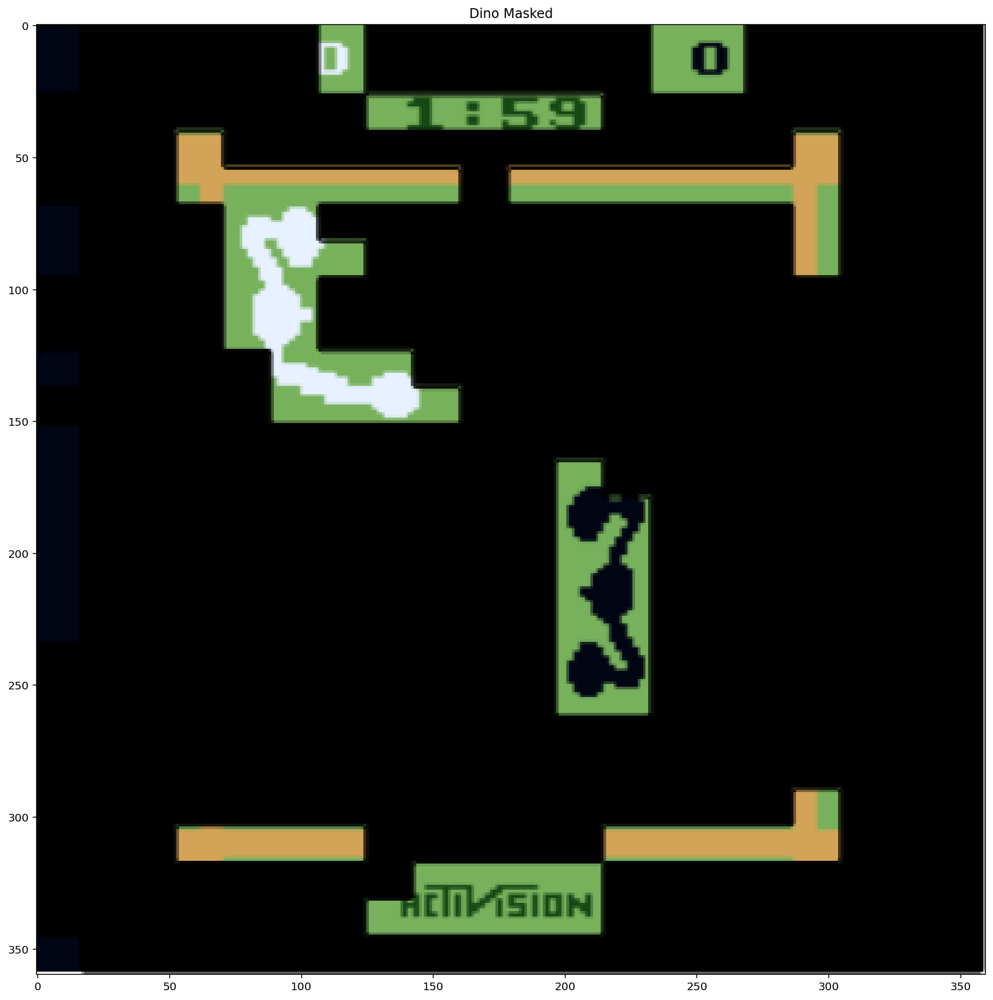

<Figure size 432x288 with 0 Axes>

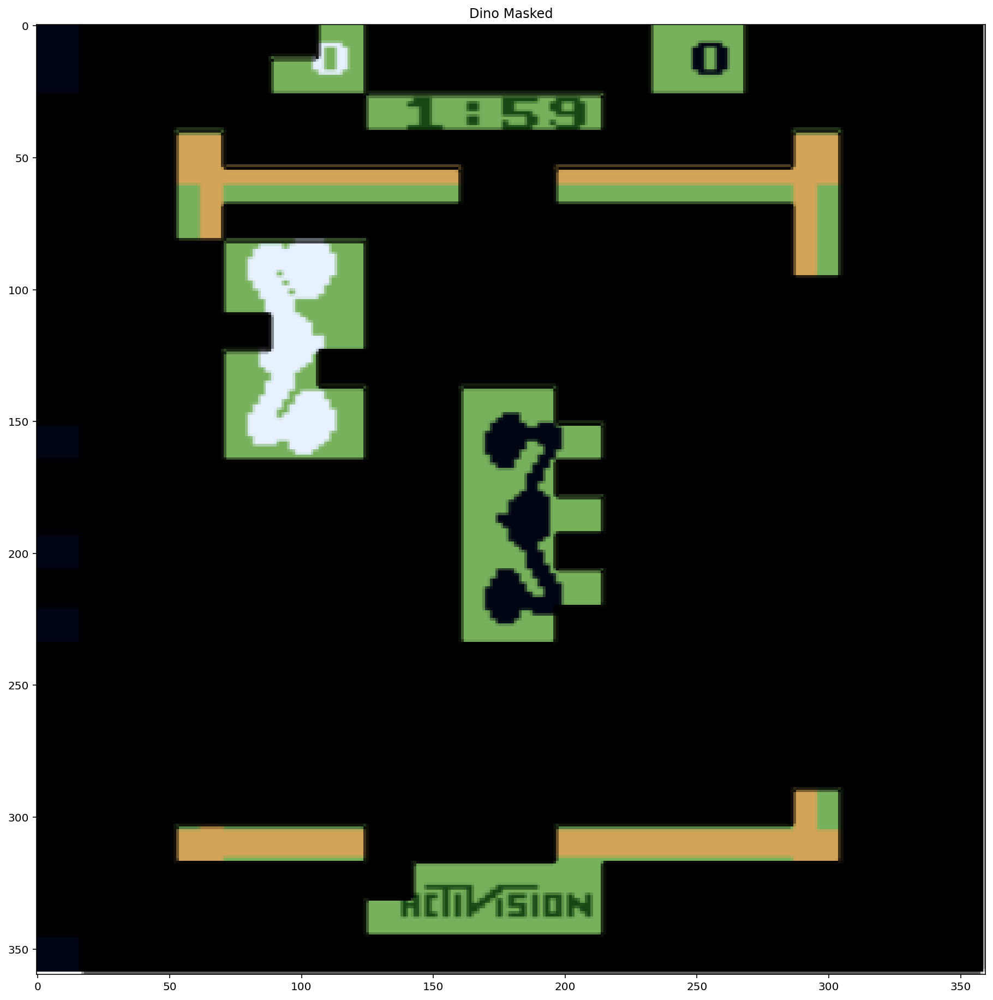

<Figure size 432x288 with 0 Axes>

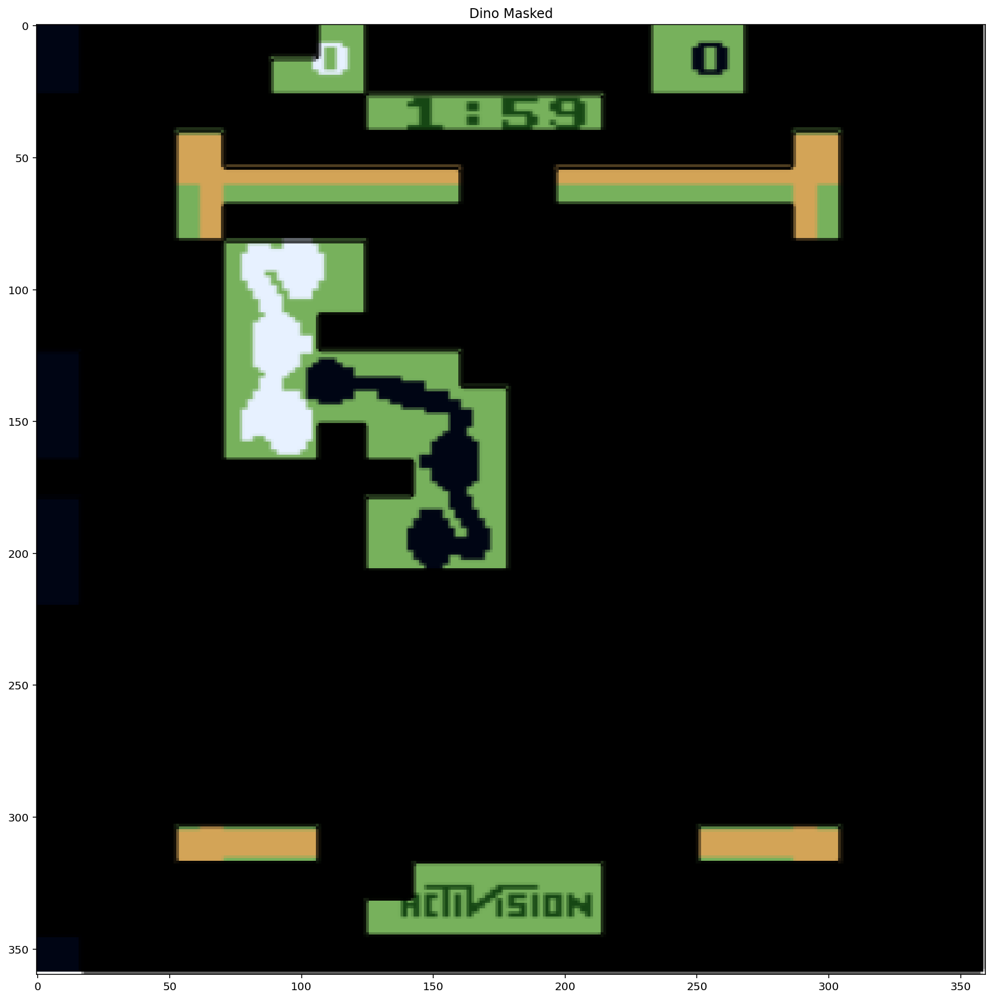

<Figure size 432x288 with 0 Axes>

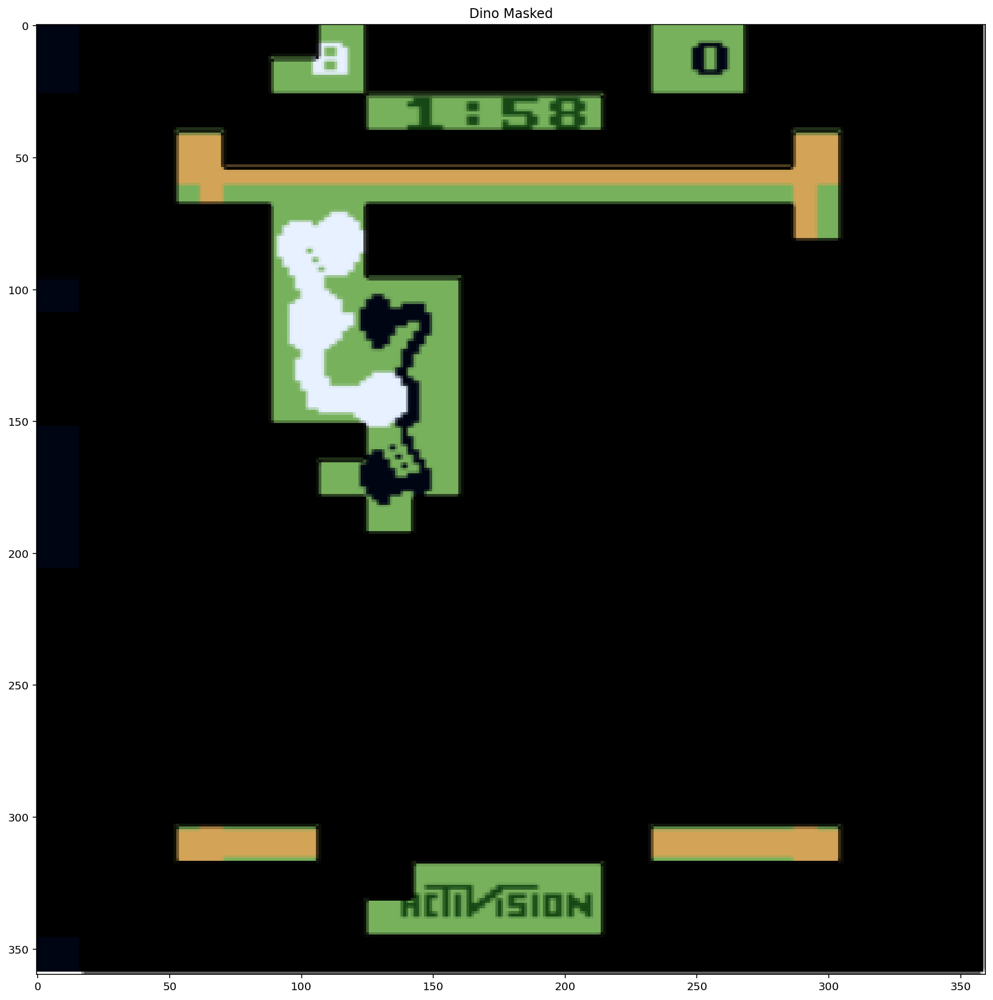

<Figure size 432x288 with 0 Axes>

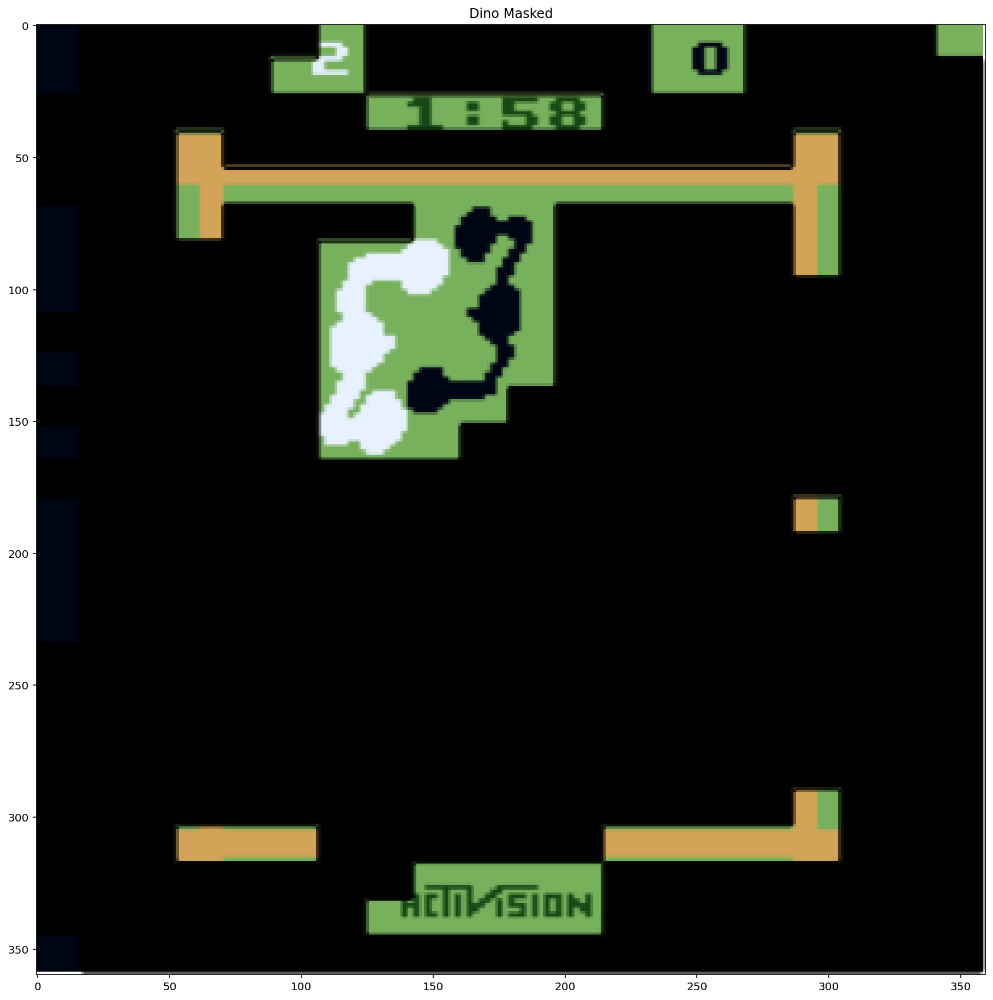

<Figure size 432x288 with 0 Axes>

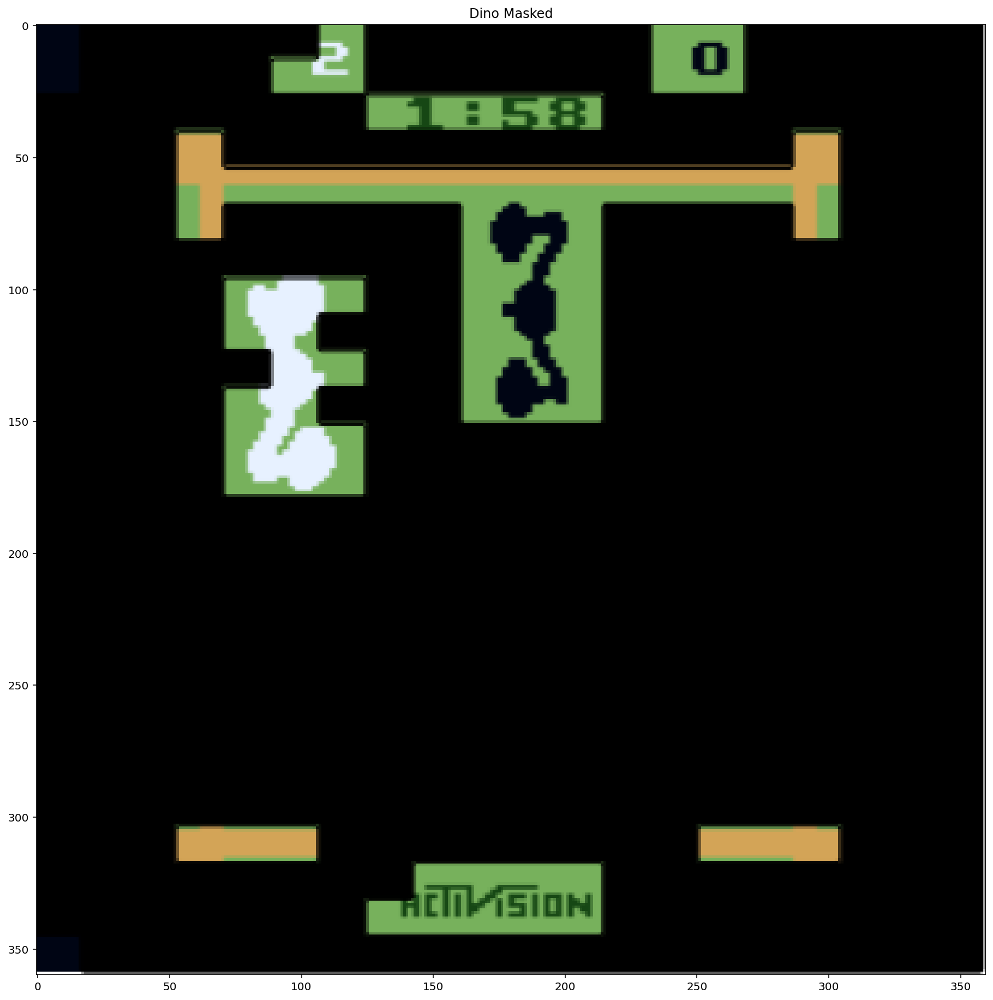

In [ ]:
for game_img in all_games:
  for ind_game_img in game_img:
    plot_attention_map_full_dino(ind_game_img)